# Sex Differences in Functional Gradients in HCP S1200

## Load packages

In [35]:
# General
import os
import sys
import numpy as np
import pandas as pd
import csv

# Computing
import scipy.io  # loadmat
from scipy import stats
import sklearn 
from brainstat.stats.terms import FixedEffect
from brainstat.stats.SLM import SLM

# Visualisation
import matplotlib.pyplot as plt 
import seaborn as sns
import vtk
from IPython.display import display
import matplotlib.collections as clt
import ptitprince as pt

# Neuroimaging
import nibabel
import nilearn

# Gradients
import brainspace
from brainspace.datasets import load_parcellation, load_conte69
from brainspace.plotting import plot_hemispheres
from brainspace.gradient import GradientMaps
from brainspace.utils.parcellation import map_to_labels

## Define directories

In [2]:
codedir = os.path.abspath('')  # obtain current direction from which script is runnning

datadir = '/data/p_02667/sex_diff_gradients/data/'

resdir = '/data/p_02667/sex_diff_gradients/results/hcp/'

In [3]:
path_list_fc_matrices = os.listdir(datadir+'fc_matrices/schaefer_output/mean')
path_list_fc_matrices.sort()

## Data 

### Functional connectivity matrices (parcellation scheme: Schaefer 400, 7 networks) - averaged over 4 session & z-transformed

In [4]:
# list that contains all the subject IDs of subjects with fc matrices
sub_list = []

# list that contains the fc matrices of all subjects in the form of 1 np array per subject
fc_matrices_400 = []


for e in path_list_fc_matrices:
    if '.csv' in e:  # need to do this because there is a hidden ipynb_checkpoints in the path_list_fc_matrices
        
        # add subject to the subjects' list
        sub_list.append(e.partition(".")[0])  # this partitions the subID.csv into a 3-tuple containing ('subID', '.', 'csv'), and I keep only the subID
        
        # reads csv file in the form of an array
        sub_matrix = np.genfromtxt(datadir+'/fc_matrices/schaefer_output/mean/'+e, delimiter=',')

        # add subject's matrix to the fc_matrices_400 list
        fc_matrices_400.append(sub_matrix)
        
print(f'Sample with FC matrices for all 4 sessions: N = {len(sub_list)}')

Sample with FC matrices for all 4 sessions: N = 1014


### Descriptive

#### Load data

In [70]:
restricted_data = pd.read_csv(datadir+'RESTRICTED_wanb_9_29_2020_2_14_36.csv')  # contains ACTUAL age, race, ethnicity, handedness, income, education, menstrual cycle info
print(f'Sample with FC matrices for all 4 sessions: N = {len(restricted_data)}')
#restricted_data.keys()

Sample with FC matrices for all 4 sessions: N = 1206


In [71]:
for i in restricted_data.keys():
    print(i)

Subject
Age_in_Yrs
HasGT
ZygositySR
ZygosityGT
Family_ID
Mother_ID
Father_ID
TestRetestInterval
Race
Ethnicity
Handedness
SSAGA_Employ
SSAGA_Income
SSAGA_Educ
SSAGA_InSchool
SSAGA_Rlshp
SSAGA_MOBorn
Height
Weight
BMI
SSAGA_BMICat
SSAGA_BMICatHeaviest
Blood_Drawn
Hematocrit_1
Hematocrit_2
BPSystolic
BPDiastolic
ThyroidHormone
HbA1C
Hypothyroidism
Hypothyroidism_Onset
Hyperthyroidism
Hyperthyroidism_Onset
OtherEndocrn_Prob
OtherEndocrine_ProbOnset
Menstrual_RegCycles
Menstrual_Explain
Menstrual_AgeBegan
Menstrual_CycleLength
Menstrual_DaysSinceLast
Menstrual_AgeIrreg
Menstrual_AgeStop
Menstrual_MonthsSinceStop
Menstrual_UsingBirthControl
Menstrual_BirthControlCode
FamHist_Moth_Scz
FamHist_Fath_Scz
FamHist_Moth_Dep
FamHist_Fath_Dep
FamHist_Moth_BP
FamHist_Fath_BP
FamHist_Moth_Anx
FamHist_Fath_Anx
FamHist_Moth_DrgAlc
FamHist_Fath_DrgAlc
FamHist_Moth_Alz
FamHist_Fath_Alz
FamHist_Moth_PD
FamHist_Fath_PD
FamHist_Moth_TS
FamHist_Fath_TS
FamHist_Moth_None
FamHist_Fath_None
ASR_Anxd_Raw
ASR_Anxd

In [72]:
unrestricted_data = pd.read_csv(datadir+'unrestricted_wanb_9_14_2020_7_53_51.csv')  # sex ('gender'), BINNED age (in 5-year increments, 22-25, 26-30, 31-35, 35+), ICV ('FS_IntraCranial_Vol')
print(f'Sample with FC matrices for all 4 sessions: N = {len(unrestricted_data)}')
#unrestricted_data.keys

Sample with FC matrices for all 4 sessions: N = 1206


In [73]:
for i in unrestricted_data.keys():
    print(i)

Subject
Release
Acquisition
Gender
Age
3T_Full_MR_Compl
T1_Count
T2_Count
3T_RS-fMRI_Count
3T_RS-fMRI_PctCompl
3T_Full_Task_fMRI
3T_tMRI_PctCompl
fMRI_WM_PctCompl
fMRI_Gamb_PctCompl
fMRI_Mot_PctCompl
fMRI_Lang_PctCompl
fMRI_Soc_PctCompl
fMRI_Rel_PctCompl
fMRI_Emo_PctCompl
3T_dMRI_Compl
3T_dMRI_PctCompl
dMRI_3T_ReconVrs
fMRI_3T_ReconVrs
7T_Full_MR_Compl
7T_RS-fMRI_Count
7T_RS-fMRI_PctCompl
7T_Full_Task_fMRI
7T_tMRI_PctCompl
fMRI_Movie_Compl
fMRI_Movie_PctCompl
fMRI_Ret_Compl
fMRI_Ret_PctCompl
7T_dMRI_Compl
7T_dMRI_PctCompl
7T_fMRI_Mov_Vrs
MEG_AnyData
MEG_FullProt_Compl
MEG_HeadModel_Avail
MEG_CortRibn_Avail
MEG_Anatomy_Avail
MEG_Anatomy_Compl
MEG_Noise_Avail
MEG_Noise_Compl
MEG_RS_Avail
MEG_RS_Compl
MEG_WM_Avail
MEG_WM_Compl
MEG_StoryMath_Avail
MEG_StoryMath_Compl
MEG_Motor_Avail
MEG_Motor_Compl
Non-TB_Compl
VisProc_Compl
DelDisc_Compl
SCPT_Compl
IWRD_Compl
PMAT_Compl
VSPLOT_Compl
EmoRecog_Compl
NEO-FFI_Compl
ASR-Syn_Compl
ASR-DSM_Compl
Toolbox_Compl
MMSE_Compl
PSQI_Compl
Alert_Compl
AS

#### Making "cleaned" versions of the dataframes which only contain subjects who also have fc matrices

In [74]:
## restricted data

# set index as subject in order to drop subject rows by calling on subject ID
restricted_data_cleaned = restricted_data.set_index('Subject')

for subID in restricted_data.loc[:,'Subject']:
    if str(subID) not in sub_list:
        restricted_data_cleaned = restricted_data_cleaned.drop(subID)
        
        
## unrestricted data

# set index as subject in order to drop subject rows by calling on subject ID
unrestricted_data_cleaned = unrestricted_data.set_index('Subject')

for subID in unrestricted_data.loc[:,'Subject']:
    if str(subID) not in sub_list:
        unrestricted_data_cleaned = unrestricted_data_cleaned.drop(subID)
        
        

# Relabeling Gender: Females = 0; Males = 1        
#unrestricted_data_cleaned.loc[unrestricted_data_cleaned["Gender"] == "F", "Gender"] = 0
#unrestricted_data_cleaned.loc[unrestricted_data_cleaned["Gender"] == "M", "Gender"] = 1

Creating a new categorical variable for age containing 2-year bins

In [75]:
# create a list of our conditions
conditions = [
    (restricted_data_cleaned['Age_in_Yrs'] >= 22) & (restricted_data_cleaned['Age_in_Yrs'] <= 24),
    (restricted_data_cleaned['Age_in_Yrs'] >= 25) & (restricted_data_cleaned['Age_in_Yrs'] <= 27),
    (restricted_data_cleaned['Age_in_Yrs'] >= 28) & (restricted_data_cleaned['Age_in_Yrs'] <= 30),
    (restricted_data_cleaned['Age_in_Yrs'] >= 31) & (restricted_data_cleaned['Age_in_Yrs'] <= 33),
    (restricted_data_cleaned['Age_in_Yrs'] >= 34) & (restricted_data_cleaned['Age_in_Yrs'] <= 37),
    ]

# create a list of the values we want to assign for each condition
# creating 2-year age bins: 22-24 (1), 25-27 (2), 28-30 (3), 31-33 (4), 34-37 (5)
values = [1, 2, 3, 4, 5]

# create a new column and use np.select to assign values to it using our lists as arguments
restricted_data_cleaned['age_2y_bins'] = np.select(conditions, values)

#### Creating a merged demographic dataframe (from restricted and unrestricted data)

In [76]:
# merge based on index of both left dataset (unrestricted) and right dataset (restricted)
merged_demographics_cleaned = pd.merge(unrestricted_data_cleaned, restricted_data_cleaned, left_index=True, right_index=True)

# Export as csv merged dataframe of demographic data cleaned (for R analyses)
merged_demographics_cleaned.to_csv('merged_demographics_cleaned.csv', header = True, index = False)

In [77]:
print(f"N = {len(merged_demographics_cleaned)}\n"
      f"{np.sum(merged_demographics_cleaned.Gender == 'F')} females, {np.sum(merged_demographics_cleaned.Gender == 'M')} males\n"
      f"Mean subject age: {np.mean(merged_demographics_cleaned.Age_in_Yrs):.2f}, SD: {np.std(merged_demographics_cleaned.Age_in_Yrs):.2f}, range: {np.min(merged_demographics_cleaned.Age_in_Yrs):.2f} - {np.max(merged_demographics_cleaned.Age_in_Yrs):.2f}\n"
      f"Mean ICV: {np.mean(merged_demographics_cleaned.FS_IntraCranial_Vol):.2f}, SD: {np.std(merged_demographics_cleaned.FS_IntraCranial_Vol):.2f}, range: {np.min(merged_demographics_cleaned.FS_IntraCranial_Vol):.2f} - {np.max(merged_demographics_cleaned.FS_IntraCranial_Vol):.2f}"

      # commenting this out because not really indicative given all the missing twin matches + wrote a much more detailed code below for zygosity*sex counts 
      # ******** in case I want to uncomment the lines below, need to run the code creating a Zygosity column in merged_demographics_cleaned first (code is in section Heritability Analyses) ********
      #f"\n\nZygosity:\n- Not twin: {np.sum(merged_demographics_cleaned.Zygosity == 'NotTwin')} ({np.sum((merged_demographics_cleaned.Zygosity == 'NotTwin') & (merged_demographics_cleaned.Gender == 'F'))} F, {np.sum((merged_demographics_cleaned.Zygosity == 'NotTwin') & (merged_demographics_cleaned.Gender == 'M'))} M)\n"
      #f"- DZ: {np.sum(merged_demographics_cleaned.Zygosity == 'DZ')} ({np.sum((merged_demographics_cleaned.Zygosity == 'DZ') & (merged_demographics_cleaned.Gender == 'F'))} F, {np.sum((merged_demographics_cleaned.Zygosity == 'DZ') & (merged_demographics_cleaned.Gender == 'M'))} M)\n"
      #f"- MZ: {np.sum(merged_demographics_cleaned.Zygosity == 'MZ')} ({np.sum((merged_demographics_cleaned.Zygosity == 'MZ') & (merged_demographics_cleaned.Gender == 'F'))} F, {np.sum((merged_demographics_cleaned.Zygosity == 'MZ') & (merged_demographics_cleaned.Gender == 'M'))} M)\n"
      #f"- N/A: {np.sum(merged_demographics_cleaned.Zygosity == 'N/A')} ({np.sum((merged_demographics_cleaned.Zygosity == 'N/A') & (merged_demographics_cleaned.Gender == 'F'))} F, {np.sum((merged_demographics_cleaned.Zygosity == 'N/A') & (merged_demographics_cleaned.Gender == 'M'))} M)"
     )

N = 1014
544 females, 470 males
Mean subject age: 28.74, SD: 3.71, range: 22.00 - 37.00
Mean ICV: 1583398.49, SD: 186723.28, range: 831208.30 - 2143193.92


#### Testing differences in age between the sexes (given that I will test sex differences without matching for age)

In [78]:
# Levene's test for equality of variances -> non-significant differences means equality, can contiunue with parametric independent samples t-test
stats.levene(merged_demographics_cleaned.Age_in_Yrs[merged_demographics_cleaned.Gender == 'M'], merged_demographics_cleaned.Age_in_Yrs[merged_demographics_cleaned.Gender == 'F'])

LeveneResult(statistic=0.14932057395328685, pvalue=0.6992667192352071)

In [79]:
stats.ttest_ind(merged_demographics_cleaned.Age_in_Yrs[merged_demographics_cleaned.Gender == 'M'], merged_demographics_cleaned.Age_in_Yrs[merged_demographics_cleaned.Gender == 'F'])

Ttest_indResult(statistic=-7.069267321913692, pvalue=2.899004078650321e-12)

Text(0, 0.5, 'Frequency')

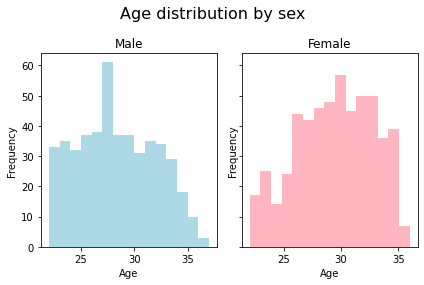

In [80]:
fig, axs = plt.subplots(1, 2, sharey=True, tight_layout=True)

fig.suptitle('Age distribution by sex', fontsize=16)

axs[0].hist(merged_demographics_cleaned.Age_in_Yrs[merged_demographics_cleaned.Gender == 'M'], bins=15, color = 'lightblue')
axs[0].set_title('Male')
axs[0].set_xlabel('Age')
axs[0].set_ylabel('Frequency')

axs[1].hist(merged_demographics_cleaned.Age_in_Yrs[merged_demographics_cleaned.Gender == 'F'], bins=15, color = 'lightpink')
axs[1].set_title('Female')
axs[1].set_xlabel('Age')
axs[1].set_ylabel('Frequency')

## Constructing gradients

### Mean gradients

*Needed for alignment*

#### Calculate the mean matrix

In [81]:
mean_fc_matrix = sum(fc_matrices_400)/len(fc_matrices_400)

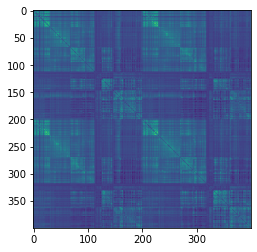

(400, 400)

In [82]:
plt.imshow(mean_fc_matrix)
plt.show()
mean_fc_matrix.shape

In [83]:
mean_fc_matrix

array([[0.        , 0.2498126 , 0.37271328, ..., 0.04238886, 0.08499603,
        0.1593685 ],
       [0.2498126 , 0.        , 0.18806447, ..., 0.05010702, 0.12138304,
        0.21793825],
       [0.37271328, 0.18806447, 0.        , ..., 0.08140168, 0.10591643,
        0.20802816],
       ...,
       [0.04238886, 0.05010702, 0.08140168, ..., 0.        , 0.29131347,
        0.18403434],
       [0.08499603, 0.12138304, 0.10591643, ..., 0.29131347, 0.        ,
        0.3497333 ],
       [0.1593685 , 0.21793825, 0.20802816, ..., 0.18403434, 0.3497333 ,
        0.        ]])

- **IT WOULD BE NICE TO PLOT WITH LABELS AS DONE IN TUTORIAL from brainspace.utils.parcellation import reduce_by_labels?**

#### Construct mean gradients 
(i.e., gradients for the mean matrix)

In [84]:
# GradientMaps function used to build the model parameters
mean_grad = GradientMaps(n_components = 10, random_state = 0, approach = 'dm', kernel = 'normalized_angle')

# fit function used to compute the gradients
mean_grad.fit(mean_fc_matrix)

GradientMaps(kernel='normalized_angle', random_state=0)

Plot 3 first gradients of the mean matrix

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


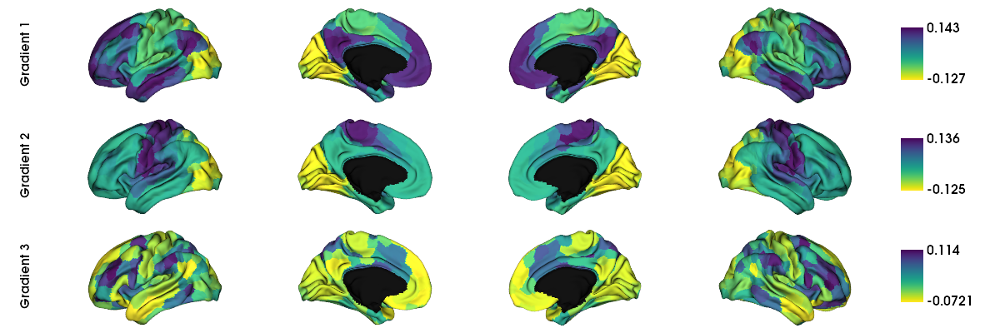

In [85]:
# defining labeling scheme and mask
labeling = load_parcellation('schaefer', scale=400, join=True)
surf_lh, surf_rh = load_conte69()

mask = labeling != 0


# list containing placeholders (None) for the number of gradients I want to plot
grad = [None] * 3

for i in range(3):
    # map the gradient to the parcels
    grad[i] = map_to_labels(mean_grad.gradients_[:, i], labeling, mask=mask, fill=np.nan)  # mean_grad contains 10 .gradients_ (1 gradient per column) - here I take all rows and individual select column based on gradient I want (first 3)

plot_hemispheres(surf_lh, surf_rh, array_name=grad, embed_nb = True, size=(1200, 400), cmap='viridis_r', color_bar=True, label_text=['Gradient 1', 'Gradient 2', 'Gradient 3'], zoom=1.55)

Variance explained by the 10 gradients

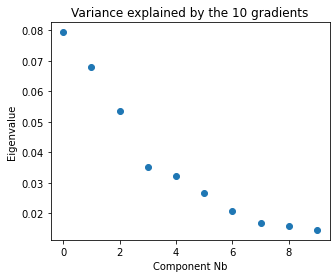

In [86]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(range(mean_grad.lambdas_.size), mean_grad.lambdas_)
ax.set_title("Variance explained by the 10 gradients")
ax.set_xlabel('Component Nb')
ax.set_ylabel('Eigenvalue')

plt.show()

In [87]:
# Scaled variance explained by individual gradients: lambda / total(i.e., sum lambdas) * 100 %
print(f"Total amount of variance explained by the {len(mean_grad.lambdas_)} gradients (uncorrected sum lambdas): {sum(mean_grad.lambdas_):.2f}\n")
print(f"Scaled variance explained by individual gradients:\nG1: {mean_grad.lambdas_[0]/sum(mean_grad.lambdas_)*100:.2f}%\nG2: {mean_grad.lambdas_[1]/sum(mean_grad.lambdas_)*100:.2f}%\nG3: {mean_grad.lambdas_[2]/sum(mean_grad.lambdas_)*100:.2f}%\n")

Total amount of variance explained by the 10 gradients (uncorrected sum lambdas): 0.36

Scaled variance explained by individual gradients:
G1: 21.85%
G2: 18.71%
G3: 14.74%



Scatterplot of the first two gradients, colorcoding displays 3rd gradient (but categorical so not good)

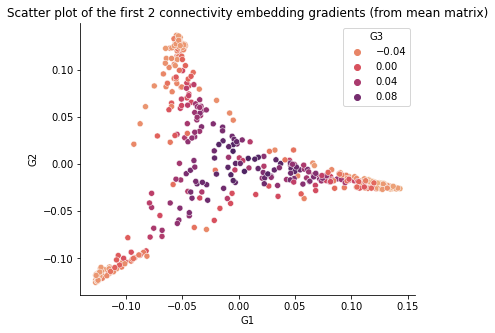

In [88]:
fig, ax = plt.subplots(figsize=(6,5));
ax = sns.scatterplot(x=mean_grad.gradients_[:,0],  # all rows (400 parces), first column (G1)
                     y=mean_grad.gradients_[:,1],  # all rows (400 parces), second column (G2)
                     hue=mean_grad.gradients_[:,2],  # gives color coding based on all rows (400 parces), third column (G3)
                     palette=sns.color_palette("flare", as_cmap=True), 
                     legend=True, ax=ax);
ax.set_xlabel('G1');
ax.set_ylabel('G2');
ax.set_title("Scatter plot of the first 2 connectivity embedding gradients (from mean matrix)")
ax.spines['right'].set_visible(False);
ax.spines['top'].set_visible(False);
plt.legend(title='G3')
plt.show(ax)

### Aligned gradients

Construct gradients for all subjects (procrustes alignment to the overall mean matrix)

In [89]:
list_aligned_gradients = []  # will contain all participants (1014), all parcels (400), all gradients (10)
list_aligned_G1 = []  # will contain all participants (1014), all parcels (400) -> values = eigenvalues for GRADIENT 1
list_aligned_G2 = []  # will contain all participants (1014), all parcels (400) -> values = eigenvalues for GRADIENT 2
list_aligned_G3 = []  # will contain all participants (1014), all parcels (400) -> values = eigenvalues for GRADIENT 3
  
# loop over all the fc matrices
for i in range(len(fc_matrices_400)):
    # setting model parameters for gradients to be computed across subjects - with procrustes alignment
    grad_procr = GradientMaps(n_components=10, random_state=0, approach='dm', kernel='normalized_angle', alignment='procrustes')  # specify alignment method here (procrustes)

    # computing
    # note that by using an alignment method, .fit yields a variable (grad_procr) containing both types of gradients, callable with: .gradients_ (original) and .aligned_ (aligned - use this for analyses)
    grad_procr.fit(fc_matrices_400[i], reference=mean_grad.gradients_)  # align to the gradients of the gradients produced by the mean matrix (reference) 

    # append array to lists results (.T is necessary in order to be able to first access the gradients layer (10) so that can index the desired gradient, which will then contain all the parcels (400)
    list_aligned_gradients.append(grad_procr.aligned_)
    list_aligned_G1.append(grad_procr.aligned_.T[0])
    list_aligned_G2.append(grad_procr.aligned_.T[1])
    list_aligned_G3.append(grad_procr.aligned_.T[2])
    
# make gradient lists into arrays (for analyses)    
array_aligned_gradients = np.array(list_aligned_gradients)
array_aligned_G1 = np.array(list_aligned_G1)
array_aligned_G2 = np.array(list_aligned_G2)
array_aligned_G3 = np.array(list_aligned_G3)

In [90]:
array_aligned_G1[1]

array([-0.07251558,  0.07065467, -0.12178471, -0.12622814, -0.13144795,
       -0.10387219, -0.01902851, -0.11756534, -0.12194011, -0.13356942,
       -0.12436505, -0.00855267, -0.05217543, -0.07584176, -0.04953659,
       -0.10264264, -0.11930329, -0.10858747, -0.03684319,  0.12517311,
       -0.11421728, -0.12456373, -0.11961431, -0.13139621, -0.12769224,
       -0.13251884, -0.13208392, -0.04879346, -0.13347671, -0.13073357,
       -0.10171459, -0.06655522, -0.0864332 , -0.04576794, -0.0483859 ,
       -0.08214812, -0.07431563, -0.07204479, -0.06511408, -0.06271801,
       -0.07074316, -0.06975001, -0.05703471, -0.05938679, -0.05064096,
       -0.06205617, -0.05378028, -0.05223395, -0.06370717, -0.09754484,
       -0.06296299, -0.05474551, -0.05350032, -0.06088758, -0.04881937,
       -0.07644988, -0.05734777, -0.05944093, -0.05111435, -0.05554536,
       -0.05663609, -0.0558831 , -0.05556508, -0.05564233, -0.05120947,
       -0.05086453, -0.051275  , -0.0524003 , -0.05782822, -0.04

In [91]:
len(array_aligned_G1[0])

400

#### Exporting Gradients to csv for R analyses

In [92]:
# fmt = decimals, header = 1 to 400 (without the first and last string letter because it's the [] of the list, comments = empty because otherwise gives a #

np.savetxt(resdir+'array_aligned_G1.csv', array_aligned_G1, delimiter=',', fmt = '%.16g', header = str(list(range(1,401)))[1:-1], comments = '')
np.savetxt(resdir+'array_aligned_G2.csv', array_aligned_G2, delimiter=',', fmt = '%.16g', header = str(list(range(1,401)))[1:-1], comments = '')
np.savetxt(resdir+'array_aligned_G3.csv', array_aligned_G3, delimiter=',', fmt = '%.16g', header = str(list(range(1,401)))[1:-1], comments = '')

### Mean gradients by sex

*Needed for plotting Males vs Females*

#### Mean matrices by sex

Creating lists containing only male and only female fc matrices

In [93]:
fc_matrices_400_M = []
fc_matrices_400_F = []

for i in range(len(fc_matrices_400)):
    if merged_demographics_cleaned.Gender.iloc[i] == "M":
        fc_matrices_400_M.append(fc_matrices_400[i])
    elif merged_demographics_cleaned.Gender.iloc[i] == "F":
        fc_matrices_400_F.append(fc_matrices_400[i])

Calculating mean matrices by sex

In [94]:
mean_fc_matrix_M = sum(fc_matrices_400_M)/len(fc_matrices_400_M)
mean_fc_matrix_F = sum(fc_matrices_400_F)/len(fc_matrices_400_F)

#### Construct mean gradients by sex

In [95]:
# GradientMaps function used to build the model parameters
mean_grad_M = GradientMaps(n_components = 10, random_state = 0, approach = 'dm', kernel = 'normalized_angle')
mean_grad_F = GradientMaps(n_components = 10, random_state = 0, approach = 'dm', kernel = 'normalized_angle')

# fit function used to compute the gradients
mean_grad_M.fit(mean_fc_matrix_M)
mean_grad_F.fit(mean_fc_matrix_F)

GradientMaps(kernel='normalized_angle', random_state=0)

Variance explained by the 10 gradients

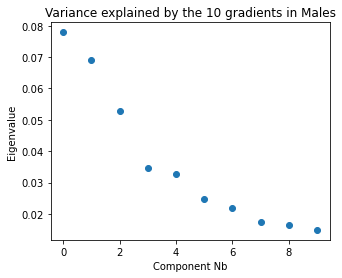

In [96]:
fig, ax = plt.subplots(1, figsize=(5, 4))

ax.scatter(range(mean_grad_M.lambdas_.size), mean_grad_M.lambdas_)
ax.set_title("Variance explained by the 10 gradients in Males")
ax.set_xlabel('Component Nb')
ax.set_ylabel('Eigenvalue')

plt.show()

In [97]:
count_varexp = 0
for i in range(len(mean_grad_M.lambdas_)):
    count_varexp += mean_grad_M.lambdas_[i]
    
print(f"Total amount of variance explained by the {len(mean_grad_M.lambdas_)} gradients in MALES: {count_varexp*100:.2f}%")
print(f"Variance explained by G1: {mean_grad_M.lambdas_[0]*100:.2f}%\nVariance explained by G2: {mean_grad_M.lambdas_[1]*100:.2f}%\nVariance explained by G3: {mean_grad_M.lambdas_[2]*100:.2f}%\n")

Total amount of variance explained by the 10 gradients in MALES: 36.23%
Variance explained by G1: 7.79%
Variance explained by G2: 6.90%
Variance explained by G3: 5.29%



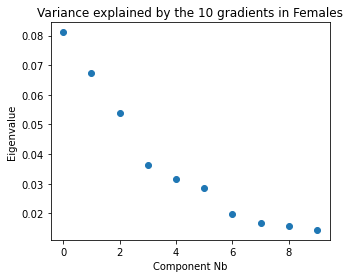

In [98]:
fig, ax = plt.subplots(1, figsize=(5, 4))

ax.scatter(range(mean_grad_F.lambdas_.size), mean_grad_F.lambdas_)
ax.set_title("Variance explained by the 10 gradients in Females")
ax.set_xlabel('Component Nb')
ax.set_ylabel('Eigenvalue')

plt.show()

In [99]:
count_varexp = 0
for i in range(len(mean_grad_F.lambdas_)):
    count_varexp += mean_grad_F.lambdas_[i]
    
print(f"Total amount of variance explained by the {len(mean_grad_F.lambdas_)} gradients in FEMALES: {count_varexp*100:.2f}%")
print(f"Variance explained by G1: {mean_grad_F.lambdas_[0]*100:.2f}%\nVariance explained by G2: {mean_grad_F.lambdas_[1]*100:.2f}%\nVariance explained by G3: {mean_grad_F.lambdas_[2]*100:.2f}%\n")

Total amount of variance explained by the 10 gradients in FEMALES: 36.49%
Variance explained by G1: 8.11%
Variance explained by G2: 6.72%
Variance explained by G3: 5.37%



Scatterplot of the first two gradients, colorcoding displays 3rd gradient (but categorical so not good)

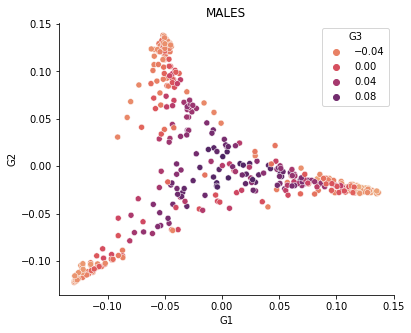

In [100]:
fig, ax = plt.subplots(figsize=(6,5));
ax = sns.scatterplot(x=mean_grad_M.gradients_[:,0],  # all rows (400 parcels), first column (G1)
                     y=mean_grad_M.gradients_[:,1],  # all rows (400 parcels), second column (G2)
                     hue=mean_grad_M.gradients_[:,2],  # gives color coding based on all rows (400 parcels), third column (G3)
                     palette=sns.color_palette("flare", as_cmap=True), 
                     legend=True, ax=ax);
ax.set_xlabel('G1');
ax.set_ylabel('G2');
ax.set_title("MALES")
ax.spines['right'].set_visible(False);
ax.spines['top'].set_visible(False);
plt.legend(title='G3')
plt.show(ax)

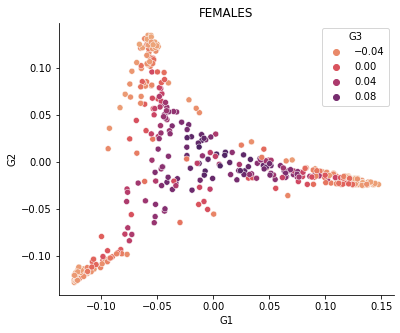

In [101]:
fig, ax = plt.subplots(figsize=(6,5));
ax = sns.scatterplot(x=mean_grad_F.gradients_[:,0],  # all rows (400 parcels), first column (G1)
                     y=mean_grad_F.gradients_[:,1],  # all rows (400 parcels), second column (G2)
                     hue=mean_grad_F.gradients_[:,2],  # gives color coding based on all rows (400 parcels), third column (G3)
                     palette=sns.color_palette("flare", as_cmap=True), 
                     legend=True, ax=ax);
ax.set_xlabel('G1');
ax.set_ylabel('G2');
ax.set_title("FEMALES")
ax.spines['right'].set_visible(False);
ax.spines['top'].set_visible(False);
plt.legend(title='G3')
plt.show(ax)

## Visualizing gradients by network

Using RainCloud plots https://github.com/RainCloudPlots/RainCloudPlots#python-environment

### Import the Yeo 7 network coding for the Schaefer 400 parcellation scheme 

(i.e., which network each parcel belongs to)



- **QUESTION: so a parcel cannot belong to more than 1 network..? LIMITATION NO?**

In [102]:
# labels: 1=visual, 2=sensory motor, 3=dorsal attention, 4=ventral attention, 5=limbic, 6=fronto parietal, 7= DMN

with open(datadir+'yeo_7.csv') as f:
    reader = csv.reader(f)
    yeo7_networks = list(reader)[0]  # need [0] because the network values are contained in double brackets [[ ]]

Plotting the 7 Yeo networks on cortical surface

**TO DO:**
- no option of a map with 7 colors..? https://matplotlib.org/stable/tutorials/colors/colormaps.html
- there must be a better way of labelling the maps with actual names of networks (ie categorical)? maybe not, not the purpose of this plot hemispheres function


/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


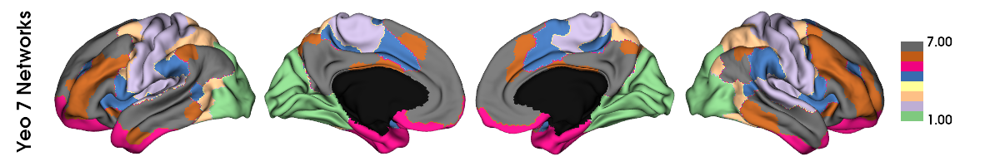

In [103]:
# need the the yeo network values (=dummy coding) to be in array format & float type in order to map_to_labels
yeo7_networks_array = []

for i in yeo7_networks:
    yeo7_networks_array.append(float(i))

yeo7_networks_array = np.asarray(yeo7_networks_array)



# defining labeling scheme and mask
labeling = load_parcellation('schaefer', scale=400, join=True)
surf_lh, surf_rh = load_conte69()

mask = labeling != 0

networks = map_to_labels(yeo7_networks_array, labeling, mask=mask, fill=np.nan)  # mean_grad contains 10 .gradients_ (1 gradient per column) - here I take all rows and individual select column based on gradient I want (first 3)

plot_hemispheres(surf_lh, surf_rh, array_name=networks, embed_nb = True, size=(1200, 200), cmap='Accent', color_bar=True, label_text=['Yeo 7 Networks'], zoom=1.55)


## Network labels ('Accent' cmap):
# 1 visual (green)
# 2 sensory motor (purple)
# 3 dorsal attention (beige)
# 4 ventral attention (blue)
# 5 limbic (fuchsia)
# 6 fronto parietal (brown)
# 7 DMN (grey)

### Gradient 1

Create a DataFrame containing the Gradient 1 eigenvalues and labelled Yeo 7 networks

In [104]:
# dataframe of the G1 eigenvalues (transposing the original array because we need the 400 parcels to be vertical in the dataframe in order to be labeled with their corresponding Yeo network)
df_G1 = pd.DataFrame(array_aligned_G1.T)

# adding a column containing the Yeo network labels
df_G1['yeo network'] = yeo7_networks

# renaming the Yeo network labels
df_G1.loc[df_G1["yeo network"] == "1", "yeo network"] = "visual"
df_G1.loc[df_G1["yeo network"] == "2", "yeo network"] = "sensory motor"
df_G1.loc[df_G1["yeo network"] == "3", "yeo network"] = "dorsal attention"
df_G1.loc[df_G1["yeo network"] == "4", "yeo network"] = "ventral attention"
df_G1.loc[df_G1["yeo network"] == "5", "yeo network"] = "limbic"
df_G1.loc[df_G1["yeo network"] == "6", "yeo network"] = "fronto parietal"
df_G1.loc[df_G1["yeo network"] == "7", "yeo network"] = "DMN"

# obtaining the mean of the parcels with the same Yeo network label, then transposing because we need the 1014 subjects to be vertical in the dataframe in order to be labeled with their corresponding sex 
df_G1 = df_G1.groupby("yeo network", as_index=True).mean().T

# adding a column containing the sex labels
df_G1["sex"] = merged_demographics_cleaned["Gender"].tolist()

# naming the index and resetting it as an index in order to make it callable in the following melt function
df_G1.index.name = "sub"
df_G1 = df_G1.reset_index()

# for the RainCloud plots, we need dataframe to have all values to be plotted in 1 column, and labels to be plotted in other columns (max 2)
# using melt() to make dataframe long so that mean eigenvalues per network are in one column, whilst preserving the sub number and sex as ID variables
df_G1=pd.melt(df_G1, id_vars=["sub", 'sex'], var_name='yeo network', value_name='mean eigenvalues per yeo network')

# in order to first display across sexes (clouds on the same line), creating another column with only 1s in order to use it as the "group" for dx
df_G1["across sexes"] = [1] * 7098

#### RainCloud plot of mean eigenvalues (G1) for 7 Yeo networks - across sexes

Mean eigenvalues for aligned G1 calculated across parcels belonging to each network (all subjects) 
7098 data points (1014 subjects * 7 networks) 

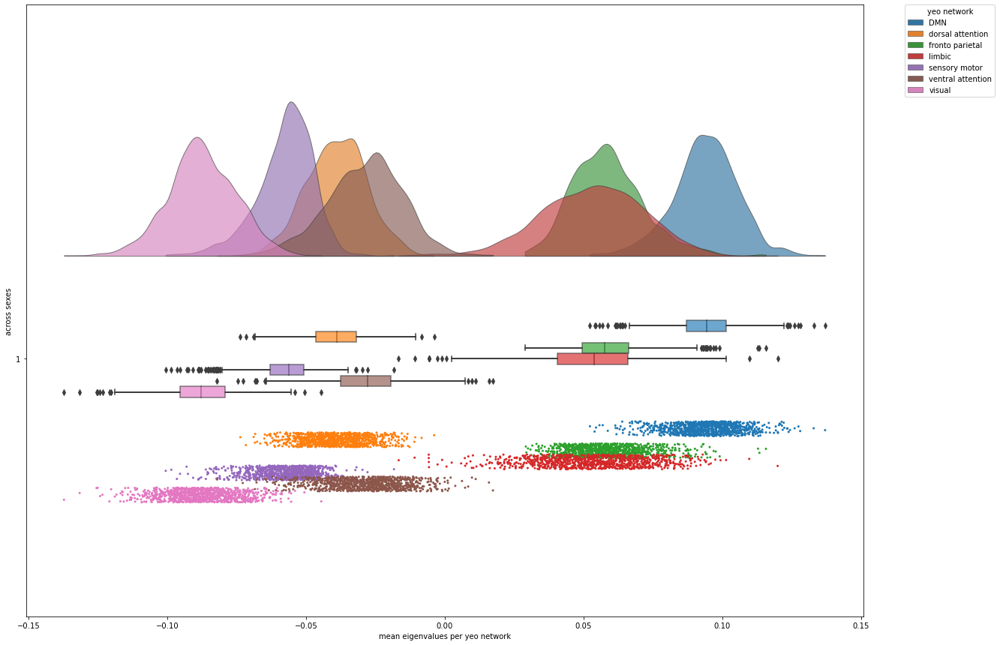

In [105]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="across sexes",
                y="mean eigenvalues per yeo network",
                hue="yeo network",
                data=df_G1,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=False, 
                dodge = True)

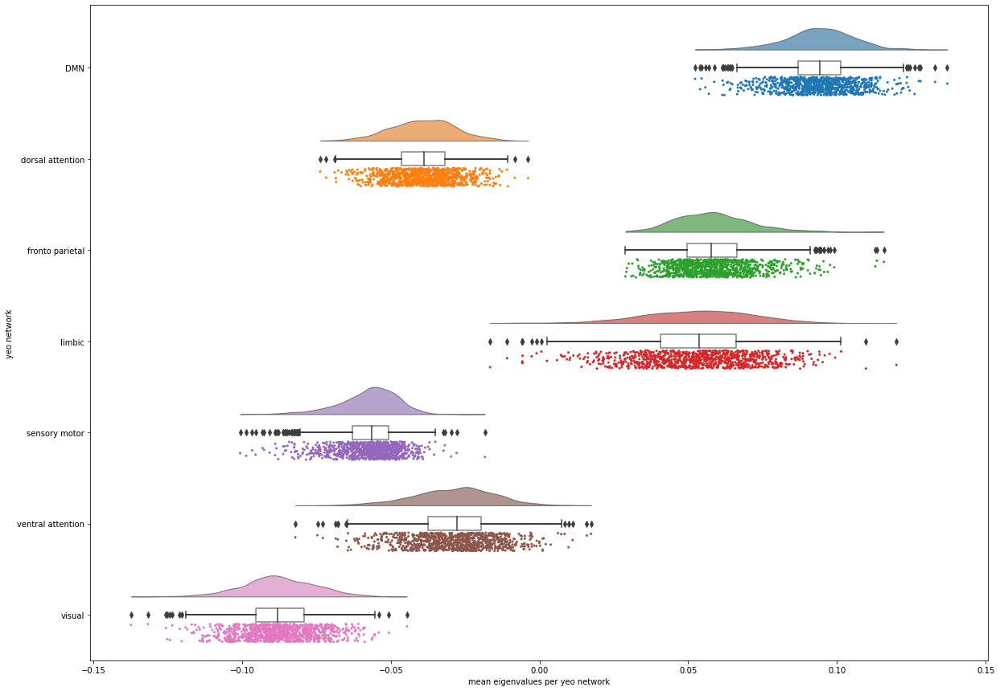

In [106]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="yeo network",
                y="mean eigenvalues per yeo network",
                #hue="yeo network",
                data=df_G1,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=False, 
                dodge = True)

#### RainCloud plot of mean eigenvalues (G1) for 7 Yeo networks - by sex

Mean eigenvalues for aligned G1 calculated across parcels belonging to each network (all subjects, displayed by sex) 

7098 data points (1014 subjects * 7 networks)

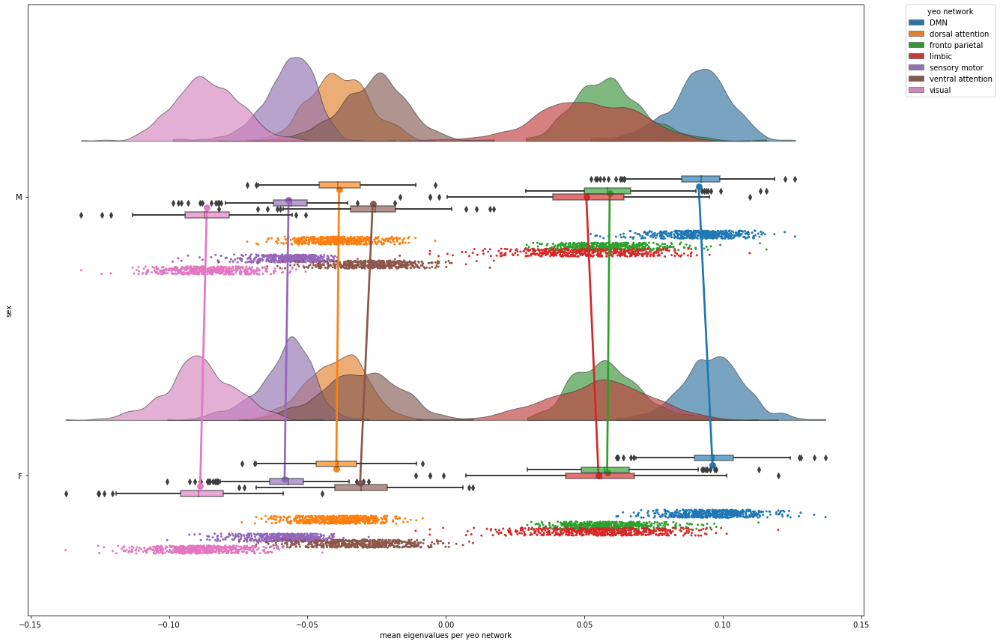

In [107]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="sex",
                y="mean eigenvalues per yeo network",
                hue="yeo network",
                data=df_G1,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=True, 
                dodge = True)

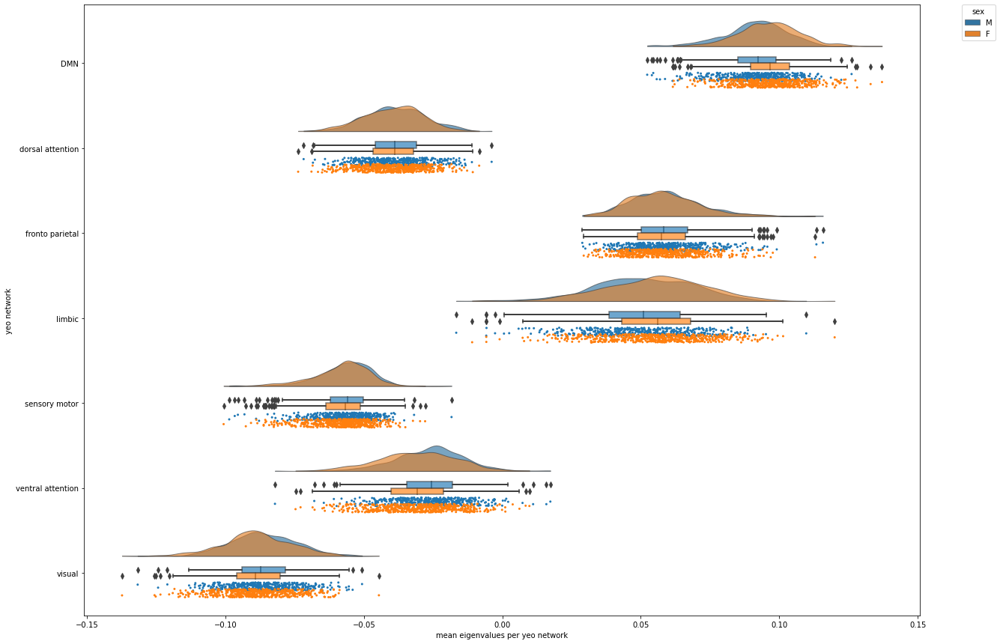

In [108]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="yeo network",
                y="mean eigenvalues per yeo network",
                hue="sex",
                data=df_G1,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                #figsize=(7,5),  # DELETE THIS
                orient="h",
                move=.2,
                alpha=.65, 
                dodge=True)

#### **In order to study brain organization (and related intersubject variability) - plot the distribution of 400 parcel eigenvalues per network** (variability across 10 subjects - only indicative)
#### RainCloud plot of eigenvalues (G1) for each parcel (labeled by network) - for first 10 subjects

400 parcel eigenvalues (labeled with 7 Yeo networks) for G1, for first 10 subjects

4000 data points (400 parcels * 10 subjects)

Sex of subjects (from top to bottom): ['M', 'F', 'M', 'M', 'F', 'M', 'M', 'F', 'M', 'M']


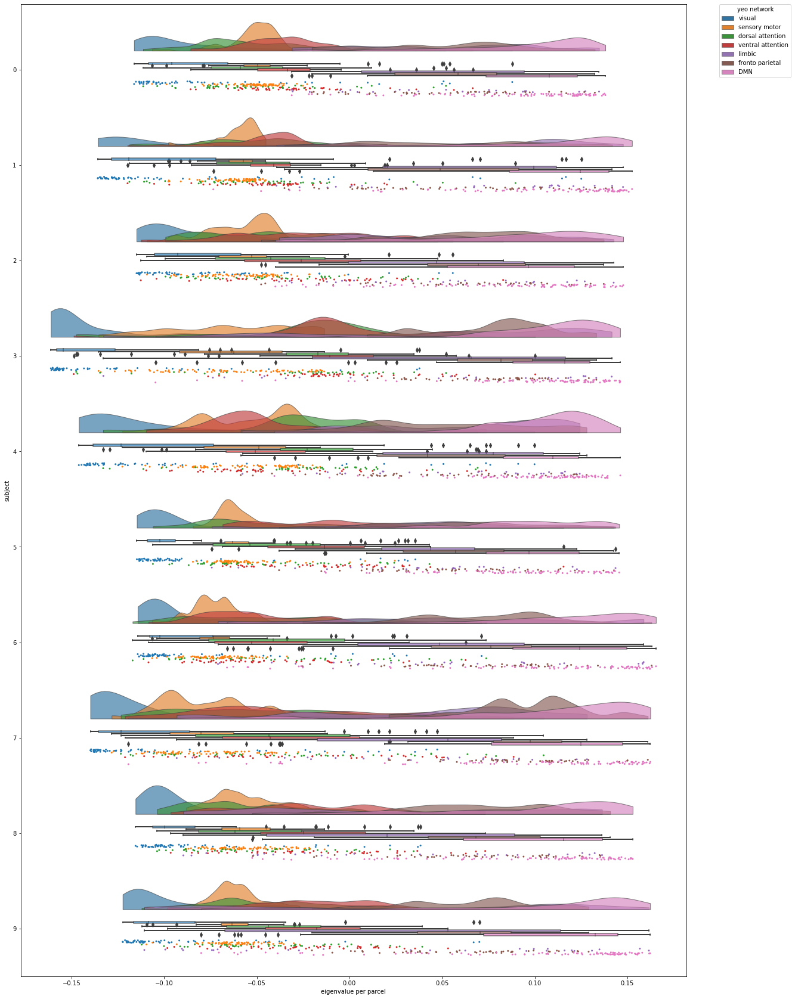

In [109]:
### Organizing the data

df_G1_10sub = pd.DataFrame(array_aligned_G1[0:10].T)

# adding a column containing the Yeo network labels
df_G1_10sub['yeo network'] = yeo7_networks

# renaming the Yeo network labels
df_G1_10sub.loc[df_G1_10sub["yeo network"] == "1", "yeo network"] = "visual"
df_G1_10sub.loc[df_G1_10sub["yeo network"] == "2", "yeo network"] = "sensory motor"
df_G1_10sub.loc[df_G1_10sub["yeo network"] == "3", "yeo network"] = "dorsal attention"
df_G1_10sub.loc[df_G1_10sub["yeo network"] == "4", "yeo network"] = "ventral attention"
df_G1_10sub.loc[df_G1_10sub["yeo network"] == "5", "yeo network"] = "limbic"
df_G1_10sub.loc[df_G1_10sub["yeo network"] == "6", "yeo network"] = "fronto parietal"
df_G1_10sub.loc[df_G1_10sub["yeo network"] == "7", "yeo network"] = "DMN"

# naming the index and resetting it as an index in order to make it callable in the following melt function
df_G1_10sub.index.name = "sub"

# for the RainCloud plots, we need dataframe to have all values to be plotted in 1 column, and labels to be plotted in other columns (max 2)
# using melt() to make dataframe long so that mean eigenvalues per network are in one column, whilst preserving the sub number and sex as ID variables
df_G1_10sub=pd.melt(df_G1_10sub, id_vars=['yeo network'], var_name='subject', value_name='eigenvalue per parcel')


### Plotting 400 parcel eigenvalues (labeled by network) for G1, for first 10 subjects

f,ax=plt.subplots(figsize=(20,30))

ax=pt.RainCloud(x="subject",
                y="eigenvalue per parcel",
                hue="yeo network",
                data=df_G1_10sub,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=False, 
                dodge = True)

print(f'Sex of subjects (from top to bottom): {merged_demographics_cleaned["Gender"].tolist()[0:10]}')

### Gradient 2

Create a DataFrame containing the Gradient 2 eigenvalues and labelled Yeo 7 networks

In [110]:
# dataframe of the G2 eigenvalues (transposing the original array because we need the 400 parcels to be vertical in the dataframe in order to be labeled with their corresponding Yeo network)
df_G2 = pd.DataFrame(array_aligned_G2.T)

# adding a column containing the Yeo network labels
df_G2['yeo network'] = yeo7_networks

# renaming the Yeo network labels
df_G2.loc[df_G2["yeo network"] == "1", "yeo network"] = "visual"
df_G2.loc[df_G2["yeo network"] == "2", "yeo network"] = "sensory motor"
df_G2.loc[df_G2["yeo network"] == "3", "yeo network"] = "dorsal attention"
df_G2.loc[df_G2["yeo network"] == "4", "yeo network"] = "ventral attention"
df_G2.loc[df_G2["yeo network"] == "5", "yeo network"] = "limbic"
df_G2.loc[df_G2["yeo network"] == "6", "yeo network"] = "fronto parietal"
df_G2.loc[df_G2["yeo network"] == "7", "yeo network"] = "DMN"

# obtaining the mean of the parcels with the same Yeo network label, then transposing because we need the 1014 subjects to be vertical in the dataframe in order to be labeled with their corresponding sex 
df_G2 = df_G2.groupby("yeo network", as_index=True).mean().T

# adding a column containing the sex labels
df_G2["sex"] = merged_demographics_cleaned["Gender"].tolist()

# naming the index and resetting it as an index in order to make it callable in the following melt function
df_G2.index.name = "sub"
df_G2 = df_G2.reset_index()

# for the RainCloud plots, we need dataframe to have all values to be plotted in 1 column, and labels to be plotted in other columns (max 2)
# using melt() to make dataframe long so that mean eigenvalues per network are in one column, whilst preserving the sub number and sex as ID variables
df_G2=pd.melt(df_G2, id_vars=["sub", 'sex'], var_name='yeo network', value_name='mean eigenvalues per yeo network')

# in order to first display across sexes (clouds on the same line), creating another column with only 1s in order to use it as the "group" for dx
df_G2["across sexes"] = [1] * 7098

#### RainCloud plot of mean eigenvalues (G2) for 7 Yeo networks - across sexes

Mean eigenvalues for aligned G2 calculated across parcels belonging to each network (all subjects) 
7098 data points (1014 subjects * 7 networks) 

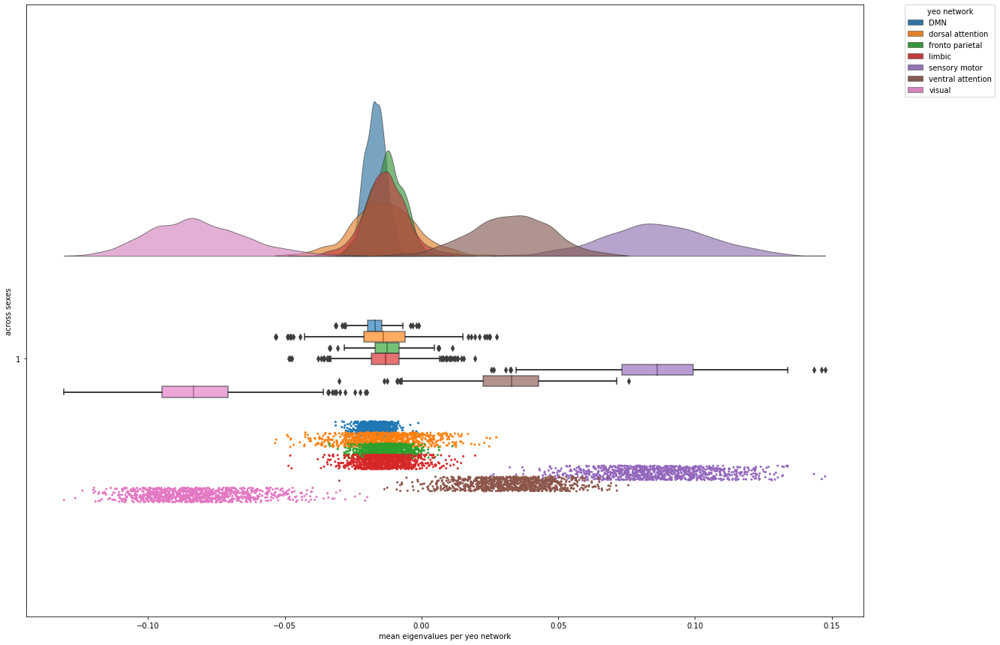

In [111]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="across sexes",
                y="mean eigenvalues per yeo network",
                hue="yeo network",
                data=df_G2,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=False, 
                dodge = True)

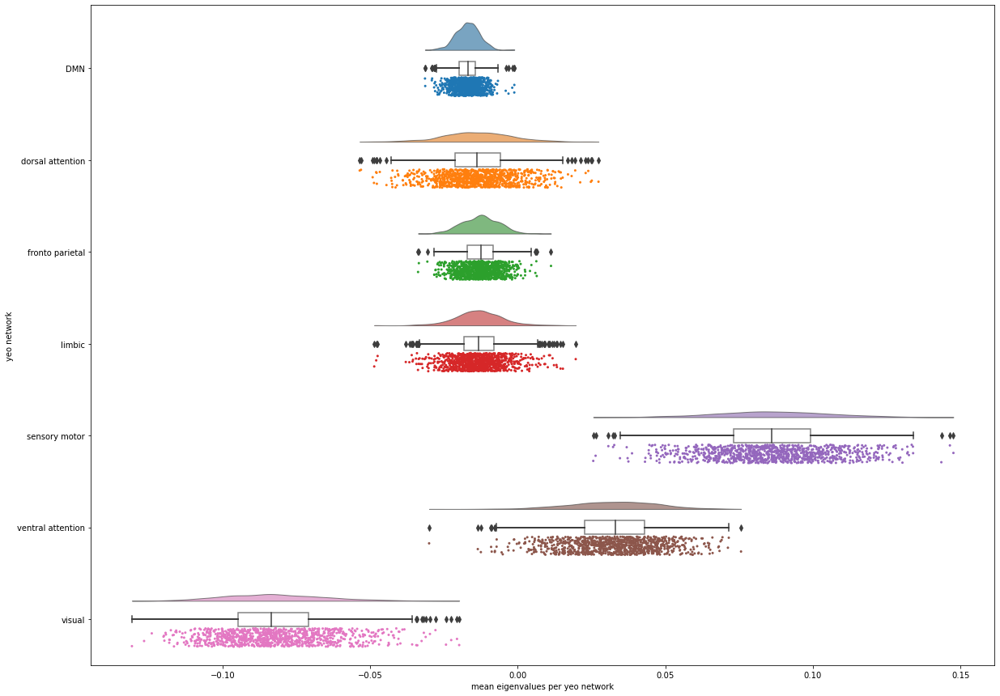

In [112]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="yeo network",
                y="mean eigenvalues per yeo network",
                #hue="yeo network",
                data=df_G2,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=False, 
                dodge = True)

#### RainCloud plots of mean eigenvalues (G2) for 7 Yeo networks - by sex

Mean eigenvalues for aligned G2 calculated across parcels belonging to each network (all subjects, displayed by sex) 

7098 data points (1014 subjects * 7 networks) 


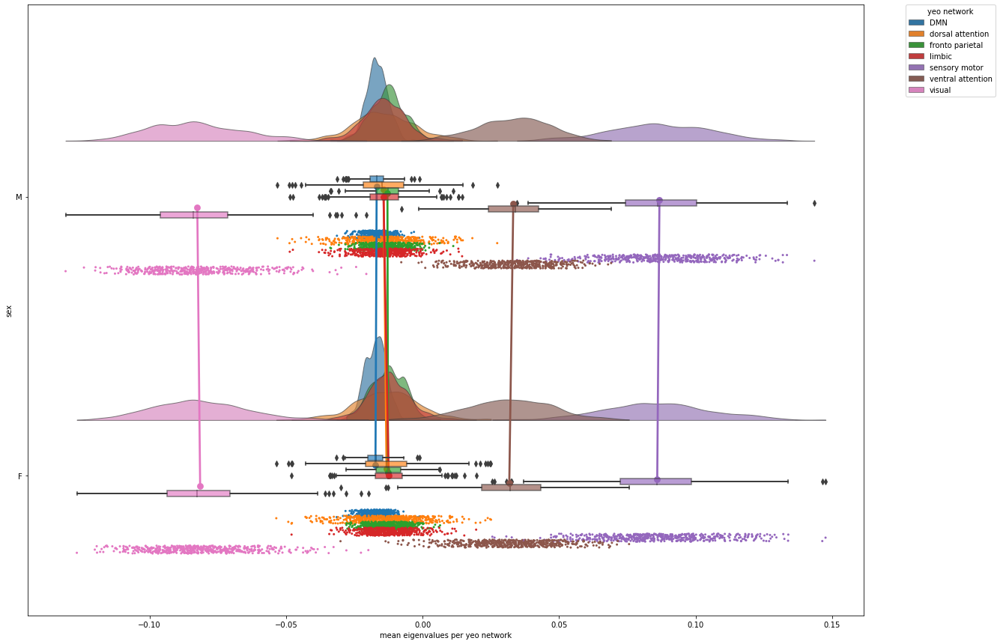

In [113]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="sex",
                y="mean eigenvalues per yeo network",
                hue="yeo network",
                data=df_G2,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=True, 
                dodge = True)

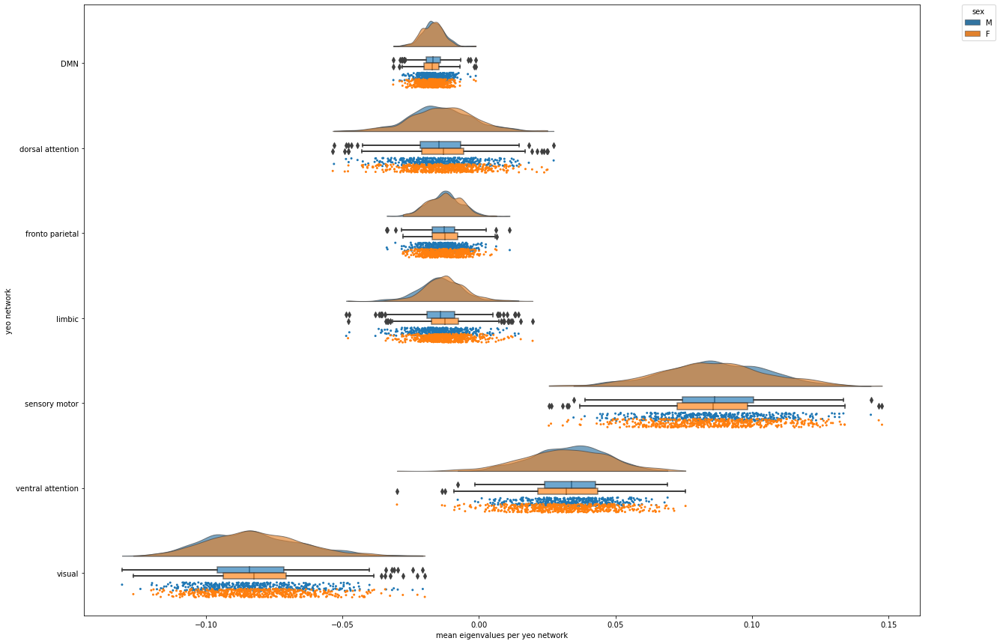

In [114]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="yeo network",
                y="mean eigenvalues per yeo network",
                hue="sex",
                data=df_G2,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65, 
                dodge=True)

#### **In order to study brain organization (and related intersubject variability) - plot the distribution of 400 parcel eigenvalues per network** (variability across 10 subjects - only indicative)
#### RainCloud plot of eigenvalues (G2) for each parcel (labeled by network) - for first 10 subjects

400 parcel eigenvalues (labeled with 7 Yeo networks) for G2, for first 10 subjects

4000 data points (400 parcels * 10 subjects)

Sex of subjects (from top to bottom): ['M', 'F', 'M', 'M', 'F', 'M', 'M', 'F', 'M', 'M']


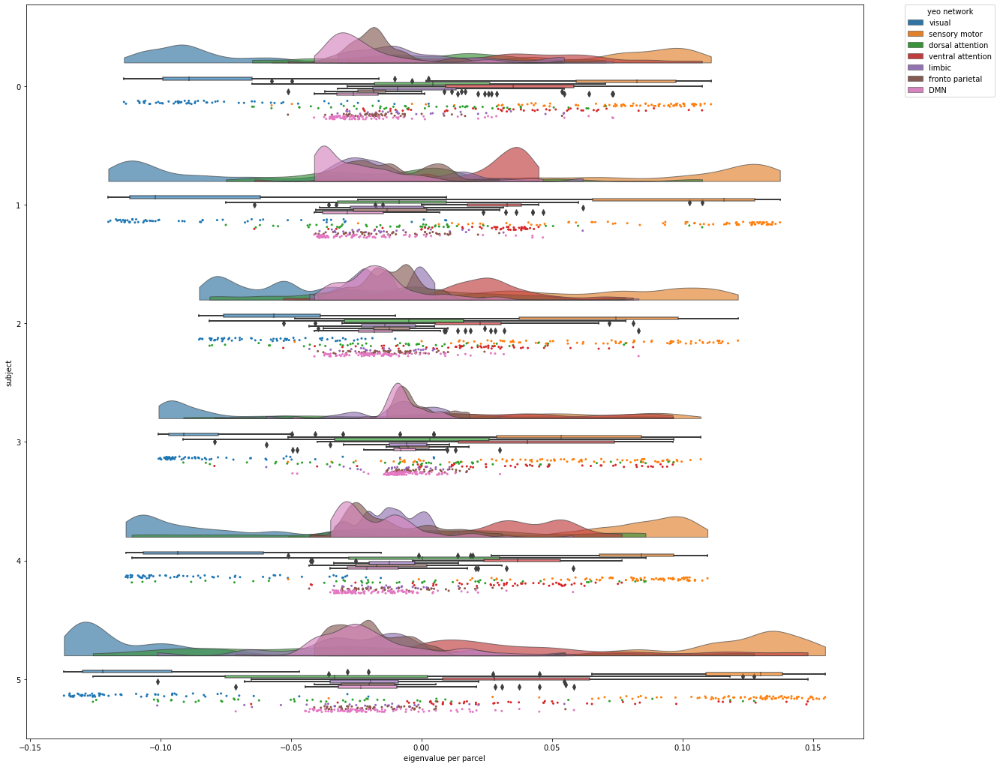

In [115]:
### Organizing the data

df_G2_10sub = pd.DataFrame(array_aligned_G2[0:6].T)

# adding a column containing the Yeo network labels
df_G2_10sub['yeo network'] = yeo7_networks

# renaming the Yeo network labels
df_G2_10sub.loc[df_G2_10sub["yeo network"] == "1", "yeo network"] = "visual"
df_G2_10sub.loc[df_G2_10sub["yeo network"] == "2", "yeo network"] = "sensory motor"
df_G2_10sub.loc[df_G2_10sub["yeo network"] == "3", "yeo network"] = "dorsal attention"
df_G2_10sub.loc[df_G2_10sub["yeo network"] == "4", "yeo network"] = "ventral attention"
df_G2_10sub.loc[df_G2_10sub["yeo network"] == "5", "yeo network"] = "limbic"
df_G2_10sub.loc[df_G2_10sub["yeo network"] == "6", "yeo network"] = "fronto parietal"
df_G2_10sub.loc[df_G2_10sub["yeo network"] == "7", "yeo network"] = "DMN"

# naming the index and resetting it as an index in order to make it callable in the following melt function
df_G2_10sub.index.name = "sub"

# for the RainCloud plots, we need dataframe to have all values to be plotted in 1 column, and labels to be plotted in other columns (max 2)
# using melt() to make dataframe long so that mean eigenvalues per network are in one column, whilst preserving the sub number and sex as ID variables
df_G2_10sub=pd.melt(df_G2_10sub, id_vars=['yeo network'], var_name='subject', value_name='eigenvalue per parcel')


### Plotting 400 parcel eigenvalues (labeled by network) for G2, for first 10 subjects

f,ax=plt.subplots(figsize=(20,18))

ax=pt.RainCloud(x="subject",
                y="eigenvalue per parcel",
                hue="yeo network",
                data=df_G2_10sub,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=False, 
                dodge = True)

print(f'Sex of subjects (from top to bottom): {merged_demographics_cleaned["Gender"].tolist()[0:10]}')

### Gradient 3

Create a DataFrame containing the Gradient 3 eigenvalues and labelled Yeo 7 networks

In [116]:
# dataframe of the G3 eigenvalues (transposing the original array because we need the 400 parcels to be vertical in the dataframe in order to be labeled with their corresponding Yeo network)
df_G3 = pd.DataFrame(array_aligned_G3.T)

# adding a column containing the Yeo network labels
df_G3['yeo network'] = yeo7_networks

# renaming the Yeo network labels
df_G3.loc[df_G3["yeo network"] == "1", "yeo network"] = "visual"
df_G3.loc[df_G3["yeo network"] == "2", "yeo network"] = "sensory motor"
df_G3.loc[df_G3["yeo network"] == "3", "yeo network"] = "dorsal attention"
df_G3.loc[df_G3["yeo network"] == "4", "yeo network"] = "ventral attention"
df_G3.loc[df_G3["yeo network"] == "5", "yeo network"] = "limbic"
df_G3.loc[df_G3["yeo network"] == "6", "yeo network"] = "fronto parietal"
df_G3.loc[df_G3["yeo network"] == "7", "yeo network"] = "DMN"

# obtaining the mean of the parcels with the same Yeo network label, then transposing because we need the 1014 subjects to be vertical in the dataframe in order to be labeled with their corresponding sex 
df_G3 = df_G3.groupby("yeo network", as_index=True).mean().T

# adding a column containing the sex labels
df_G3["sex"] = merged_demographics_cleaned["Gender"].tolist()

# naming the index and resetting it as an index in order to make it callable in the following melt function
df_G3.index.name = "sub"
df_G3 = df_G3.reset_index()

# for the RainCloud plots, we need dataframe to have all values to be plotted in 1 column, and labels to be plotted in other columns (max 2)
# using melt() to make dataframe long so that mean eigenvalues per network are in one column, whilst preserving the sub number and sex as ID variables
df_G3=pd.melt(df_G3, id_vars=["sub", 'sex'], var_name='yeo network', value_name='mean eigenvalues per yeo network')

# in order to first display across sexes (clouds on the same line), creating another column with only 1s in order to use it as the "group" for dx
df_G3["across sexes"] = [1] * 7098

#### RainCloud plots of mean eigenvalues (G3) for 7 Yeo networks - across sexes

Mean eigenvalues for aligned G3 calculated across parcels belonging to each network (all subjects) 
7098 data points (1014 subjects * 7 networks) 

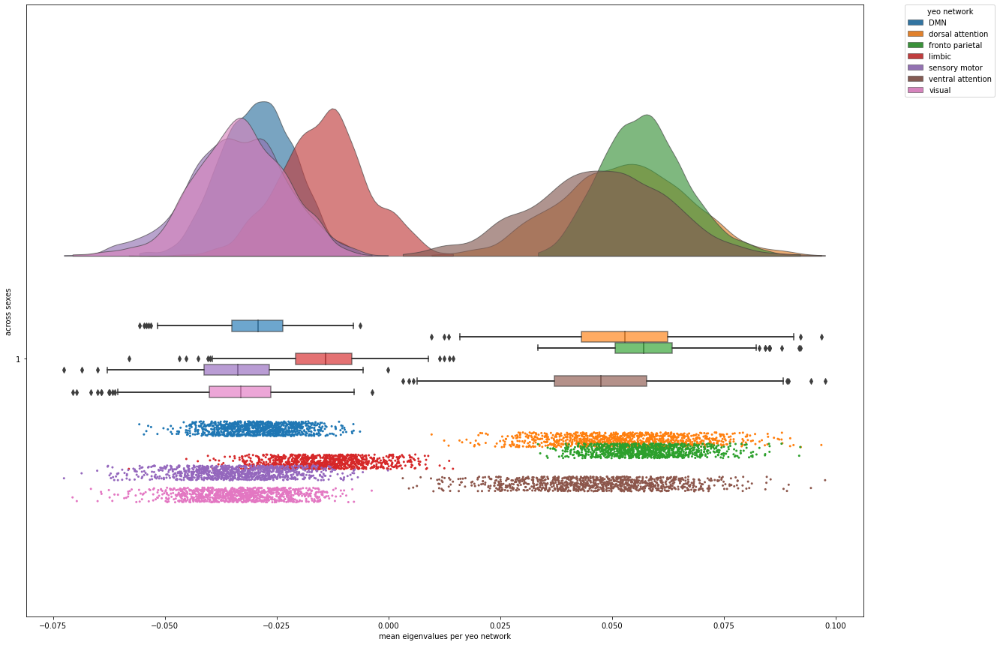

In [117]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="across sexes",
                y="mean eigenvalues per yeo network",
                hue="yeo network",
                data=df_G3,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=False, 
                dodge = True)

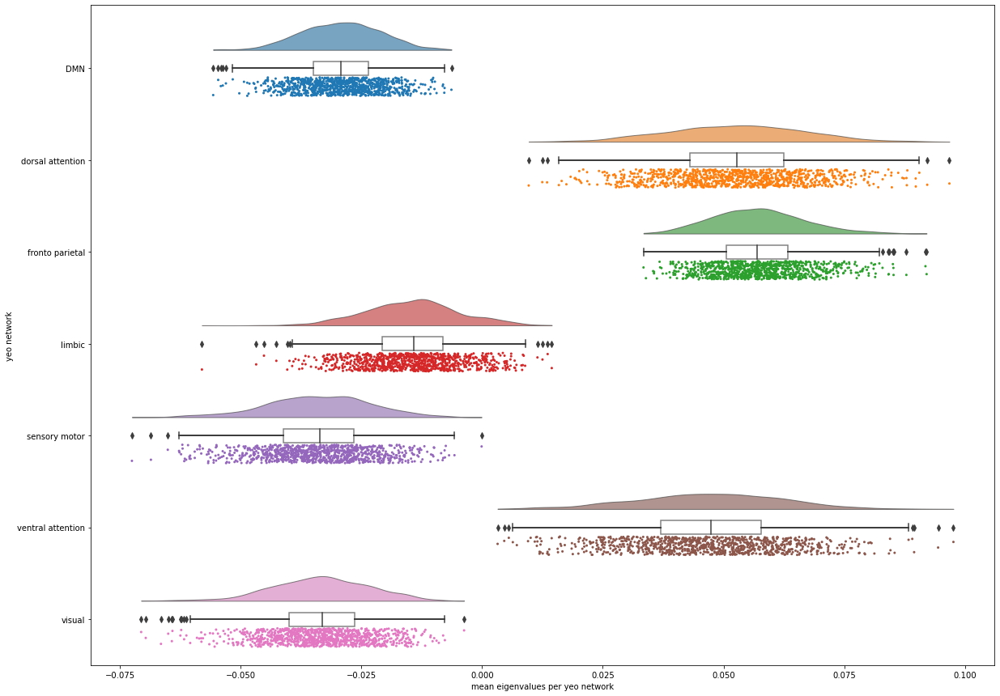

In [118]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="yeo network",
                y="mean eigenvalues per yeo network",
                #hue="yeo network",
                data=df_G3,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=False, 
                dodge = True)

#### RainCloud plots of mean eigenvalues (G3) for 7 Yeo networks - by sex

Mean eigenvalues for aligned G3 calculated across parcels belonging to each network (all subjects, displayed by sex) 

7098 data points (1014 subjects * 7 networks) 

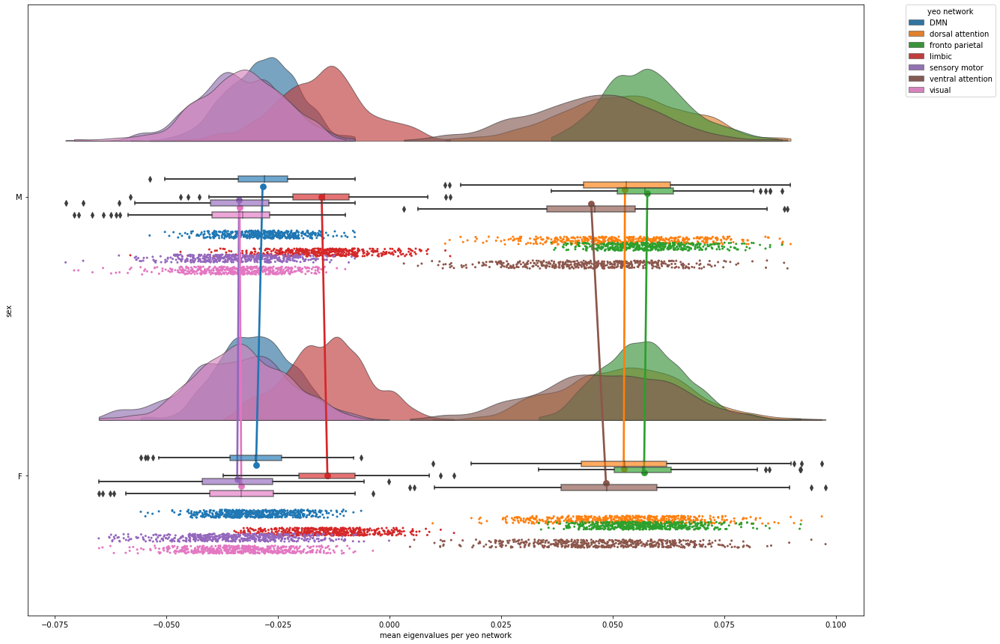

In [119]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="sex",
                y="mean eigenvalues per yeo network",
                hue="yeo network",
                data=df_G3,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=True, 
                dodge = True)

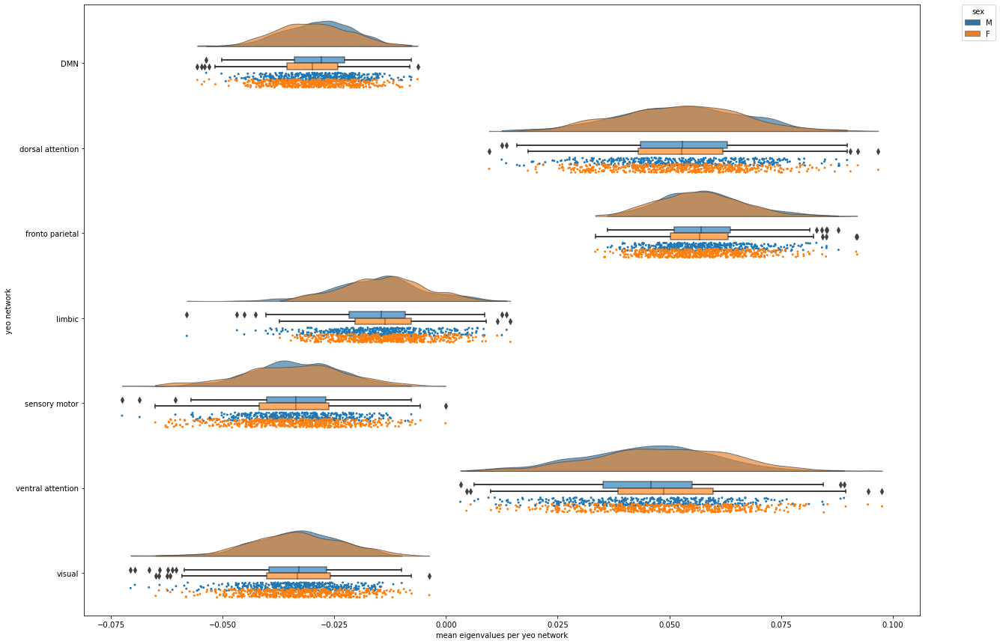

In [120]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="yeo network",
                y="mean eigenvalues per yeo network",
                hue="sex",
                data=df_G3,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65, 
                dodge=True)

#### **In order to study brain organization (and related intersubject variability) - plot the distribution of 400 parcel eigenvalues per network** (variability across 10 subjects - only indicative)
#### RainCloud plot of eigenvalues (G3) for each parcel (labeled by network) - for first 10 subjects

400 parcel eigenvalues (labeled with 7 Yeo networks) for G3, for first 10 subjects

4000 data points (400 parcels * 10 subjects)

Sex of subjects (from top to bottom): ['M', 'F', 'M', 'M', 'F', 'M', 'M', 'F', 'M', 'M']


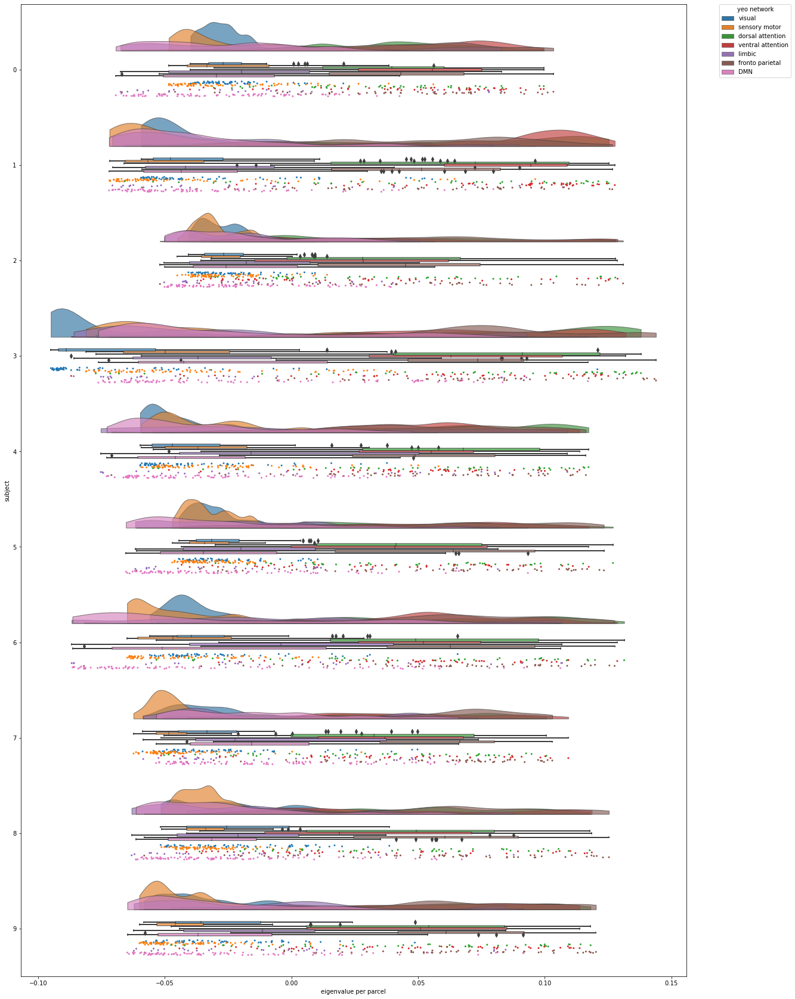

In [121]:
### Organizing the data

df_G3_10sub = pd.DataFrame(array_aligned_G3[0:10].T)

# adding a column containing the Yeo network labels
df_G3_10sub['yeo network'] = yeo7_networks

# renaming the Yeo network labels
df_G3_10sub.loc[df_G3_10sub["yeo network"] == "1", "yeo network"] = "visual"
df_G3_10sub.loc[df_G3_10sub["yeo network"] == "2", "yeo network"] = "sensory motor"
df_G3_10sub.loc[df_G3_10sub["yeo network"] == "3", "yeo network"] = "dorsal attention"
df_G3_10sub.loc[df_G3_10sub["yeo network"] == "4", "yeo network"] = "ventral attention"
df_G3_10sub.loc[df_G3_10sub["yeo network"] == "5", "yeo network"] = "limbic"
df_G3_10sub.loc[df_G3_10sub["yeo network"] == "6", "yeo network"] = "fronto parietal"
df_G3_10sub.loc[df_G3_10sub["yeo network"] == "7", "yeo network"] = "DMN"

# naming the index and resetting it as an index in order to make it callable in the following melt function
df_G3_10sub.index.name = "sub"

# for the RainCloud plots, we need dataframe to have all values to be plotted in 1 column, and labels to be plotted in other columns (max 2)
# using melt() to make dataframe long so that mean eigenvalues per network are in one column, whilst preserving the sub number and sex as ID variables
df_G3_10sub=pd.melt(df_G3_10sub, id_vars=['yeo network'], var_name='subject', value_name='eigenvalue per parcel')


### Plotting 400 parcel eigenvalues (labeled by network) for G3, for first 10 subjects

f,ax=plt.subplots(figsize=(20,30))

ax=pt.RainCloud(x="subject",
                y="eigenvalue per parcel",
                hue="yeo network",
                data=df_G3_10sub,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=False, 
                dodge = True)

print(f'Sex of subjects (from top to bottom): {merged_demographics_cleaned["Gender"].tolist()[0:10]}')

### Plot examples 
*maybe delete later*

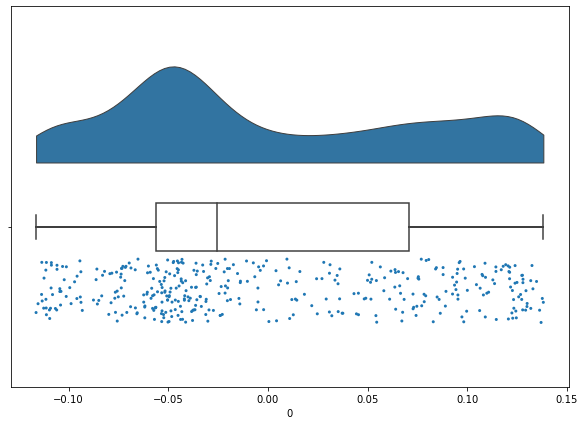

In [122]:
# plotting 400 parcel values for G1, for 1st subject

f,ax=plt.subplots(figsize=(10,7))
#dy="group";dx="score"

ax=pt.RainCloud(#x="yeo7_networks",
                y=0,  # fist participant
                data=pd.DataFrame(array_aligned_G1.T),
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                #figsize=(7,5),  # DELETE THIS
                orient="h",
                move=.2)

In [123]:
df_G1_sex = pd.DataFrame(array_aligned_G1)
df_G1_sex["sex"] = merged_demographics_cleaned["Gender"].tolist()

df_G1_sex

,0,1,2,3,4,5,6,7,8,9,...,391,392,393,394,395,396,397,398,399,sex
0,-0.053425,0.016031,-0.095854,-0.081977,-0.087527,-0.085566,0.050805,-0.105817,-0.084856,-0.104406,...,0.077163,0.009539,0.054422,0.124963,0.127374,0.087907,0.080678,0.127985,0.018311,M
1,-0.072516,0.070655,-0.121785,-0.126228,-0.131448,-0.103872,-0.019029,-0.117565,-0.121940,-0.133569,...,0.133307,0.042408,0.069333,0.145794,0.139589,0.137295,0.062439,0.143118,0.124675,F
2,-0.079670,0.021406,-0.097236,-0.110441,-0.098834,-0.058082,-0.033796,-0.093032,-0.077922,-0.113764,...,-0.017854,0.086153,0.013113,0.115423,0.122459,0.109331,0.072974,0.137878,0.024801,M
3,-0.143398,-0.063700,-0.159533,-0.160285,-0.158919,-0.090442,-0.141377,-0.125652,-0.156853,-0.160184,...,0.074171,0.080045,0.095805,0.126884,0.127351,0.108099,0.098907,0.140335,-0.082292,M
4,-0.001580,0.091086,-0.116018,-0.137342,-0.142752,-0.099704,-0.060496,-0.112049,-0.119690,-0.143313,...,0.107811,0.052802,0.076043,0.120940,0.132591,0.125891,0.104241,0.127887,0.093690,F
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1009,-0.050449,0.098604,-0.156793,-0.155635,-0.156990,-0.141433,-0.094538,-0.138514,-0.149751,-0.160168,...,0.121436,0.113800,-0.037413,0.161668,0.158164,0.148449,0.141215,0.166090,-0.060990,F
1010,-0.083235,-0.020046,-0.111517,-0.115452,-0.116822,-0.091142,-0.065895,-0.089759,-0.104915,-0.120880,...,0.010715,0.095778,0.006188,0.123728,0.108058,0.113429,0.093901,0.145095,-0.000280,M
1011,-0.107417,0.093467,-0.121074,-0.131515,-0.133162,-0.133143,0.071997,-0.119422,-0.131163,-0.118252,...,0.098296,0.101714,0.083607,0.145529,0.126077,0.079028,0.074056,0.123130,0.034440,F
1012,0.007340,0.050463,-0.077861,-0.104972,-0.115008,-0.081382,-0.029749,-0.055880,-0.100857,-0.115806,...,0.009137,0.048276,0.002298,0.129247,0.069760,0.106380,0.087238,0.088835,-0.009456,M


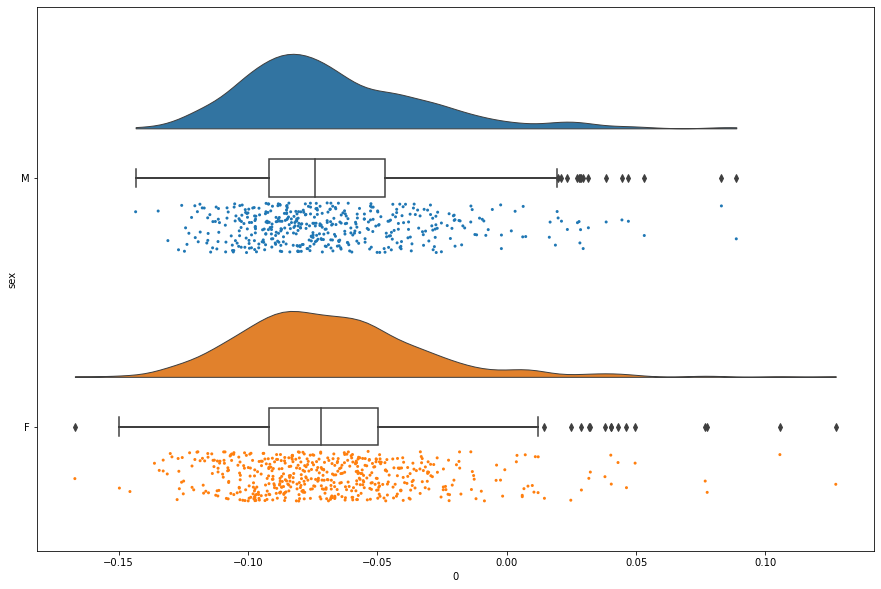

In [124]:
# plotting 1400 subject (G1) by sex, for 1st parcel

f,ax=plt.subplots(figsize=(15,10))
#dy="group";dx="score"

ax=pt.RainCloud(x="sex",
                y=0,
                data=df_G1_sex,
                palette=sns.color_palette(n_colors=2),
                bw=.2,
                width_viol=.6,
                #figsize=(7,5),  # DELETE THIS
                orient="h",
                move=.2)

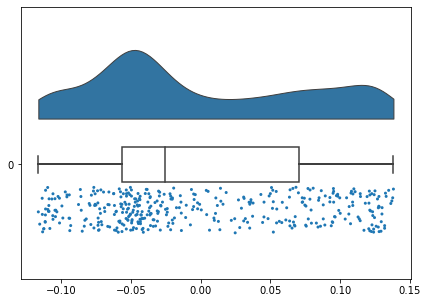

In [125]:
# plotting 1 paricipant, 400 parcel values

f,ax=plt.subplots(figsize=(7,5))
#dy="group";dx="score"

ax=pt.RainCloud(#x=dx,
                #y=yeo7_networks,
                data=array_aligned_G1[0],
                palette=sns.color_palette(n_colors=1),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2)

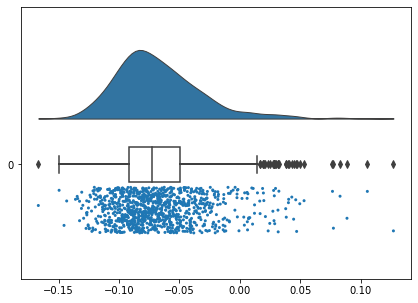

In [126]:
# plotting 1 parcel, 1014 subject values

f,ax=plt.subplots(figsize=(7,5))
#dy="group";dx="score"

ax=pt.RainCloud(#x=dx,
                #y=yeo7_networks,
                data=array_aligned_G1.T[0],
                palette=sns.color_palette(n_colors=1),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2)

#### RainCloud plots of eigenvalues (G1) for each parcel (labeled by network) - for 1 subject

400 parcel eigenvalues (labeled with 7 Yeo networks) for G1, for 1st subject

400 data points (400 parcels * 1 subject)

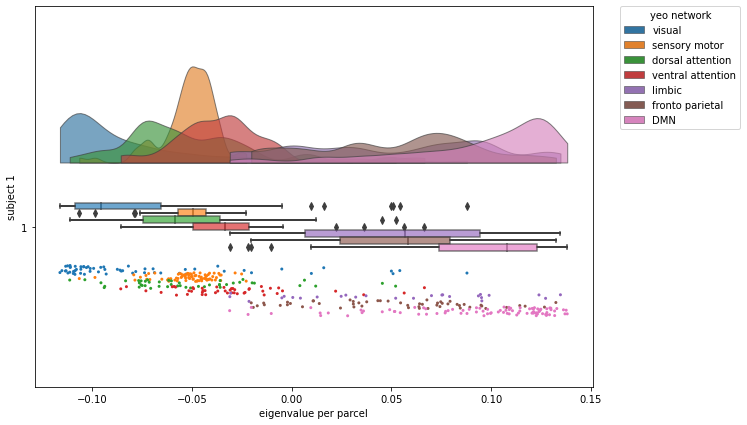

In [127]:
### Organizing the data

# all parcels of 1st subject in DataFrame format
df_G1_sub1 = pd.DataFrame(array_aligned_G1[0])

# adding a column containing the Yeo network labels
df_G1_sub1['yeo network'] = yeo7_networks

# renaming the Yeo network labels
df_G1_sub1.loc[df_G1_sub1["yeo network"] == "1", "yeo network"] = "visual"
df_G1_sub1.loc[df_G1_sub1["yeo network"] == "2", "yeo network"] = "sensory motor"
df_G1_sub1.loc[df_G1_sub1["yeo network"] == "3", "yeo network"] = "dorsal attention"
df_G1_sub1.loc[df_G1_sub1["yeo network"] == "4", "yeo network"] = "ventral attention"
df_G1_sub1.loc[df_G1_sub1["yeo network"] == "5", "yeo network"] = "limbic"
df_G1_sub1.loc[df_G1_sub1["yeo network"] == "6", "yeo network"] = "fronto parietal"
df_G1_sub1.loc[df_G1_sub1["yeo network"] == "7", "yeo network"] = "DMN"

# renaming columns
df_G1_sub1.columns = ['eigenvalue per parcel', 'yeo network']

# in order to first display all networks next to one another (clouds on the same line), creating another column with only 1s in order to use it as the "group" for dx
df_G1_sub1["subject 1"] = [1] * 400



### Plotting 400 parcel eigenvalues (labeled by network) for G1, for 1st subject

f,ax=plt.subplots(figsize=(10,7))

ax=pt.RainCloud(x="subject 1",
                y="eigenvalue per parcel",
                hue="yeo network",
                data=df_G1_sub1,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=False, 
                dodge = True)

## Sex effects (standard linear regression - FDR-corrected - main model: sex + age + ICV)

### !!!! TO DO: TRY NOT FDR CORRECTED

In [128]:
def plot_slm_results(slm):
    
    '''
    Function that plots slm results (for now only FDR corrected)
    
    Specific to plotting on surf_lh, surf_rh from conte69; for data coming from Schaefer 400 parcellation
    
    '''
    
    # defining labeling scheme and mask
    # ! if doesn't work anymore for some reason, take this out of the definition (put it before it) !
    labeling = load_parcellation('schaefer', scale=400, join=True)
    surf_lh, surf_rh = load_conte69()
    mask = labeling != 0
    
    
    # will contain the different plots
    handles = []
    
    
    ### t-values
    tvals_mapped_to_labels = map_to_labels(slm.t[0], labeling, mask=mask, fill=np.nan)  # t[0] because there is a double bracket for the t-values array, need [0] to access the values themselves
    
    tvals_plotted_hemispheres = plot_hemispheres(
        surf_lh, 
        surf_rh, 
        array_name = tvals_mapped_to_labels, 
        embed_nb = True, 
        size = (1400,200), 
        cmap = "bwr", 
        color_bar = True, 
        #color_range = color_range_t,
        nan_color = (0.7, 0.7, 0.7, 1),
        label_text = ["t-values"],
        zoom = 1.45)
    
    # plot
    handles.append(tvals_plotted_hemispheres)
                   
                   
    ### Q-values
    
    #assigning to new variable using copy() so that changes made in copy will not affect the original array
    Qvals = slm.Q.copy()  

    # only keep Q-values that are significant (replacing values > 0.05 with nan)
    np.place(Qvals, Qvals > 0.05, np.nan) 
    
    # this maps shape (400,) turning it inot shape (64984,)
    Qvals_mapped_to_labels = map_to_labels(Qvals, labeling, mask=mask, fill=np.nan)
    
    # plot
    Qvals_plotted_hemispheres =  plot_hemispheres(
        surf_lh, 
        surf_rh, 
        array_name = Qvals_mapped_to_labels, 
        embed_nb = True, 
        size = (1400,200), 
        cmap = "plasma_r", 
        color_bar = True, 
        #color_range = color_range_Q,
        nan_color = (0.7, 0.7, 0.7, 1),
        label_text = ["Q-values"],
        zoom = 1.45)
    
    handles.append(Qvals_plotted_hemispheres)
                                           
    return handles

### Gradient 1

In [129]:
### creating model terms

term_sex = FixedEffect(merged_demographics_cleaned.Gender)
term_age = FixedEffect(merged_demographics_cleaned.Age_in_Yrs)
term_icv = FixedEffect(merged_demographics_cleaned.FS_IntraCranial_Vol)


### defining contrast to test: sex differences

contrast_sex = (merged_demographics_cleaned.Gender == "M").astype(int) - (merged_demographics_cleaned.Gender == "F").astype(int)  # makes M = 1 and F = -1


### defining the main model 

model_sex_age_icv = term_sex + term_age + term_icv  


### fitting the main model

# sex effects including sex, age, and icv in model
slm_SEX_age_icv = SLM(
    model_sex_age_icv,
    contrast = contrast_sex,
    correction=["fdr"],
    two_tailed=True,
)
slm_SEX_age_icv.fit(array_aligned_G1)

In [130]:
slm_SEX_age_icv.Q

array([4.63366869e-01, 4.42512094e-05, 1.02522576e-01, 1.02522576e-01,
       5.79794040e-02, 6.54101330e-02, 1.66894822e-02, 5.58763075e-01,
       6.99619795e-01, 1.24869893e-01, 8.71059111e-02, 5.79794040e-02,
       4.27741994e-01, 1.29454527e-01, 1.00024237e-01, 1.00000000e+00,
       1.31742933e-01, 5.32429172e-01, 9.67658159e-02, 1.48026273e-04,
       1.75831559e-02, 2.24031446e-01, 1.67663285e-01, 1.92408346e-01,
       7.39891177e-02, 4.55040130e-01, 8.71059111e-02, 1.00000000e+00,
       8.71059111e-02, 1.00000000e+00, 1.00000000e+00, 1.02522576e-01,
       1.23316878e-03, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       1.13141002e-02, 1.29122397e-04, 8.02429076e-01, 1.58335483e-01,
       1.00000000e+00, 1.29122397e-04, 1.00000000e+00, 1.50385388e-01,
       1.23512518e-01, 4.72602998e-01, 1.74690711e-01, 5.93695270e-02,
       1.00000000e+00, 8.64769298e-01, 4.27741994e-01, 9.97883224e-01,
       1.97726976e-01, 1.00000000e+00, 1.00000000e+00, 3.26431668e-02,
      

In [131]:
sig = []
for i in range(len(slm_SEX_age_icv.Q)):
    if slm_SEX_age_icv.Q[i] < 0.05:
        sig.append(slm_SEX_age_icv.Q)
        
print(f"Number of significant parcels: {len(sig)}")

Number of significant parcels: 94


/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


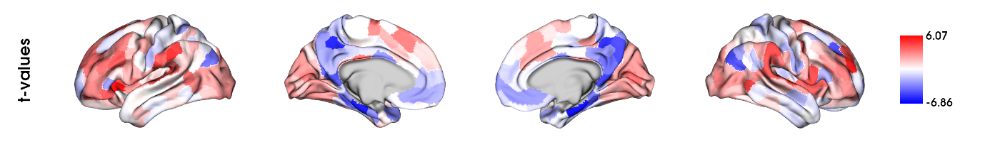

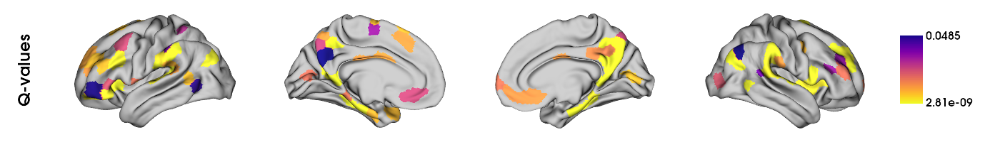

In [132]:
plots_to_display = plot_slm_results(slm_SEX_age_icv)
display(*plots_to_display)

Scatterplot of Gradient 1 eigenvalues (from mean matrix) and t-values for sex contrast in main model (controling for age and icv)

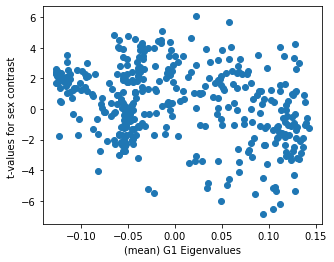

In [133]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(mean_grad.gradients_[:, 0], slm_SEX_age_icv.t[0])

ax.set_xlabel('(mean) G1 Eigenvalues')
ax.set_ylabel('t-values for sex contrast ')

plt.show()

# TO DO Visualizing sex differences in gradients

## TO DO: Goal is to replicate this figure from Hong et al https://www.nature.com/articles/s41467-019-08944-1/figures/3

**NEXT STEPS:**
- Put Males and Females side by side
- Try quiver plots to show movements of t values https://pythonforundergradengineers.com/quiver-plot-with-matplotlib-and-jupyter-notebooks.html

Preparing colorcoding for plots

**TO DO: FIND OTHER COLOR NAMES??** could only find sns color maps but not individual names...

In [109]:
# making an array with yeo network labels (names instead of numbers)
yeo7_networks_array_labels = []

for i in yeo7_networks:
    if i == '1':
        yeo7_networks_array_labels.append('visual')
    elif i == '2':
        yeo7_networks_array_labels.append('sensory motor')
    elif i == '3':
        yeo7_networks_array_labels.append('dorsal attention')
    elif i == '4':
        yeo7_networks_array_labels.append('ventral attention')
    elif i == '5':
        yeo7_networks_array_labels.append('limbic')
    elif i == '6':
        yeo7_networks_array_labels.append('fronto parietal')
    elif i == '7':
        yeo7_networks_array_labels.append('DMN')

yeo7_networks_array_labels = np.asarray(yeo7_networks_array_labels)


# dictionary color palette emphasizing visual, sensory motore, and DMN networks
palette_visual_sensmotor_DMN = {"visual":"tab:cyan",
                                "sensory motor":"tab:orange", 
                                "DMN":"tab:purple",
                                
                                "dorsal attention":"tab:grey",
                                "ventral attention":"tab:grey",
                                "limbic":"tab:grey",
                                "fronto parietal":"tab:grey"}

Color-coding all networks

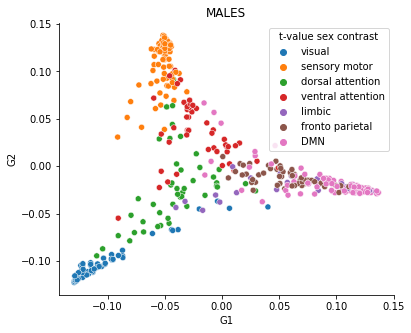

In [110]:
fig, ax = plt.subplots(figsize=(6,5));
ax = sns.scatterplot(x=mean_grad_M.gradients_[:,0],  # all rows (400 parces), first column (G1)
                     y=mean_grad_M.gradients_[:,1],  # all rows (400 parces), second column (G2)
                     hue=yeo7_networks_array_labels,  # gives color coding based on yeo networks
                     #palette=sns.color_palette("muted", as_cmap=True), 
                     legend=True, ax=ax);
ax.set_xlabel('G1');
ax.set_ylabel('G2');
ax.set_title("MALES")
ax.spines['right'].set_visible(False);
ax.spines['top'].set_visible(False);
plt.legend(title='t-value sex contrast')
plt.show(ax)

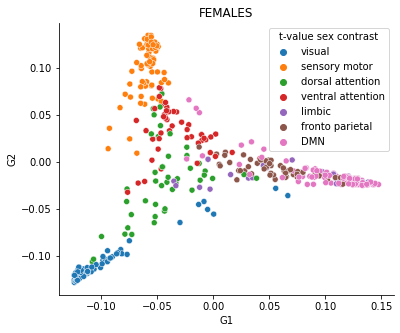

In [111]:
fig, ax = plt.subplots(figsize=(6,5));
ax = sns.scatterplot(x=mean_grad_F.gradients_[:,0],  # all rows (400 parces), first column (G1)
                     y=mean_grad_F.gradients_[:,1],  # all rows (400 parces), second column (G2)
                     hue=yeo7_networks_array_labels,  # gives color coding based on yeo networks
                     #palette=sns.color_palette("muted", as_cmap=True), 
                     legend=True, ax=ax);
ax.set_xlabel('G1');
ax.set_ylabel('G2');
ax.set_title("FEMALES")
ax.spines['right'].set_visible(False);
ax.spines['top'].set_visible(False);
plt.legend(title='t-value sex contrast')
plt.show(ax)

Color-coding only networks at G1-G2 extremities (visual, sensorymotor, DMN)

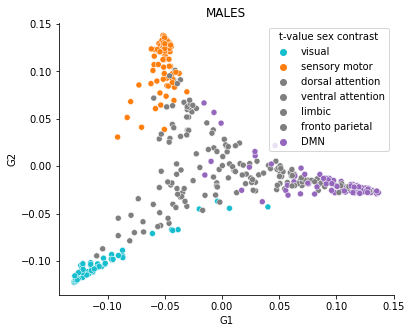

In [112]:
fig, ax = plt.subplots(figsize=(6,5));
ax = sns.scatterplot(x=mean_grad_M.gradients_[:,0],  # all rows (400 parces), first column (G1)
                     y=mean_grad_M.gradients_[:,1],  # all rows (400 parces), second column (G2)
                     hue=yeo7_networks_array_labels,  # gives color coding based on yeo networks (only visual, sensory motore, DMN)
                     palette=palette_visual_sensmotor_DMN,                    
                     legend=True, ax=ax);
ax.set_xlabel('G1');
ax.set_ylabel('G2');
ax.set_title("MALES")
ax.spines['right'].set_visible(False);
ax.spines['top'].set_visible(False);
plt.legend(title='t-value sex contrast')
plt.show(ax)

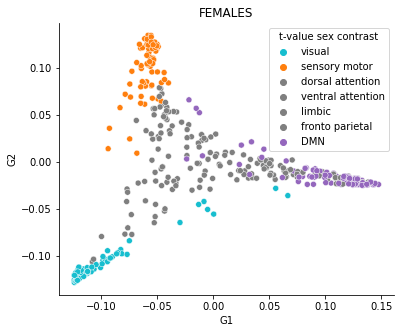

In [113]:
fig, ax = plt.subplots(figsize=(6,5));
ax = sns.scatterplot(x=mean_grad_F.gradients_[:,0],  # all rows (400 parces), first column (G1)
                     y=mean_grad_F.gradients_[:,1],  # all rows (400 parces), second column (G2)
                     hue=yeo7_networks_array_labels,  # gives color coding based on yeo networks (only visual, sensory motore, DMN)
                     palette=palette_visual_sensmotor_DMN,
                     legend=True, ax=ax);
ax.set_xlabel('G1');
ax.set_ylabel('G2');
ax.set_title("FEMALES")
ax.spines['right'].set_visible(False);
ax.spines['top'].set_visible(False);
plt.legend(title='t-value sex contrast')
plt.show(ax)

Scatter plots of the first 2 gradients, color coding shows t-values (**but categorical colorcoding -> NEED TO FIND A WAY TO DO IT CONTINOUS!!**)

*this was asked by Sofie, not replication of Hong et al.*

**TO DO: TROUBLESHOOTING CONTINOUS COLOR CODING**

- asked sofie if Hong's exact code is available anywhere
- can try using a different package for scatter (and not sns, e.g. https://stackoverflow.com/questions/12965075/matplotlib-scatter-plot-colour-as-function-of-third-variable specifically look for packages that will allow to color as a function of a third CONTINUOUS variable)
- ask Bin / Seyma for help?


**TO DO: WHEN FOUND A SOLUTION, ALSO EDIT THESE G1/G2 SCATTERPLOTS WITH COLORCODING BASED ON G3 (in building the gradients, both for full and unrelated sample replication)**

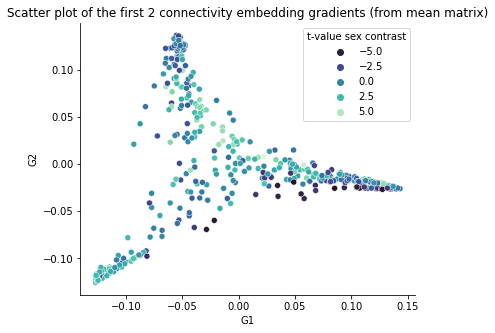

In [206]:
fig, ax = plt.subplots(figsize=(6,5));
ax = sns.scatterplot(x=mean_grad.gradients_[:,0],  # all rows (400 parces), first column (G1)
                     y=mean_grad.gradients_[:,1],  # all rows (400 parces), second column (G2)
                     hue=slm_SEX_age_icv.t[0],  # gives color coding based on t value of sex contrast (main model including age, sex, icv)
                     palette=sns.color_palette("mako", as_cmap=True), 
                     legend=True, ax=ax);
ax.set_xlabel('G1');
ax.set_ylabel('G2');
ax.set_title("Scatter plot of the first 2 connectivity embedding gradients (from mean matrix)")
ax.spines['right'].set_visible(False);
ax.spines['top'].set_visible(False);
plt.legend(title='t-value sex contrast')
plt.show(ax)

https://stackoverflow.com/questions/44641669/scatterplot-with-point-colors-representing-a-continuous-variable-in-seaborn-face problem of categorical coloring with hue >> solve to make continuous

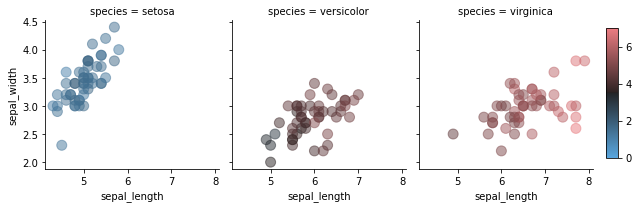

In [49]:
iris = sns.load_dataset('iris')
g = sns.FacetGrid(iris, col='species', palette = 'seismic')

def facet_scatter(x, y, c, **kwargs):
    """Draw scatterplot with point colors from a faceted DataFrame columns."""
    kwargs.pop("color")
    plt.scatter(x, y, c=c, **kwargs)

vmin, vmax = 0, 7
cmap = sns.diverging_palette(240, 10, l=65, center="dark", as_cmap=True)

g = g.map(facet_scatter, 'sepal_length', 'sepal_width', "petal_length",
          s=100, alpha=0.5, vmin=vmin, vmax=vmax, cmap=cmap)

# Make space for the colorbar
g.fig.subplots_adjust(right=.92)

# Define a new Axes where the colorbar will go
cax = g.fig.add_axes([.94, .25, .02, .6])

# Get a mappable object with the same colormap as the data
points = plt.scatter([], [], c=[], vmin=vmin, vmax=vmax, cmap=cmap)

# Draw the colorbar
g.fig.colorbar(points, cax=cax)

##### GIVEN THE PROBLEM WITH CATEGORICAL COLOR CODING, WAS TRYING TO DO A CONTINUOUS ONE FOLLOWING MARGULIES' CODE

but the color component of it does't work (see error below) - the only difference here with this jointplot is the addition of the histogram on axes

In [50]:
sns.set(style="white")
sns.set_context("notebook", font_scale=1.5)

df = pd.DataFrame()
df['e0'] = np.array(mean_grad.gradients_[:,0])
df['e1'] = np.array(mean_grad.gradients_[:,1]) #* -1 # to reorient plot

In [51]:
import matplotlib.cm as cm
import matplotlib as mpl
# import matplotlib.pyplot as plt
# import pylab as plt
# from matplotlib.colors import ListedColormap
# mpl.rcParams['svg.fonttype'] = 'none'

norm_1 = mpl.colors.Normalize(vmin=df['e0'].min(), vmax=df['e0'].max())
cmap_1 = cm.Reds
map_1 = cm.ScalarMappable(norm=norm_1, cmap=cmap_1)

norm_2 = mpl.colors.Normalize(vmin=df['e1'].min(), vmax=df['e1'].max())
cmap_2 = cm.Greens
map_2 = cm.ScalarMappable(norm=norm_2, cmap=cmap_2)

norm_3 = mpl.colors.Normalize(vmin=df['e1'].max() * -1, vmax=df['e1'].min() * -1)
cmap_3 = cm.Blues
map_3= cm.ScalarMappable(norm=norm_3, cmap=cmap_3)

c = np.ones(map_1.to_rgba(df['e0']).shape)


a = df['e1'].copy()
a = a - a.min() 
a = a / a.max()
c[:,1] = a

a = df['e1'].copy() * -1
a = a - a.min() 
a = a / a.max()
c[:,2] = a

a = df['e0'].copy()
a = a - a.min() 
a = a / a.max()
c[:,0] = a
c[:,1] = c[:,1] * ((a - 1) *  -1)
c[:,2] = c[:,2] * ((a - 1) *  -1)

In [52]:
np.array(c)

array([[0.16589219, 0.10662289, 0.72748492, 1.        ],
       [0.59927073, 0.13959622, 0.26113305, 1.        ],
       [0.05849646, 0.04325878, 0.89824477, 1.        ],
       ...,
       [0.83238482, 0.07005999, 0.09755519, 1.        ],
       [0.95836653, 0.01590039, 0.02573307, 1.        ],
       [0.65085832, 0.14182363, 0.20731806, 1.        ]])

error
- use c argument if you want to feed numbers, use color argument if you want to feed words https://cumsum.wordpress.com/2021/09/19/matplotlibvalueerror-color-kwarg-must-be-an-color-or-sequence-of-color-specs-for-a-sequence-of-values-to-be-color-mapped-use-the-c-argument-instead/ 

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/seaborn/axisgrid.py:2182: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


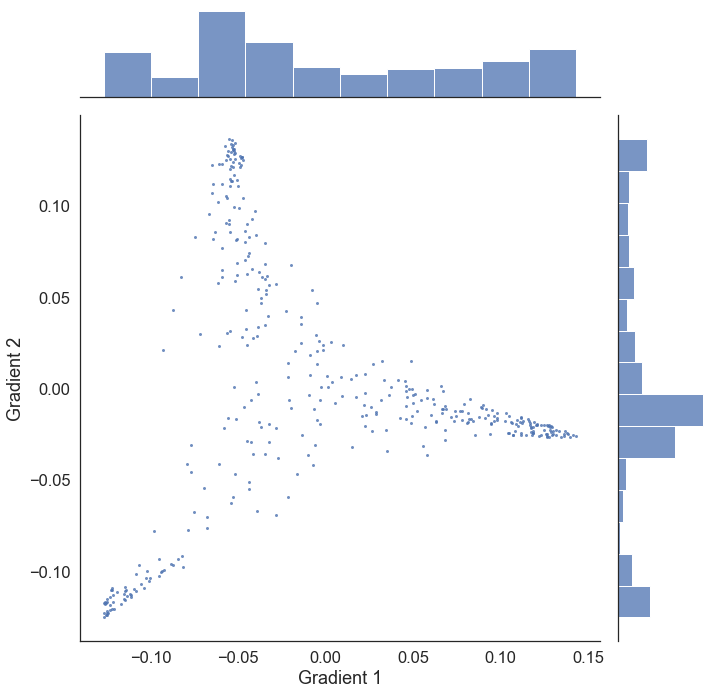

In [53]:
sns.set_context(font_scale=2)
g = sns.jointplot(x = 'e0', y = 'e1', data=df,
                  size=10, linewidth=0, marker='.', alpha=0.8,
                  

                  #c=np.array(c),  # ORIGINAL ARGUMENT
                  
                  #label='big',                   
                  #ylim = [np.min(df['e0']) - 0.5, np.max(df['e0']) + 0.5], 
                  #xlim = [np.min(df['e1']) - 0.5, np.max(df['e1']) + 0.5],
                  #stat_func=None)
                  )

g.set_axis_labels('Gradient 1', 'Gradient 2')

Margulies original code https://github.com/NeuroanatomyAndConnectivity/gradient_analysis/blob/master/03_visualize_embeddings.ipynb

In [ ]:
sns.set(style="white")
sns.set_context("notebook", font_scale=1.5)

df = pd.DataFrame()
df['e0'] = np.array(emb[range(cortLen),0])
df['e1'] = np.array(emb[range(cortLen),1]) * -1 # to reorient plot

In [ ]:
import matplotlib.cm as cm

norm_1 = mpl.colors.Normalize(vmin=df['e0'].min(), vmax=df['e0'].max())
cmap_1 = cm.Reds
map_1 = cm.ScalarMappable(norm=norm_1, cmap=cmap_1)

norm_2 = mpl.colors.Normalize(vmin=df['e1'].min(), vmax=df['e1'].max())
cmap_2 = cm.Greens
map_2 = cm.ScalarMappable(norm=norm_2, cmap=cmap_2)

norm_3 = mpl.colors.Normalize(vmin=df['e1'].max() * -1, vmax=df['e1'].min() * -1)
cmap_3 = cm.Blues
map_3= cm.ScalarMappable(norm=norm_3, cmap=cmap_3)

c = np.ones(map_1.to_rgba(df['e0']).shape)

a = df['e1'].copy()
a = a - a.min() 
a = a / a.max()
c[:,1] = a

a = df['e1'].copy() * -1
a = a - a.min() 
a = a / a.max()
c[:,2] = a

a = df['e0'].copy()
a = a - a.min() 
a = a / a.max()
c[:,0] = a
c[:,1] = c[:,1] * ((a - 1) *  -1)
c[:,2] = c[:,2] * ((a - 1) *  -1)

In [ ]:
sns.set_context(font_scale=2)
g = (sns.jointplot('e1', 'e0', 
                   data=df, 
                   size=10, label='big', linewidth=0, marker='.', c=np.array(c), alpha=0.8,
                   ylim = [np.min(df['e0']) - 0.5, np.max(df['e0']) + 0.5], 
                   xlim=[np.min(df['e1']) - 0.5, np.max(df['e1']) + 0.5],
                   stat_func=None).set_axis_labels('Gradient 2', 'Gradient 1'))

## SEX ANALYSES CODE RESUMES HERE

### Gradient 2

In [134]:
### model terms, contrast (sex differences), main model -> already defined for Gradient 1


### fitting the main model

# sex effects including sex, age, and icv in model
slm_SEX_age_icv = SLM(
    model_sex_age_icv,
    contrast = contrast_sex,
    correction=["fdr"],
    two_tailed=True,
)
slm_SEX_age_icv.fit(array_aligned_G2)

In [135]:
slm_SEX_age_icv.Q

array([0.15484146, 0.17334599, 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       0.75336076, 1.        , 1.        , 1.        , 1.        ,
       0.98245988, 1.        , 1.        , 1.        , 0.76068152,
       1.        , 1.        , 1.        , 0.67871986, 1.        ,
       1.        , 1.        , 1.        , 1.        , 0.12818556,
       1.        , 1.        , 0.06004432, 1.        , 1.        ,
       1.        , 1.        , 0.38807332, 0.46702642, 0.91709249,
       1.        , 1.        , 0.23917297, 1.        , 1.        ,
       1.        , 1.        , 1.        , 0.7777411 , 1.        ,
       0.26274523, 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 0.60919547,
       1.        , 1.        , 1.        , 1.        , 0.62935862,
       1.        , 1.        , 1.        , 1.        , 1.     

In [136]:
sig = []
for i in range(len(slm_SEX_age_icv.Q)):
    if slm_SEX_age_icv.Q[i] < 0.05:
        sig.append(slm_SEX_age_icv.Q)
        
print(f"Number of significant parcels: {len(sig)}")

Number of significant parcels: 17


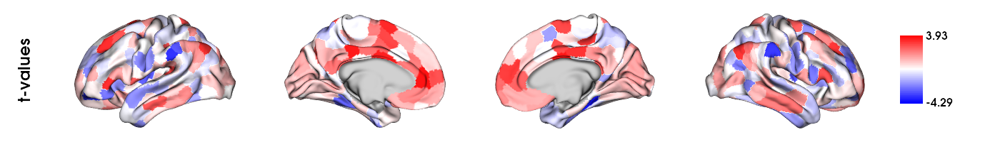

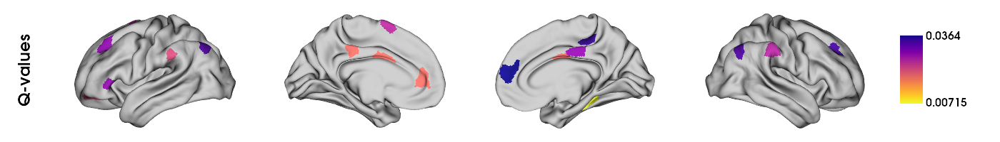

In [137]:
plots_to_display = plot_slm_results(slm_SEX_age_icv)
display(*plots_to_display)

Scatterplot of Gradient 2 eigenvalues (from mean matrix) and t-values for sex contrast in main model (controling for age and icv)

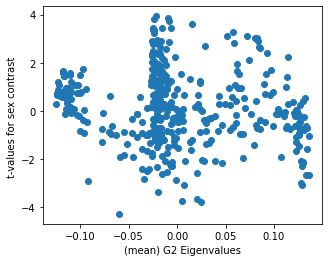

In [138]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(mean_grad.gradients_[:, 1], slm_SEX_age_icv.t[0])

ax.set_xlabel('(mean) G2 Eigenvalues')
ax.set_ylabel('t-values for sex contrast ')

plt.show()

### Gradient 3

In [139]:
### model terms, contrast (sex differences), main model -> already defined for Gradient 1


### fitting the main model

# sex effects including sex, age, and icv in model
slm_SEX_age_icv = SLM(
    model_sex_age_icv,
    contrast = contrast_sex,
    correction=["fdr"],
    two_tailed=True,
)
slm_SEX_age_icv.fit(array_aligned_G3)

In [140]:
slm_SEX_age_icv.Q

array([1.00000000e+00, 1.44879949e-02, 5.27354852e-01, 1.00000000e+00,
       5.51140575e-01, 5.55975373e-01, 1.00000000e+00, 6.98069998e-01,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       4.72644892e-01, 6.65629526e-01, 1.00000000e+00, 5.74141186e-01,
       1.00000000e+00, 7.90728640e-01, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 6.32122803e-01, 3.55284796e-01, 1.00000000e+00,
       1.00000000e+00, 8.46993517e-01, 5.55975373e-01, 9.38963464e-01,
       1.00000000e+00, 1.22186979e-01, 8.30159133e-01, 1.00000000e+00,
       5.27354852e-01, 1.00000000e+00, 1.35111498e-02, 5.51140575e-01,
       9.58558473e-01, 5.51140575e-01, 6.64964935e-01, 5.00695546e-01,
       1.00000000e+00, 1.00000000e+00, 4.27820571e-02, 7.36292143e-01,
       9.38278380e-02, 1.00000000e+00, 1.32829409e-01, 1.49002851e-01,
       6.32930743e-01, 1.00000000e+00, 2.07322608e-01, 1.00000000e+00,
       2.61176216e-01, 4.96462710e-02, 6.65629526e-01, 1.00000000e+00,
      

In [141]:
sig = []
for i in range(len(slm_SEX_age_icv.Q)):
    if slm_SEX_age_icv.Q[i] < 0.05:
        sig.append(slm_SEX_age_icv.Q)
        
print(f"Number of significant parcels: {len(sig)}")

Number of significant parcels: 48


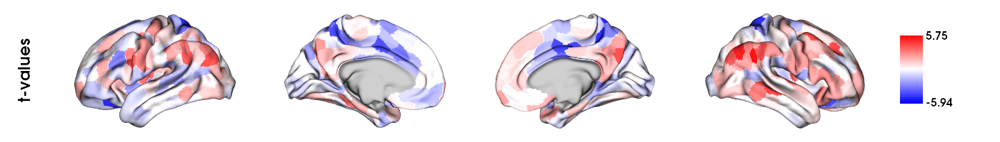

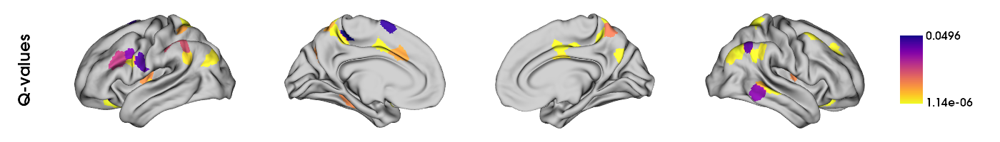

In [142]:
plots_to_display = plot_slm_results(slm_SEX_age_icv)
display(*plots_to_display)

Scatterplot of Gradient 3 eigenvalues (from mean matrix) and t-values for sex contrast in main model (controling for age and icv)

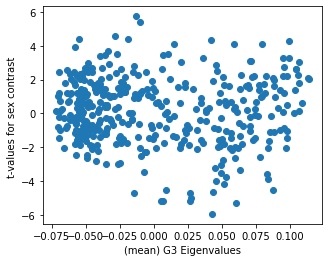

In [143]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(mean_grad.gradients_[:, 2], slm_SEX_age_icv.t[0])

ax.set_xlabel('(mean) G3 Eigenvalues')
ax.set_ylabel('t-values for sex contrast ')

plt.show()

# Exploratory Analyses

## What may be driving sex effects in G1 eigenvalues

### Sex effects - Exploratory 

Manipulating the inclusion of age/ICV in the model which lead to defining the main model

In [144]:
### model terms and sex contrast have already been created above


### defining the models 

## exploratory models (control variables)
model_sex_age = term_sex + term_age
model_sex_icv = term_sex + term_icv
model_sex = term_sex


## exploratory models (interaction term as control variable)
model_sex_age_icv_int = term_sex + term_age + term_age * term_sex + term_icv
model_sex_age_int = term_sex + term_age + term_age * term_sex



### fitting the models

## exploratory models (control variables)

# sex effects including sex and age in model
slm_SEX_age = SLM(
    model_sex_age,
    contrast = contrast_sex,
    correction=["fdr"],
    two_tailed=True,
)
slm_SEX_age.fit(array_aligned_G1)


# sex effects including sex and icv in model
slm_SEX_icv = SLM(
    model_sex_icv,
    contrast = contrast_sex,
    correction=["fdr"],
    two_tailed=True,
)
slm_SEX_icv.fit(array_aligned_G1)


# sex effects (no control variables)
slm_SEX = SLM(
    model_sex,
    contrast = contrast_sex,
    correction=["fdr"],
    two_tailed=True,
)
slm_SEX.fit(array_aligned_G1)



## exploratory models (interaction term as control variable)

# sex effects including sex, age, sex*age and icv in model
slm_SEX_age_icv_int = SLM(
    model_sex_age_icv_int,
    contrast = contrast_sex,
    correction=["fdr"],
    two_tailed=True,
)
slm_SEX_age_icv_int.fit(array_aligned_G1)


# sex effects including sex, age and sex*age in model
slm_SEX_age_int = SLM(
    model_sex_age_int,
    contrast = contrast_sex,
    correction=["fdr"],
    two_tailed=True,
)
slm_SEX_age_int.fit(array_aligned_G1)

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainstat/stats/_linear_model.py:461: UserWarning: Did you forget an error term, I? :-)
  warnings.warn("Did you forget an error term, I? :-)")
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainstat/stats/_t_test.py:51: UserWarning: Contrast is not in the model :-( 
  warnings.warn("Contrast is not in the model :-( ")


##### Exploratory models (control variables)

Exploratory: sex effects including sex and age in model

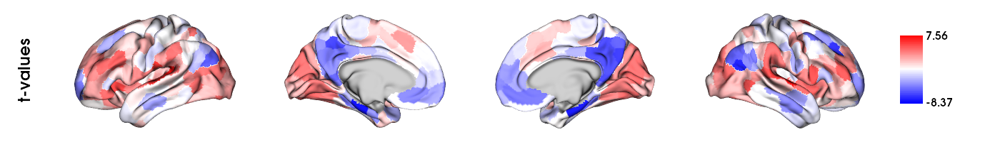

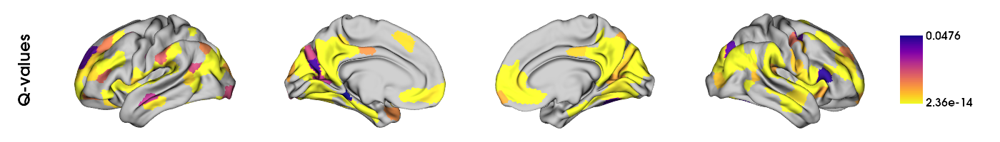

In [145]:
plots_to_display = plot_slm_results(slm_SEX_age)
display(*plots_to_display)

Exploratory: sex effects including sex and icv in model

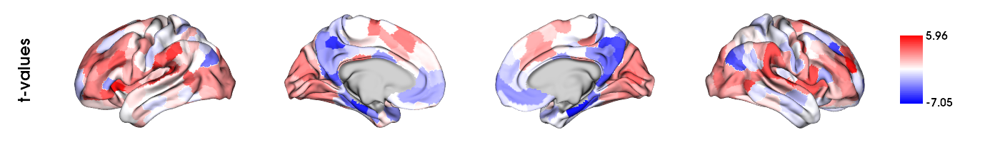

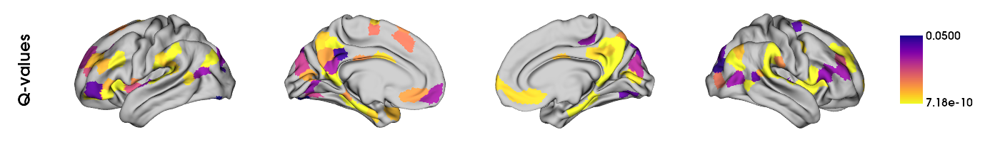

In [146]:
plots_to_display = plot_slm_results(slm_SEX_icv)
display(*plots_to_display)

Exploratory: sex effects (no control variables)

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/utils.py:303: RuntimeWarning: All-NaN axis encountered
  a, b = np.nanmin(x), np.nanmax(x)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/utils.py:367: RuntimeWarning: All-NaN slice encountered
  specs['min'][:] = np.nanmin(specs['min'], axis=ax, keepdims=True)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/utils.py:368: RuntimeWarning: All-NaN slice encountered
  specs['max'][:] = np.nanmax(specs['max'], axis=ax, keepdims=True)


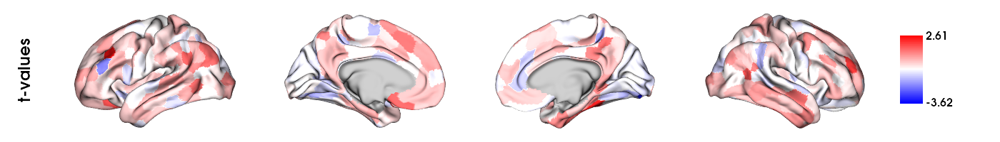

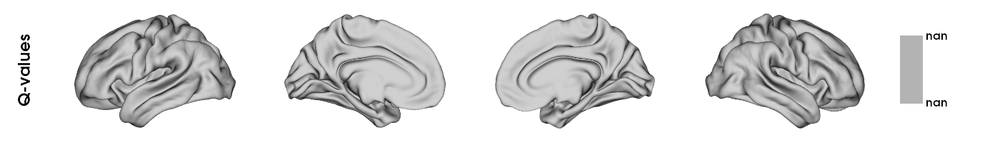

In [147]:
plots_to_display = plot_slm_results(slm_SEX)
display(*plots_to_display)

##### Exploratory models (interaction term as control variable)

Exploratory: sex effects including sex, age, sex*age and icv in model

**this is the model that corresponds to the original main model** (same variables + interaction term, but testing sex*age interaction effect instead of sex sex effect)

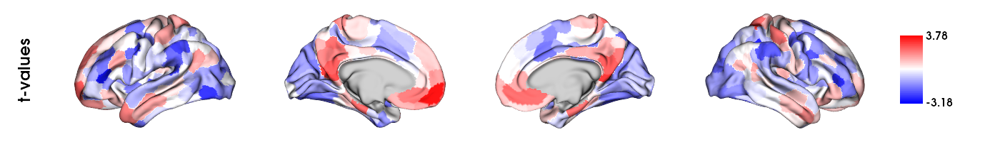

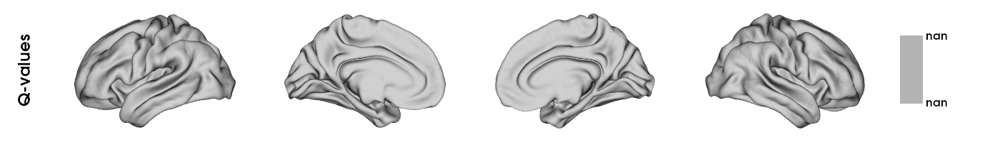

In [148]:
plots_to_display = plot_slm_results(slm_SEX_age_icv_int)
display(*plots_to_display)

Exploratory: sex effects including sex, age and sex*age in model

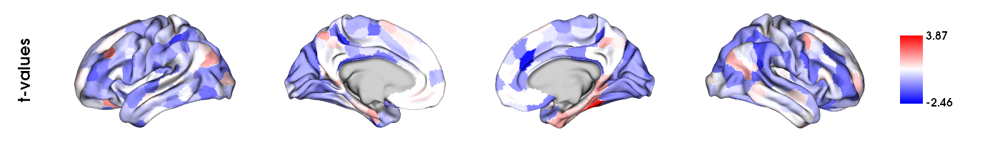

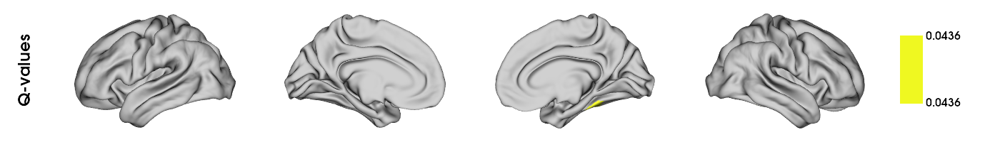

In [149]:
plots_to_display = plot_slm_results(slm_SEX_age_int)
display(*plots_to_display)

### Sex effects - Exploratory (including height and weight in the model as potential confounding effects)

Rationale for studying these: relevance of ICV in model (changes in sex differences results when including vs excluding ICV) - to check that these changes in results are not driven by weight and height of subjects

In [150]:
# making a dataframe that only contains the relevant variables for Height/Weight analyses (including Gender, Age_in_Yrs, FS_IntraCranial_Vol)
df_height_weight = [merged_demographics_cleaned.Height, merged_demographics_cleaned.Weight, merged_demographics_cleaned.Gender, merged_demographics_cleaned.Age_in_Yrs, merged_demographics_cleaned.FS_IntraCranial_Vol]
df_height_weight = pd.DataFrame(df_height_weight).T


# identifying the positions (for indexing) of subjects with NaNs for Height (normally I should do the same for Weight as well but I checked and it's the same subject who has NaNs for Height and Weight)
position = 0
nan_subjects_positions = []

for i in df_height_weight.Height:
    if np.isnan(i):
        nan_subjects_positions.append(position)
    position += 1


# removing rows of subjects with NaNs in Height/Weight dataframe
df_height_weight.drop(df_height_weight.index[nan_subjects_positions], inplace=True)



# creating a copy of the G1 array which will contain the "cleaned" version excluding subjects with NaNs for Height/Weight
array_aligned_G1_cleaned_na_height_weight = array_aligned_G1.copy()

# deleting the row (axis = 0) of the subject with NaNs (based on position) 
array_aligned_G1_cleaned_na_height_weight = np.delete(array_aligned_G1_cleaned_na_height_weight, nan_subjects_positions, axis=0)

In [151]:
# defining terms (and making new "corrected" versions of the terms from sex, age and ICV which include 1013 subjects instead of 1014 (removed subject that had NaNs for Height/Weight)
term_height = FixedEffect(df_height_weight.Height.astype(int))
term_weight = FixedEffect(df_height_weight.Weight.astype(int))

term_sex_cor = FixedEffect(df_height_weight.Gender)
term_age_cor = FixedEffect(df_height_weight.Age_in_Yrs.astype(int))
term_icv_cor = FixedEffect(df_height_weight.FS_IntraCranial_Vol.astype(int))

# defining contrast to test: sex differences (new "corrected" version as above)
contrast_sex_cor = (df_height_weight.Gender == "M").astype(int) - (df_height_weight.Gender == "F").astype(int)  # makes M = 1 and F = -1

# defining models
model_sex_age_height = term_sex_cor + term_age_cor + term_height
model_sex_age_weight = term_sex_cor + term_age_cor + term_weight
model_sex_age_height_weight = term_sex_cor + term_age_cor + term_height + term_weight
model_sex_age_icv_height = term_sex_cor + term_age_cor + term_icv_cor + term_height
model_sex_age_icv_weight = term_sex_cor + term_age_cor + term_icv_cor + term_weight
model_sex_age_icv_height_weight = term_sex_cor + term_age_cor + term_icv_cor + term_height + term_weight

In [152]:
# fitting the models

# sex effects controling for age and height
slm_SEX_age_height = SLM(
    model_sex_age_height,
    contrast = contrast_sex_cor,
    correction=["fdr"],
    two_tailed=True,
)

# sex effects controling for age and weight
slm_SEX_age_weight = SLM(
    model_sex_age_weight,
    contrast = contrast_sex_cor,
    correction=["fdr"],
    two_tailed=True,
)

# sex effects controling for age, height and weight
slm_SEX_age_height_weight = SLM(
    model_sex_age_height_weight,
    contrast = contrast_sex_cor,
    correction=["fdr"],
    two_tailed=True,
)

# sex effects controling for age, ICV and height
slm_SEX_age_icv_height = SLM(
    model_sex_age_icv_height,
    contrast = contrast_sex_cor,
    correction=["fdr"],
    two_tailed=True,
)

# sex effects controling for age, ICV and weight
slm_SEX_age_icv_weight = SLM(
    model_sex_age_icv_weight,
    contrast = contrast_sex_cor,
    correction=["fdr"],
    two_tailed=True,
)

# sex effects controling for age, ICV, height and weight
slm_SEX_age_icv_height_weight = SLM(
    model_sex_age_icv_height_weight,
    contrast = contrast_sex_cor,
    correction=["fdr"],
    two_tailed=True,
)




# sex effects controling for age and height
slm_SEX_age_height.fit(array_aligned_G1_cleaned_na_height_weight)

# sex effects controling for age and weight
slm_SEX_age_weight.fit(array_aligned_G1_cleaned_na_height_weight)

# sex effects controling for age, height and weight
slm_SEX_age_height_weight.fit(array_aligned_G1_cleaned_na_height_weight)

# sex effects controling for age, icv and height
slm_SEX_age_icv_height.fit(array_aligned_G1_cleaned_na_height_weight)

# sex effects controling for age, icv and weight
slm_SEX_age_icv_weight.fit(array_aligned_G1_cleaned_na_height_weight)

# sex effects controling for age, icv, height and weight
slm_SEX_age_icv_height_weight.fit(array_aligned_G1_cleaned_na_height_weight)

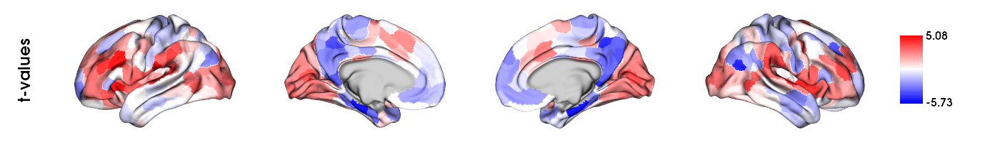

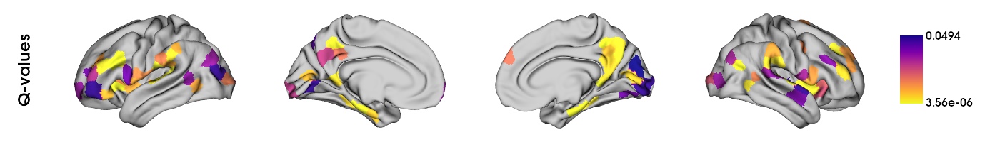

In [153]:
# sex contrast, controlling for sex, age, and height
plots_to_display = plot_slm_results(slm_SEX_age_height)
display(*plots_to_display)

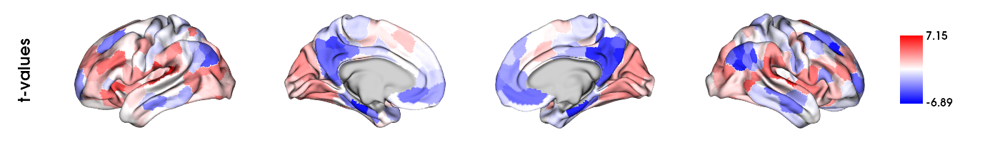

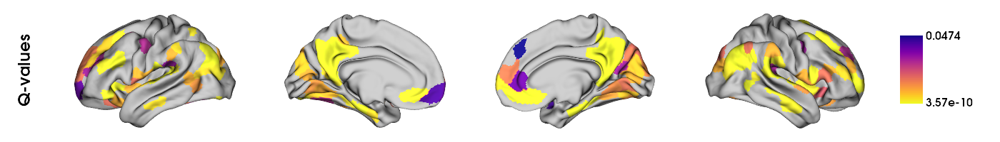

In [154]:
# sex contrast, controlling for sex, age, and weight
plots_to_display = plot_slm_results(slm_SEX_age_weight)
display(*plots_to_display)

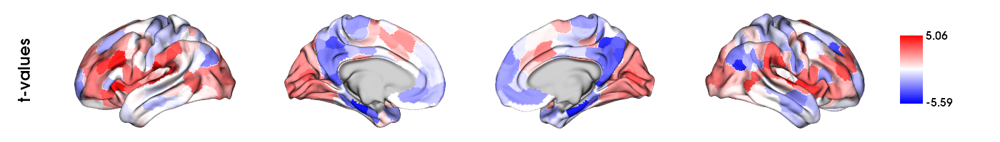

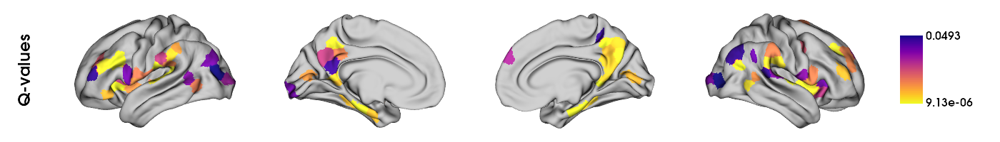

In [155]:
# sex contrast, controlling for sex, age, height and weight
plots_to_display = plot_slm_results(slm_SEX_age_height_weight)
display(*plots_to_display)

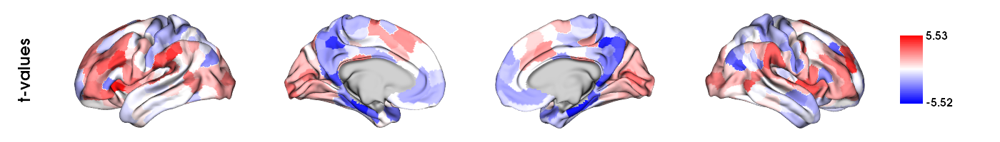

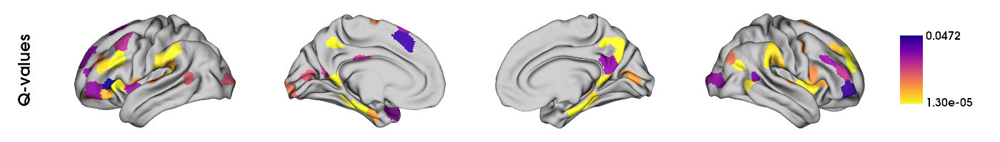

In [156]:
# sex contrast, controlling for sex, age, ICV and height
plots_to_display = plot_slm_results(slm_SEX_age_icv_height)
display(*plots_to_display)

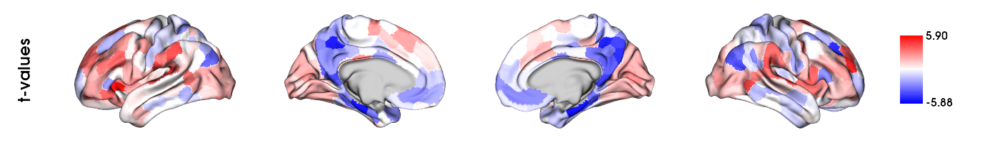

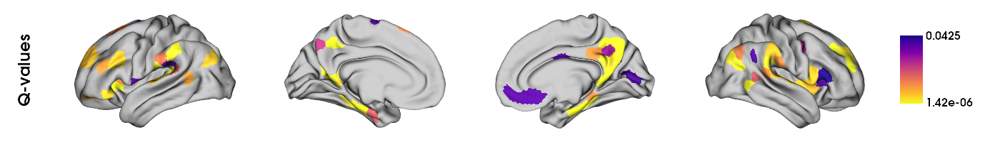

In [157]:
# sex contrast, controlling for sex, age, ICV and weight
plots_to_display = plot_slm_results(slm_SEX_age_icv_weight)
display(*plots_to_display)

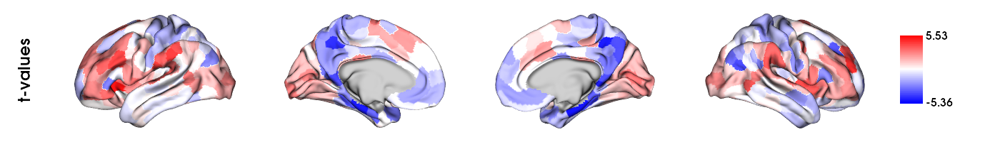

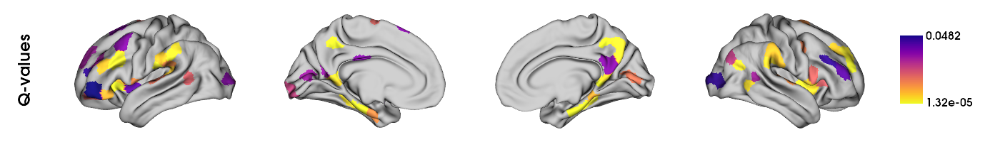

In [158]:
# sex contrast, controlling for sex, age, ICV, height and weight
plots_to_display = plot_slm_results(slm_SEX_age_icv_height_weight)
display(*plots_to_display)

**WE ARE COMPARING THE ABOVE RESULTS TO OUR MAIN MODEL TESTING FOR A SEX CONTRAST AND CONTROLLING FOR SEX, AGE, AND ICV:**

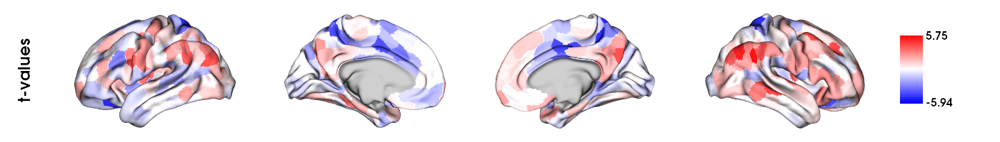

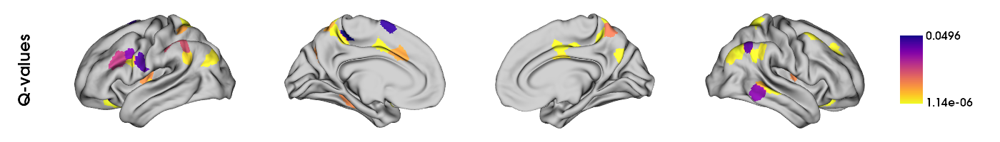

In [159]:
# sex contrast, controlling for sex, age, ICV, height and weight
plots_to_display = plot_slm_results(slm_SEX_age_icv)
display(*plots_to_display)

### Height and Weight effects - Exploratory 

Rationale for studying these: relevance of ICV in model (changes in sex differences results when including vs excluding ICV) - checking height and weight contrasts directly

In [160]:
# terms height, weight, sex_cor, age_cor, icv_cor already previously defined (cor include 1013 subjects instead of 1014 - i.e., removed subject that had NaNs for Height/Weight)

# defining contrasts to test: height differences & weight differences
contrast_height = df_height_weight.Height.astype(int)
contrast_weight = df_height_weight.Weight.astype(int)

# models already previously defined

In [161]:
# defining models
model_sex_age_height = term_sex_cor + term_age_cor + term_height
model_sex_age_weight = term_sex_cor + term_age_cor + term_weight
model_sex_age_height_weight = term_sex_cor + term_age_cor + term_height + term_weight
model_sex_age_icv_height = term_sex_cor + term_age_cor + term_icv_cor + term_height
model_sex_age_icv_weight = term_sex_cor + term_age_cor + term_icv_cor + term_weight
model_sex_age_icv_height_weight = term_sex_cor + term_age_cor + term_icv_cor + term_height + term_weight

In [162]:
# fitting the models

# height effects controling for sex, age and height
slm_sex_age_HEIGHT = SLM(
    model_sex_age_height,
    contrast = contrast_height,
    correction=["fdr"],
    two_tailed=True,
)

# weight effects controling for sex, age and weight
slm_sex_age_WEIGHT = SLM(
    model_sex_age_weight,
    contrast = contrast_weight,
    correction=["fdr"],
    two_tailed=True,
)

# height effects controling for sex, age, height and weight
slm_sex_age_HEIGHT_weight = SLM(
    model_sex_age_height_weight,
    contrast = contrast_height,
    correction=["fdr"],
    two_tailed=True,
)

# weight effects controling for sex, age, height and weight
slm_sex_age_height_WEIGHT = SLM(
    model_sex_age_height_weight,
    contrast = contrast_weight,
    correction=["fdr"],
    two_tailed=True,
)

# height effects controling for sex, age, ICV and height
slm_sex_age_icv_HEIGHT = SLM(
    model_sex_age_icv_height,
    contrast = contrast_height,
    correction=["fdr"],
    two_tailed=True,
)

# weight effects controling for sex, age, ICV and weight
slm_sex_age_icv_WEIGHT = SLM(
    model_sex_age_icv_weight,
    contrast = contrast_weight,
    correction=["fdr"],
    two_tailed=True,
)

# height effects controling for sex, age, ICV, height and weight
slm_sex_age_icv_HEIGHT_weight = SLM(
    model_sex_age_icv_height_weight,
    contrast = contrast_height,
    correction=["fdr"],
    two_tailed=True,
)

# weight effects controling for sex, age, ICV, height and weight
slm_sex_age_icv_height_WEIGHT = SLM(
    model_sex_age_icv_height_weight,
    contrast = contrast_weight,
    correction=["fdr"],
    two_tailed=True,
)



# height effects controling for sex, age and height
slm_sex_age_HEIGHT.fit(array_aligned_G1_cleaned_na_height_weight)

# weight effects controling for sex, age and weight
slm_sex_age_WEIGHT.fit(array_aligned_G1_cleaned_na_height_weight)

# height effects controling for sex, age, height and weight
slm_sex_age_HEIGHT_weight.fit(array_aligned_G1_cleaned_na_height_weight)

# weight effects controling for sex, age, height and weight
slm_sex_age_height_WEIGHT.fit(array_aligned_G1_cleaned_na_height_weight)

# height effects controling for sex, age, ICV and height
slm_sex_age_icv_HEIGHT.fit(array_aligned_G1_cleaned_na_height_weight)

# weight effects controling for sex, age, ICV and weight
slm_sex_age_icv_WEIGHT.fit(array_aligned_G1_cleaned_na_height_weight)

# height effects controling for sex, age, ICV, height and weight
slm_sex_age_icv_HEIGHT_weight.fit(array_aligned_G1_cleaned_na_height_weight)

# weight effects controling for sex, age, ICV, height and weight
slm_sex_age_icv_height_WEIGHT.fit(array_aligned_G1_cleaned_na_height_weight)

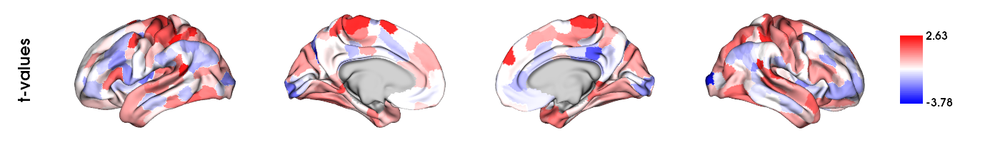

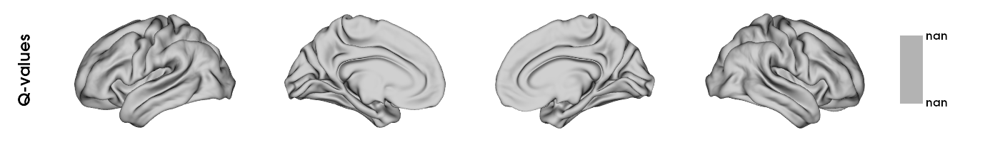

In [163]:
# height effects controling for sex, age and height
plots_to_display = plot_slm_results(slm_sex_age_HEIGHT)
display(*plots_to_display)

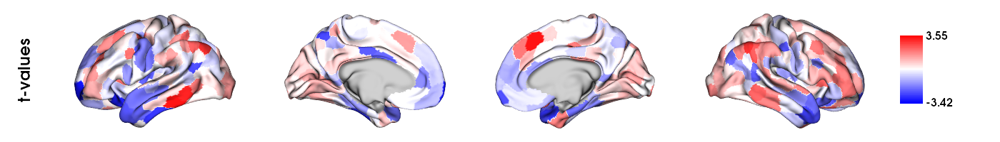

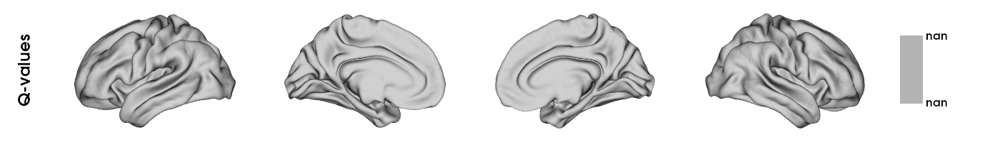

In [164]:
# weight effects controling for sex, age and weight
plots_to_display = plot_slm_results(slm_sex_age_WEIGHT)
display(*plots_to_display)

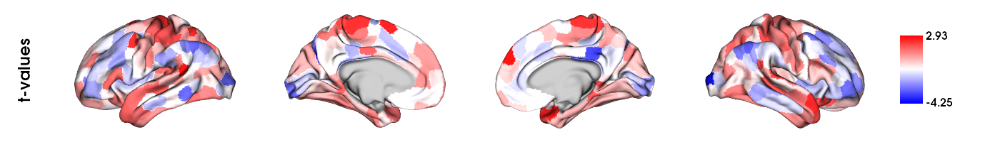

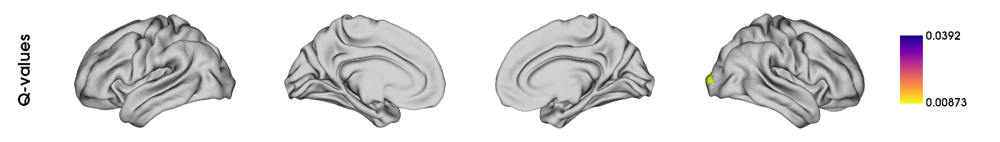

In [165]:
# height effects controling for sex, age, height and weight
plots_to_display = plot_slm_results(slm_sex_age_HEIGHT_weight)
display(*plots_to_display)

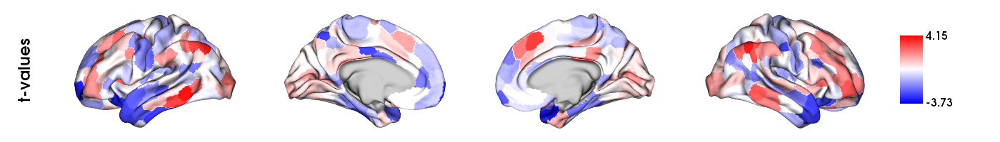

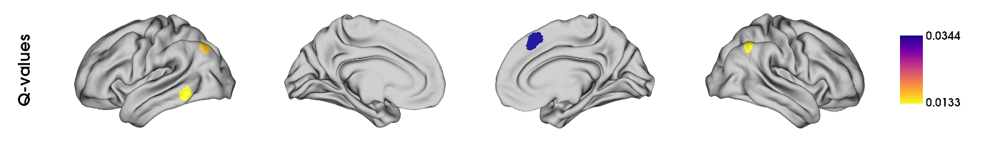

In [166]:
# weight effects controling for sex, age, height and weight
plots_to_display = plot_slm_results(slm_sex_age_height_WEIGHT)
display(*plots_to_display)

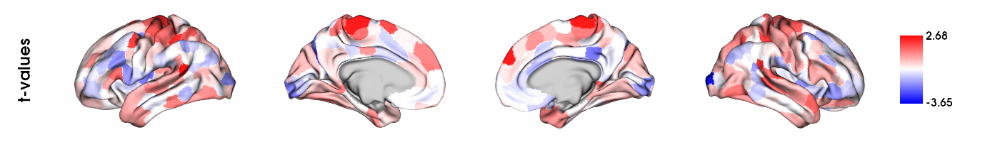

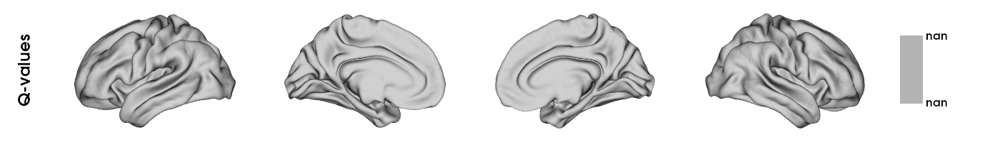

In [167]:
# height effects controling for sex, age, ICV and height
plots_to_display = plot_slm_results(slm_sex_age_icv_HEIGHT)
display(*plots_to_display)

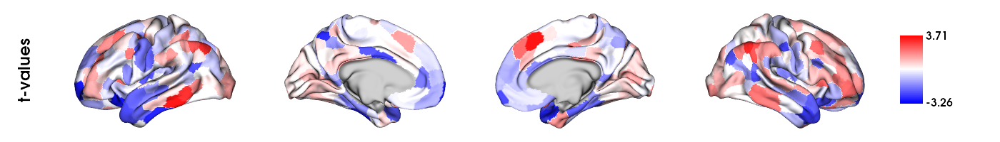

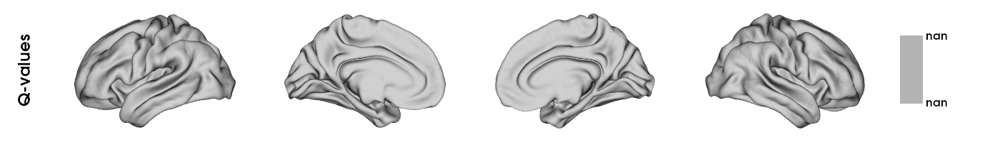

In [168]:
# weight effects controling for sex, age, ICV and weight
plots_to_display = plot_slm_results(slm_sex_age_icv_WEIGHT)
display(*plots_to_display)

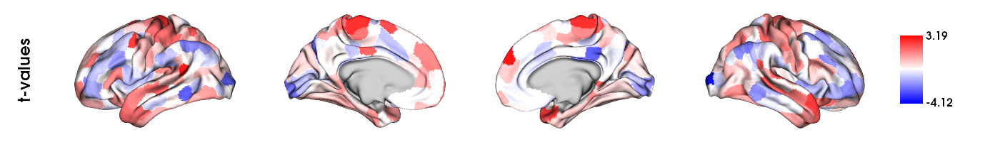

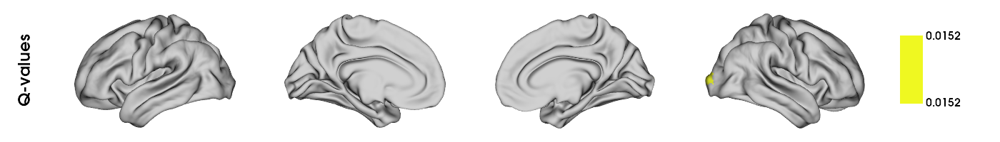

In [169]:
# height effects controling for sex, age, ICV, height and weight
plots_to_display = plot_slm_results(slm_sex_age_icv_HEIGHT_weight)
display(*plots_to_display)

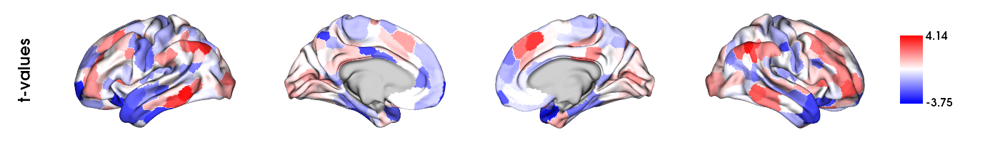

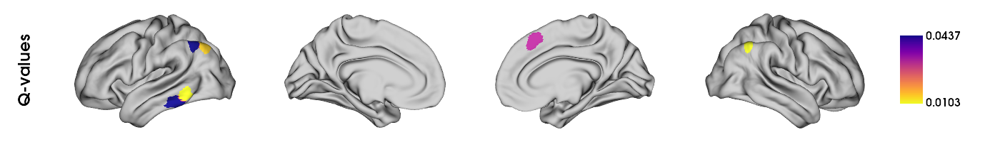

In [170]:
# weight effects controling for sex, age, ICV, height and weight
plots_to_display = plot_slm_results(slm_sex_age_icv_height_WEIGHT)
display(*plots_to_display)

### Age*Sex interaction effects - Exploratory
rationale for studying these: sex effects become all non-significant when controlling for sex*age interaction in the original models

testing for these interaction effects by using age as a continous variable as well as as a categorical variable

TO DO
- ask Bin how to then interpret the different age groups in results (he was the one suggesting to use age as categorical in the first place)
- decide if we want to use categorical or continuous age data (not so relevant for this here as we won't be reporting age*sex interaction effects but is something to think about if doing other analyses with age which need further interpretation (Bin says that categorical variable allows to interpret better via groups - see question above)

In [171]:
### creating model terms

term_ageCat2y = FixedEffect(merged_demographics_cleaned.age_2y_bins)  # age as a categorical variable (2-year bins)
term_age = FixedEffect(merged_demographics_cleaned.Age_in_Yrs)  # age as a continuous variable



### defining contrast to test: age*sex interaction

# contrast must have dtype = int64 (cannot be object, which is what may happen if you directly take a variable from the dataframe)
# contrast_sex defined earlier makes M = 1 and F = -1
contrast_sex_ageCat2y_int = merged_demographics_cleaned.age_2y_bins.astype('int64')*contrast_sex
contrast_sex_age_int = merged_demographics_cleaned.Age_in_Yrs.astype('int64')*contrast_sex



### defining models 
# NOTE: when calculating the effect of sex*age interaction, I get different results if I include the interaction term in the model and if I don't... 
# the correct way should be to include the interaction term in the model (not including it option is commented out here and below)

model_sex_ageCat2y_int = term_sex + term_ageCat2y + term_sex*term_ageCat2y
model_sex_age_int = term_sex + term_age + term_sex*term_age

model_sex_ageCat2y_int_icv = term_sex + term_ageCat2y + term_sex*term_ageCat2y + term_icv
model_sex_age_int_icv = term_sex + term_age + term_sex*term_age + term_icv



### fitting the models

# ageCat2y*sex interaction effect including sex, ageCat2y, and sex*ageCat2y in the model 
slm_SEX_AGECat2y_int = SLM(
    model_sex_ageCat2y_int,
    contrast = contrast_sex_ageCat2y_int,
    correction=["fdr"],
    two_tailed=True,
)
slm_SEX_AGECat2y_int.fit(array_aligned_G1)

# age*sex interaction effect including sex, age, and sex*age in the model 
slm_SEX_AGE_int = SLM(
    model_sex_age_int,
    contrast = contrast_sex_age_int,
    correction=["fdr"],
    two_tailed=True,
)
slm_SEX_AGE_int.fit(array_aligned_G1)



# ageCat2y*sex interaction effect including sex, ageCat2y in the model 
slm_SEX_AGECat2y_int_icv = SLM(
    model_sex_ageCat2y_int_icv,
    contrast = contrast_sex_ageCat2y_int,
    correction=["fdr"],
    two_tailed=True,
)
slm_SEX_AGECat2y_int_icv.fit(array_aligned_G1)

# age*sex interaction effect including sex, age in the model 
slm_SEX_AGE_int_icv = SLM(
    model_sex_age_int_icv,
    contrast = contrast_sex_age_int,
    correction=["fdr"],
    two_tailed=True,
)
slm_SEX_AGE_int_icv.fit(array_aligned_G1)

##### age*sex interaction effect including age and sex in model
(commented out because model should also include age*sex interaction term, as done below - and this yields different results)

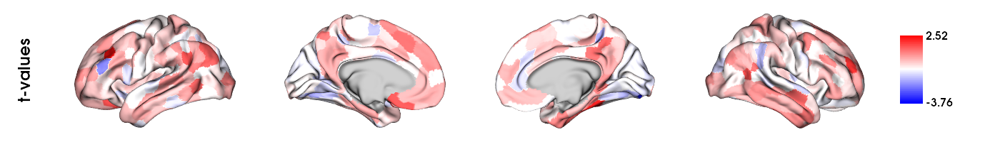

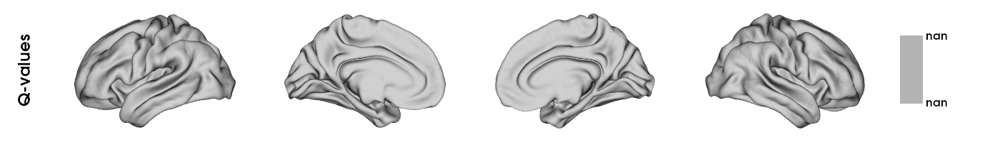

In [172]:
# age (categorical)*sex contrast, controlling for sex, age and sex*age interaction
plots_to_display = plot_slm_results(slm_SEX_AGECat2y_int)
display(*plots_to_display)

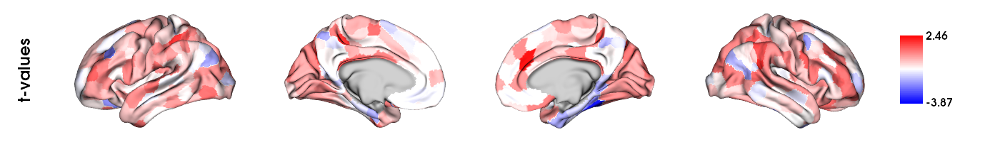

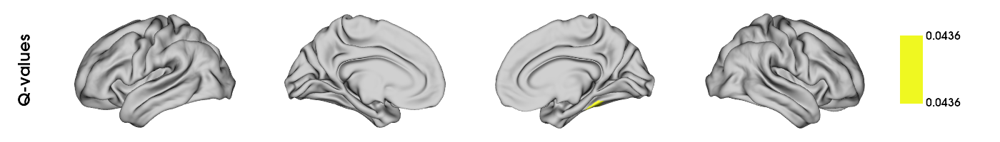

In [173]:
# age (continuous)*sex contrast, controlling for sex, age and sex*age interaction
plots_to_display = plot_slm_results(slm_SEX_AGE_int)
display(*plots_to_display)

**this should be the model to look at because includes ICV which is important for sex differences analyses**

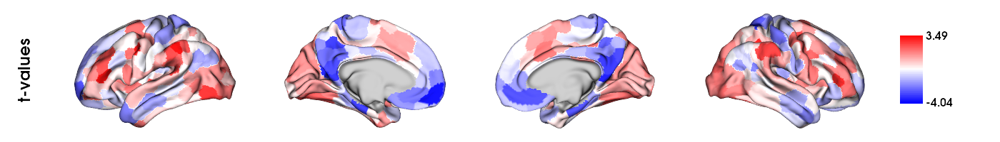

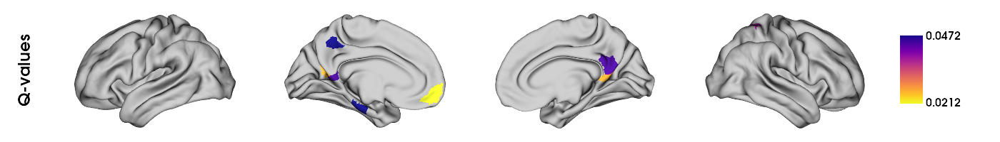

In [174]:
# age (categorical)*sex contrast, controlling for sex, age, icv and sex*age interaction
plots_to_display = plot_slm_results(slm_SEX_AGECat2y_int_icv)
display(*plots_to_display)

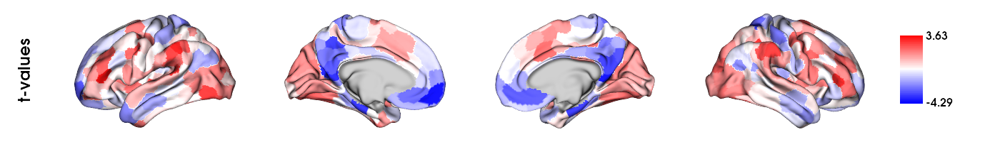

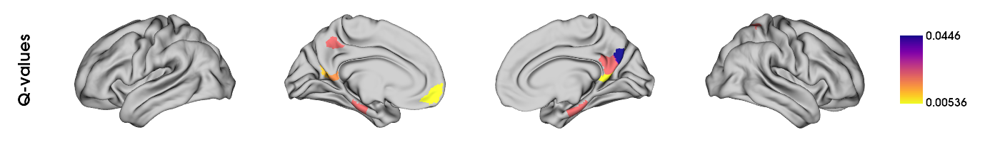

In [175]:
# age (continuous)*sex contrast, controlling for sex, age, icv and sex*age interaction
plots_to_display = plot_slm_results(slm_SEX_AGE_int_icv)
display(*plots_to_display)

# Replication Analyses

## Unrelated subjects

### Data

#### Descriptive

##### Making dataframes which only contain unrelated subjects
*For replication in unrelated sample*

Using restricted data first because it contains the family ID information, which we're basing this subsampling on

In [176]:
# creating a new df with Subject as first column (not included in indexing) in order to include Subject in the new unrelated dfs
merged_demographics_cleaned_notindexed = merged_demographics_cleaned.reset_index(drop=False)

merged_demographics_cleaned_unrel_1 = []
merged_demographics_cleaned_unrel_2 = []
merged_demographics_cleaned_unrel_3 = []
merged_demographics_cleaned_unrel_4 = []
merged_demographics_cleaned_unrel_5 = []
merged_demographics_cleaned_unrel_6 = []

for row in range(len(merged_demographics_cleaned_notindexed)):

    # if family ID not in a list, append entire row to that list (stepwise)
    
    if not any(merged_demographics_cleaned_notindexed.loc[row,'Family_ID'] in i for i in merged_demographics_cleaned_unrel_1):
        merged_demographics_cleaned_unrel_1.append(merged_demographics_cleaned_notindexed.loc[row,:].tolist())
    
    elif not any(merged_demographics_cleaned_notindexed.loc[row,'Family_ID'] in i for i in merged_demographics_cleaned_unrel_2):
        merged_demographics_cleaned_unrel_2.append(merged_demographics_cleaned_notindexed.loc[row,:].tolist())
        
    elif not any(merged_demographics_cleaned_notindexed.loc[row,'Family_ID'] in i for i in merged_demographics_cleaned_unrel_3):
        merged_demographics_cleaned_unrel_3.append(merged_demographics_cleaned_notindexed.loc[row,:].tolist())
        
    elif not any(merged_demographics_cleaned_notindexed.loc[row,'Family_ID'] in i for i in merged_demographics_cleaned_unrel_4):
        merged_demographics_cleaned_unrel_4.append(merged_demographics_cleaned_notindexed.loc[row,:].tolist())

    elif not any(merged_demographics_cleaned_notindexed.loc[row,'Family_ID'] in i for i in merged_demographics_cleaned_unrel_5):
        merged_demographics_cleaned_unrel_5.append(merged_demographics_cleaned_notindexed.loc[row,:].tolist())
    
    elif not any(merged_demographics_cleaned_notindexed.loc[row,'Family_ID'] in i for i in merged_demographics_cleaned_unrel_6):
        merged_demographics_cleaned_unrel_6.append(merged_demographics_cleaned_notindexed.loc[row,:].tolist())

Format the dataframe for replication sample: merged_demographics_cleaned_unrel_1

In [177]:
# turn list into a dataframe
merged_demographics_cleaned_unrel_1 = pd.DataFrame(merged_demographics_cleaned_unrel_1)

# rename the columns as found in original merged_demographics_cleaned dataframe
colnames = list(merged_demographics_cleaned.columns)  # make a list with the original column names
colnames.insert(0, 'Subject')  # insert column name Subject in position 1 of list because not currently indexed in unrel_1
merged_demographics_cleaned_unrel_1.columns = colnames  # change column names
merged_demographics_cleaned_unrel_1 = merged_demographics_cleaned_unrel_1.set_index('Subject')  

Unrestricted data -> making an unrelated sample 1 with the same subjects from merged_demographics_cleaned_unrel_1

In [178]:
# making a list of the subjects included in unrelated sample 1
unrel_1_sub_list = list(merged_demographics_cleaned_unrel_1.index)

# duplicate unrestricted_data
merged_demographics_cleaned_unrel_1 = merged_demographics_cleaned.copy()

for subID in merged_demographics_cleaned.index:
    if subID not in unrel_1_sub_list:
        merged_demographics_cleaned_unrel_1 = merged_demographics_cleaned_unrel_1.drop(subID)

**Demographics unrelated sample 1**

In [179]:
print(f"N = {len(merged_demographics_cleaned_unrel_1)}\n"
      f"{np.sum(merged_demographics_cleaned_unrel_1.Gender == 'F')} females, {np.sum(merged_demographics_cleaned_unrel_1.Gender == 'M')} males\n"
      f"Mean subject age: {np.mean(merged_demographics_cleaned_unrel_1.Age_in_Yrs):.2f}, SD: {np.std(merged_demographics_cleaned_unrel_1.Age_in_Yrs):.2f}, range: {np.min(merged_demographics_cleaned_unrel_1.Age_in_Yrs):.2f} - {np.max(merged_demographics_cleaned_unrel_1.Age_in_Yrs):.2f}\n"
      f"Mean ICV: {np.mean(merged_demographics_cleaned_unrel_1.FS_IntraCranial_Vol):.2f}, SD: {np.std(merged_demographics_cleaned_unrel_1.FS_IntraCranial_Vol):.2f}, range: {np.min(merged_demographics_cleaned_unrel_1.FS_IntraCranial_Vol):.2f} - {np.max(merged_demographics_cleaned_unrel_1.FS_IntraCranial_Vol):.2f}"
     )

N = 430
227 females, 203 males
Mean subject age: 28.58, SD: 3.68, range: 22.00 - 36.00
Mean ICV: 1585012.30, SD: 184149.45, range: 831208.30 - 1998044.32


#### Functional connectivity matrices (parcellation scheme: Schaefer 400, 7 networks) - averaged over 4 session & z-transformed

In [180]:
# list that contains the fc matrices of subjects in unrelated sample 1 in the form of 1 np array per subject
fc_matrices_400_unrel_1 = []

for e in path_list_fc_matrices:
    if '.csv' in e:  # need to do this because there is a hidden ipynb_checkpoints in the path_list_fc_matrices
        
        if int(e.partition(".")[0]) in unrel_1_sub_list:  # this partitions the subID.csv into a 3-tuple containing ('subID', '.', 'csv'), and I keep only the subID
        
            # reads csv file in the form of an array
            sub_matrix = np.genfromtxt(datadir+'/fc_matrices/schaefer_output/mean/'+e, delimiter=',')

            # add subject's matrix to the fc_matrices_400 list
            fc_matrices_400_unrel_1.append(sub_matrix)
       
            
print(f'Unrelated sample 1: N = {len(fc_matrices_400_unrel_1)}')

Unrelated sample 1: N = 430


### Constructing gradients

#### Calculate the mean matrix

In [181]:
mean_fc_matrix_unrel_1 = sum(fc_matrices_400_unrel_1)/len(fc_matrices_400_unrel_1)

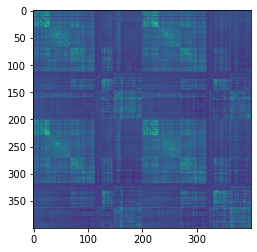

(400, 400)

In [182]:
plt.imshow(mean_fc_matrix_unrel_1)
plt.show()
mean_fc_matrix_unrel_1.shape

In [183]:
mean_fc_matrix_unrel_1

array([[0.        , 0.25196717, 0.37062089, ..., 0.04030587, 0.08386696,
        0.15736944],
       [0.25196717, 0.        , 0.19079537, ..., 0.04881088, 0.12148752,
        0.21519963],
       [0.37062089, 0.19079537, 0.        , ..., 0.08095006, 0.10767613,
        0.20864812],
       ...,
       [0.04030587, 0.04881088, 0.08095006, ..., 0.        , 0.28964766,
        0.18303776],
       [0.08386696, 0.12148752, 0.10767613, ..., 0.28964766, 0.        ,
        0.34757592],
       [0.15736944, 0.21519963, 0.20864812, ..., 0.18303776, 0.34757592,
        0.        ]])

#### Construct mean gradients 
(i.e., gradients for the mean matrix)

In [184]:
# GradientMaps function used to build the model parameters
mean_grad_unrel_1 = GradientMaps(n_components = 10, random_state = 0, approach = 'dm', kernel = 'normalized_angle')

# fit function used to compute the gradients
mean_grad_unrel_1.fit(mean_fc_matrix_unrel_1)

GradientMaps(kernel='normalized_angle', random_state=0)

Plot 3 first gradients of the mean matrix

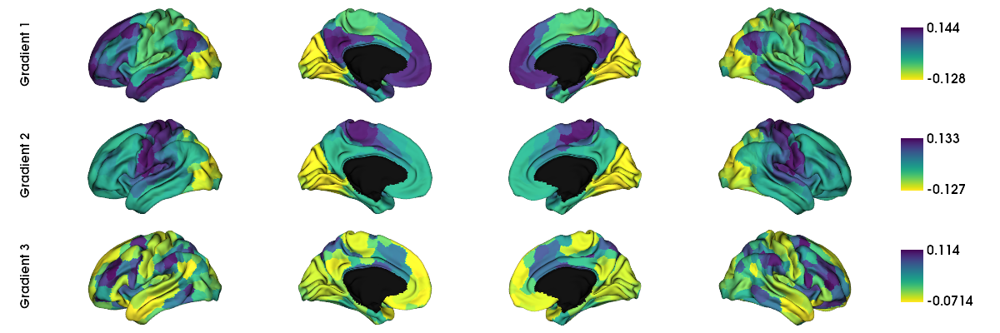

In [185]:
# defining labeling scheme and mask
labeling = load_parcellation('schaefer', scale=400, join=True)
surf_lh, surf_rh = load_conte69()

mask = labeling != 0


# list containing placeholders (None) for the number of gradients I want to plot
grad = [None] * 3

for i in range(3):
    # map the gradient to the parcels
    grad[i] = map_to_labels(mean_grad_unrel_1.gradients_[:, i], labeling, mask=mask, fill=np.nan)  # mean_grad contains 10 .gradients_ (1 gradient per column) - here I take all rows and individual select column based on gradient I want (first 3)

plot_hemispheres(surf_lh, surf_rh, array_name=grad, embed_nb = True, size=(1200, 400), cmap='viridis_r', color_bar=True, label_text=['Gradient 1', 'Gradient 2', 'Gradient 3'], zoom=1.55)

Variance explained by the 10 gradients

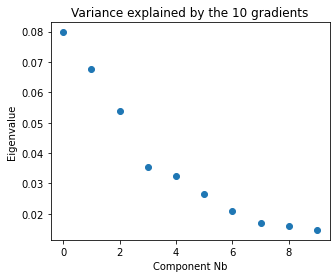

In [186]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(range(mean_grad_unrel_1.lambdas_.size), mean_grad_unrel_1.lambdas_)
ax.set_title("Variance explained by the 10 gradients")
ax.set_xlabel('Component Nb')
ax.set_ylabel('Eigenvalue')

plt.show()

In [187]:
# Scaled variance explained by individual gradients: lambda / total(i.e., sum lambdas) * 100 %
print(f"Total amount of variance explained by the {len(mean_grad_unrel_1.lambdas_)} gradients (uncorrected sum lambdas): {sum(mean_grad_unrel_1.lambdas_):.2f}\n")
print(f"Scaled variance explained by individual gradients:\nG1: {mean_grad_unrel_1.lambdas_[0]/sum(mean_grad_unrel_1.lambdas_)*100:.2f}%\nG2: {mean_grad_unrel_1.lambdas_[1]/sum(mean_grad_unrel_1.lambdas_)*100:.2f}%\nG3: {mean_grad_unrel_1.lambdas_[2]/sum(mean_grad_unrel_1.lambdas_)*100:.2f}%\n")

Total amount of variance explained by the 10 gradients (uncorrected sum lambdas): 0.36

Scaled variance explained by individual gradients:
G1: 21.93%
G2: 18.58%
G3: 14.79%



Scatterplot of the first two gradients, colorcoding displays 3rd gradient (but categorical so not good)

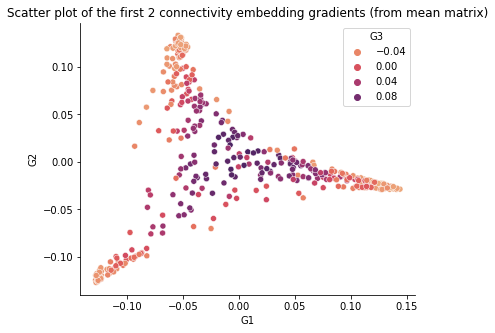

In [188]:
fig, ax = plt.subplots(figsize=(6,5));
ax = sns.scatterplot(x=mean_grad_unrel_1.gradients_[:,0],  # all rows (400 parces), first column (G1)
                     y=mean_grad_unrel_1.gradients_[:,1],  # all rows (400 parces), second column (G2)
                     hue=mean_grad_unrel_1.gradients_[:,2],  # gives color coding based on all rows (400 parces), third column (G3)
                     palette=sns.color_palette("flare", as_cmap=True), 
                     legend=True, ax=ax);
ax.set_xlabel('G1');
ax.set_ylabel('G2');
ax.set_title("Scatter plot of the first 2 connectivity embedding gradients (from mean matrix)")
ax.spines['right'].set_visible(False);
ax.spines['top'].set_visible(False);
plt.legend(title='G3')
plt.show(ax)

#### Aligned gradients

Construct gradients for all subjects (procrustes alignment to the overall mean matrix)

In [189]:
list_aligned_gradients_unrel_1 = []  # will contain all participants (1014), all parcels (400), all gradients (10)
list_aligned_G1_unrel_1 = []  # will contain all participants (1014), all parcels (400) -> values = eigenvalues for GRADIENT 1
list_aligned_G2_unrel_1 = []  # will contain all participants (1014), all parcels (400) -> values = eigenvalues for GRADIENT 2
list_aligned_G3_unrel_1 = []  # will contain all participants (1014), all parcels (400) -> values = eigenvalues for GRADIENT 3
  
# loop over all the fc matrices
for i in range(len(fc_matrices_400_unrel_1)):
    # setting model parameters for gradients to be computed across subjects - with procrustes alignment
    grad_procr = GradientMaps(n_components=10, random_state=0, approach='dm', kernel='normalized_angle', alignment='procrustes')  # specify alignment method here (procrustes)

    # computing
    # note that by using an alignment method, .fit yields a variable (grad_procr) containing both types of gradients, callable with: .gradients_ (original) and .aligned_ (aligned - use this for analyses)
    grad_procr.fit(fc_matrices_400[i], reference=mean_grad.gradients_)  # align to the gradients of the gradients produced by the mean matrix (reference) 

    # append array to lists results (.T is necessary in order to be able to first access the gradients layer (10) so that can index the desired gradient, which will then contain all the parcels (400)
    list_aligned_gradients_unrel_1.append(grad_procr.aligned_)
    list_aligned_G1_unrel_1.append(grad_procr.aligned_.T[0])
    list_aligned_G2_unrel_1.append(grad_procr.aligned_.T[1])
    list_aligned_G3_unrel_1.append(grad_procr.aligned_.T[2])
    
# make gradient lists into arrays (for analyses)    
array_aligned_gradients_unrel_1 = np.array(list_aligned_gradients_unrel_1)
array_aligned_G1_unrel_1 = np.array(list_aligned_G1_unrel_1)
array_aligned_G2_unrel_1 = np.array(list_aligned_G2_unrel_1)
array_aligned_G3_unrel_1 = np.array(list_aligned_G3_unrel_1)

#### NON-aligned gradients

Construct gradients for all subjects (not aligning as test to see if null sex differences due to alignment)

In [190]:
list_NONaligned_gradients_unrel_1 = []  # will contain all participants (1014), all parcels (400), all gradients (10)
list_NONaligned_G1_unrel_1 = []  # will contain all participants (1014), all parcels (400) -> values = eigenvalues for GRADIENT 1
list_NONaligned_G2_unrel_1 = []  # will contain all participants (1014), all parcels (400) -> values = eigenvalues for GRADIENT 2
list_NONaligned_G3_unrel_1 = []  # will contain all participants (1014), all parcels (400) -> values = eigenvalues for GRADIENT 3
  
# loop over all the fc matrices
for i in range(len(fc_matrices_400_unrel_1)):
    # setting model parameters for gradients to be computed across subjects - with procrustes alignment
    grad = GradientMaps(n_components=10, random_state=0, approach='dm', kernel='normalized_angle') 

    # computing
    # note that by using an alignment method, .fit yields a variable (grad_procr) containing both types of gradients, callable with: .gradients_ (original) and .aligned_ (aligned - use this for analyses)
    grad.fit(fc_matrices_400_unrel_1[i], reference=mean_grad.gradients_)  # align to the gradients of the gradients produced by the mean matrix (reference) 

    # append array to lists results (.T is necessary in order to be able to first access the gradients layer (10) so that can index the desired gradient, which will then contain all the parcels (400)
    list_NONaligned_gradients_unrel_1.append(grad.gradients_)
    list_NONaligned_G1_unrel_1.append(grad.gradients_.T[0])
    list_NONaligned_G2_unrel_1.append(grad.gradients_.T[1])
    list_NONaligned_G3_unrel_1.append(grad.gradients_.T[2])
    
# make gradient lists into arrays (for analyses)    
array_NONaligned_gradients_unrel_1 = np.array(list_NONaligned_gradients_unrel_1)
array_NONaligned_G1_unrel_1 = np.array(list_NONaligned_G1_unrel_1)
array_NONaligned_G2_unrel_1 = np.array(list_NONaligned_G2_unrel_1)
array_NONaligned_G3_unrel_1 = np.array(list_NONaligned_G3_unrel_1)

#### Mean gradients by sex

*Needed for plotting Males vs Females*

##### Mean matrices by sex

Creating lists containing only male and only female fc matrices

In [191]:
fc_matrices_400_M_unrel_1 = []
fc_matrices_400_F_unrel_1 = []

for i in range(len(fc_matrices_400_unrel_1)):
    if merged_demographics_cleaned_unrel_1.Gender.iloc[i] == "M":
        fc_matrices_400_M_unrel_1.append(fc_matrices_400_unrel_1[i])
    elif merged_demographics_cleaned_unrel_1.Gender.iloc[i] == "F":
        fc_matrices_400_F_unrel_1.append(fc_matrices_400_unrel_1[i])

Calculating mean matrices by sex

In [192]:
mean_fc_matrix_M_unrel_1 = sum(fc_matrices_400_M_unrel_1)/len(fc_matrices_400_M_unrel_1)
mean_fc_matrix_F_unrel_1 = sum(fc_matrices_400_F_unrel_1)/len(fc_matrices_400_F_unrel_1)

##### Construct mean gradients by sex

In [193]:
# GradientMaps function used to build the model parameters
mean_grad_M_unrel_1 = GradientMaps(n_components = 10, random_state = 0, approach = 'dm', kernel = 'normalized_angle')
mean_grad_F_unrel_1 = GradientMaps(n_components = 10, random_state = 0, approach = 'dm', kernel = 'normalized_angle')

# fit function used to compute the gradients
mean_grad_M_unrel_1.fit(mean_fc_matrix_M_unrel_1)
mean_grad_F_unrel_1.fit(mean_fc_matrix_F_unrel_1)

GradientMaps(kernel='normalized_angle', random_state=0)

Variance explained by the 10 gradients

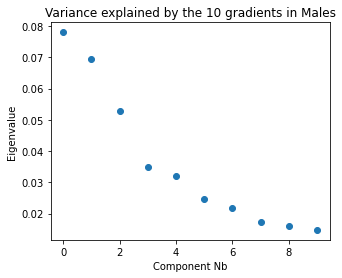

In [194]:
fig, ax = plt.subplots(1, figsize=(5, 4))

ax.scatter(range(mean_grad_M_unrel_1.lambdas_.size), mean_grad_M_unrel_1.lambdas_)
ax.set_title("Variance explained by the 10 gradients in Males")
ax.set_xlabel('Component Nb')
ax.set_ylabel('Eigenvalue')

plt.show()

In [195]:
count_varexp = 0
for i in range(len(mean_grad_M_unrel_1.lambdas_)):
    count_varexp += mean_grad_M_unrel_1.lambdas_[i]
    
print(f"Total amount of variance explained by the {len(mean_grad_M_unrel_1.lambdas_)} gradients in MALES: {count_varexp*100:.2f}%")
print(f"Variance explained by G1: {mean_grad_M_unrel_1.lambdas_[0]*100:.2f}%\nVariance explained by G2: {mean_grad_M_unrel_1.lambdas_[1]*100:.2f}%\nVariance explained by G3: {mean_grad_M_unrel_1.lambdas_[2]*100:.2f}%\n")

Total amount of variance explained by the 10 gradients in MALES: 36.22%
Variance explained by G1: 7.80%
Variance explained by G2: 6.93%
Variance explained by G3: 5.29%



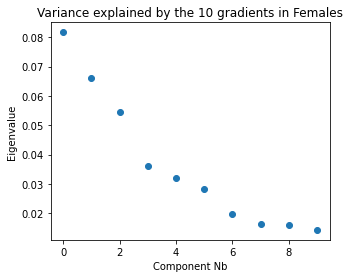

In [196]:
fig, ax = plt.subplots(1, figsize=(5, 4))

ax.scatter(range(mean_grad_F_unrel_1.lambdas_.size), mean_grad_F_unrel_1.lambdas_)
ax.set_title("Variance explained by the 10 gradients in Females")
ax.set_xlabel('Component Nb')
ax.set_ylabel('Eigenvalue')

plt.show()

In [197]:
count_varexp = 0
for i in range(len(mean_grad_F_unrel_1.lambdas_)):
    count_varexp += mean_grad_F_unrel_1.lambdas_[i]
    
print(f"Total amount of variance explained by the {len(mean_grad_F_unrel_1.lambdas_)} gradients in FEMALES: {count_varexp*100:.2f}%")
print(f"Variance explained by G1: {mean_grad_F_unrel_1.lambdas_[0]*100:.2f}%\nVariance explained by G2: {mean_grad_F_unrel_1.lambdas_[1]*100:.2f}%\nVariance explained by G3: {mean_grad_F_unrel_1.lambdas_[2]*100:.2f}%\n")

Total amount of variance explained by the 10 gradients in FEMALES: 36.54%
Variance explained by G1: 8.17%
Variance explained by G2: 6.62%
Variance explained by G3: 5.47%



Scatterplot of the first two gradients, colorcoding displays 3rd gradient (but categorical so not good)

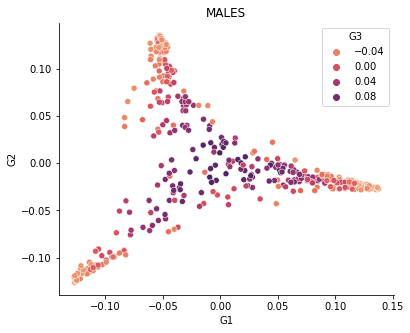

In [198]:
fig, ax = plt.subplots(figsize=(6,5));
ax = sns.scatterplot(x=mean_grad_M_unrel_1.gradients_[:,0],  # all rows (400 parcels), first column (G1)
                     y=mean_grad_M_unrel_1.gradients_[:,1],  # all rows (400 parcels), second column (G2)
                     hue=mean_grad_M_unrel_1.gradients_[:,2],  # gives color coding based on all rows (400 parcels), third column (G3)
                     palette=sns.color_palette("flare", as_cmap=True), 
                     legend=True, ax=ax);
ax.set_xlabel('G1');
ax.set_ylabel('G2');
ax.set_title("MALES")
ax.spines['right'].set_visible(False);
ax.spines['top'].set_visible(False);
plt.legend(title='G3')
plt.show(ax)

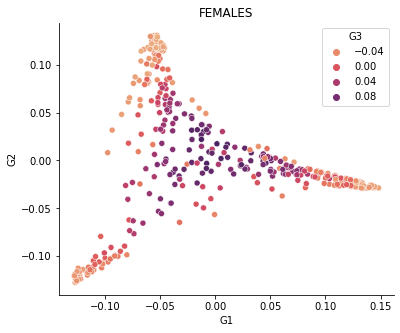

In [199]:
fig, ax = plt.subplots(figsize=(6,5));
ax = sns.scatterplot(x=mean_grad_F_unrel_1.gradients_[:,0],  # all rows (400 parcels), first column (G1)
                     y=mean_grad_F_unrel_1.gradients_[:,1],  # all rows (400 parcels), second column (G2)
                     hue=mean_grad_F_unrel_1.gradients_[:,2],  # gives color coding based on all rows (400 parcels), third column (G3)
                     palette=sns.color_palette("flare", as_cmap=True), 
                     legend=True, ax=ax);
ax.set_xlabel('G1');
ax.set_ylabel('G2');
ax.set_title("FEMALES")
ax.spines['right'].set_visible(False);
ax.spines['top'].set_visible(False);
plt.legend(title='G3')
plt.show(ax)

### Visualizing gradients by network

Using RainCloud plots https://github.com/RainCloudPlots/RainCloudPlots#python-environment

#### Gradient 1

Create a DataFrame containing the Gradient 1 eigenvalues and labelled Yeo 7 networks

In [200]:
# dataframe of the G1 eigenvalues (transposing the original array because we need the 400 parcels to be vertical in the dataframe in order to be labeled with their corresponding Yeo network)
df_G1_unrel_1 = pd.DataFrame(array_aligned_G1_unrel_1.T)

# adding a column containing the Yeo network labels
df_G1_unrel_1['yeo network'] = yeo7_networks

# renaming the Yeo network labels
df_G1_unrel_1.loc[df_G1_unrel_1["yeo network"] == "1", "yeo network"] = "visual"
df_G1_unrel_1.loc[df_G1_unrel_1["yeo network"] == "2", "yeo network"] = "sensory motor"
df_G1_unrel_1.loc[df_G1_unrel_1["yeo network"] == "3", "yeo network"] = "dorsal attention"
df_G1_unrel_1.loc[df_G1_unrel_1["yeo network"] == "4", "yeo network"] = "ventral attention"
df_G1_unrel_1.loc[df_G1_unrel_1["yeo network"] == "5", "yeo network"] = "limbic"
df_G1_unrel_1.loc[df_G1_unrel_1["yeo network"] == "6", "yeo network"] = "fronto parietal"
df_G1_unrel_1.loc[df_G1_unrel_1["yeo network"] == "7", "yeo network"] = "DMN"

# obtaining the mean of the parcels with the same Yeo network label, then transposing because we need the 1014 subjects to be vertical in the dataframe in order to be labeled with their corresponding sex 
df_G1_unrel_1 = df_G1_unrel_1.groupby("yeo network", as_index=True).mean().T

# adding a column containing the sex labels
df_G1_unrel_1["sex"] = merged_demographics_cleaned_unrel_1["Gender"].tolist()

# naming the index and resetting it as an index in order to make it callable in the following melt function
df_G1_unrel_1.index.name = "sub"
df_G1_unrel_1 = df_G1_unrel_1.reset_index()

# for the RainCloud plots, we need dataframe to have all values to be plotted in 1 column, and labels to be plotted in other columns (max 2)
# using melt() to make dataframe long so that mean eigenvalues per network are in one column, whilst preserving the sub number and sex as ID variables
df_G1_unrel_1 = pd.melt(df_G1_unrel_1, id_vars=["sub", 'sex'], var_name='yeo network', value_name='mean eigenvalues per yeo network')

# in order to first display across sexes (clouds on the same line), creating another column with only 1s in order to use it as the "group" for dx
df_G1_unrel_1["across sexes"] = [1] * 3010

##### RainCloud plot of mean eigenvalues (G1) for 7 Yeo networks - across sexes

Mean eigenvalues for aligned G1 calculated across parcels belonging to each network (all subjects) 
3010 data points (430 subjects * 7 networks) 

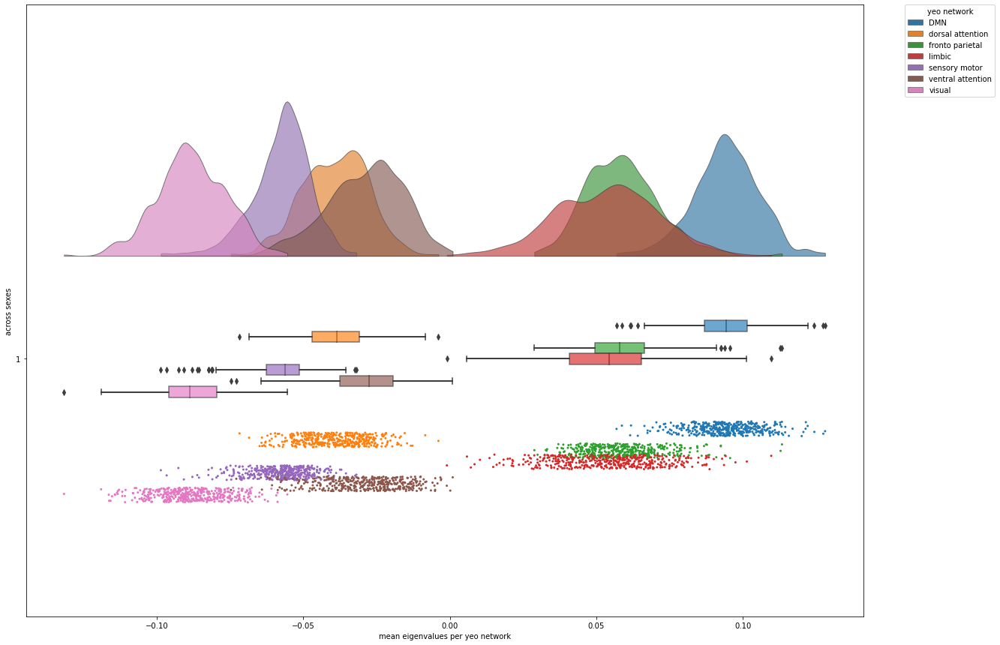

In [201]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="across sexes",
                y="mean eigenvalues per yeo network",
                hue="yeo network",
                data=df_G1_unrel_1,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=False, 
                dodge = True)

##### RainCloud plot of mean eigenvalues (G1) for 7 Yeo networks - by sex

Mean eigenvalues for aligned G1 calculated across parcels belonging to each network (all subjects, displayed by sex) 

3010 data points (430 subjects * 7 networks)

**BY EYE: I NOTICE LESS STARK SEX DIFFERENCES COMPARED WITH WHOLE SAMPLE...!!!** - but this is a the mean level, doesn't necessarily impact the t-values at parcel level

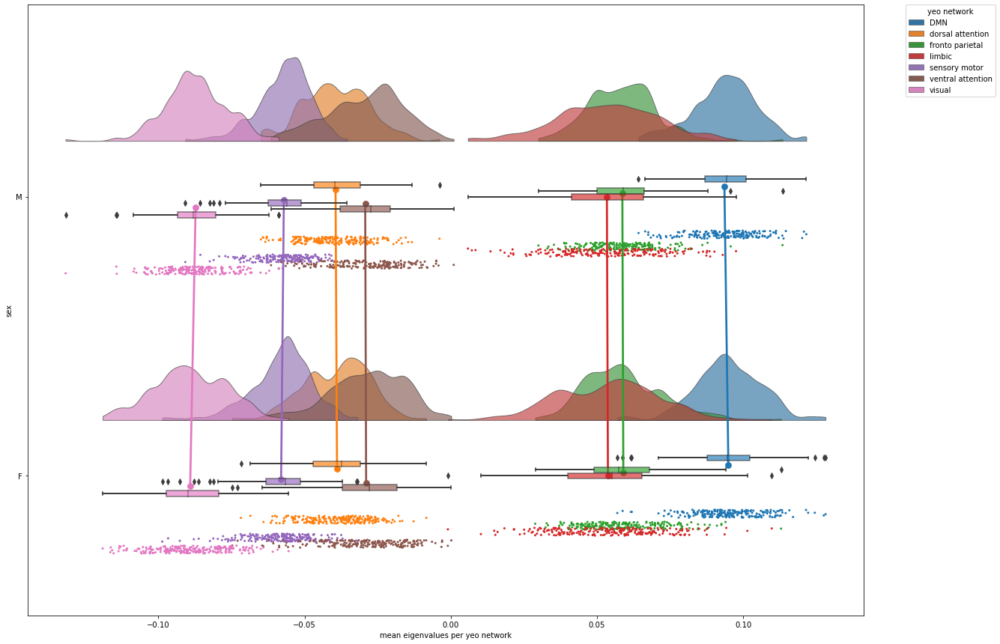

In [202]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="sex",
                y="mean eigenvalues per yeo network",
                hue="yeo network",
                data=df_G1_unrel_1,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=True, 
                dodge = True)

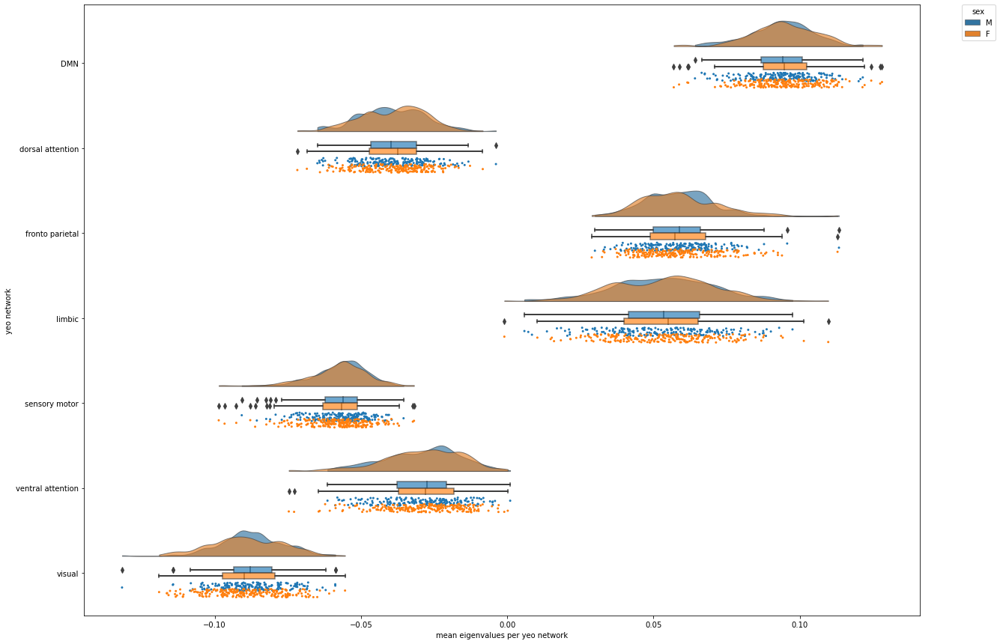

In [203]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="yeo network",
                y="mean eigenvalues per yeo network",
                hue="sex",
                data=df_G1_unrel_1,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                #figsize=(7,5),  # DELETE THIS
                orient="h",
                move=.2,
                alpha=.65, 
                dodge=True)

#### Gradient 2

Create a DataFrame containing the Gradient 2 eigenvalues and labelled Yeo 7 networks

In [204]:
# dataframe of the G2 eigenvalues (transposing the original array because we need the 400 parcels to be vertical in the dataframe in order to be labeled with their corresponding Yeo network)
df_G2_unrel_1 = pd.DataFrame(array_aligned_G2_unrel_1.T)

# adding a column containing the Yeo network labels
df_G2_unrel_1['yeo network'] = yeo7_networks

# renaming the Yeo network labels
df_G2_unrel_1.loc[df_G2_unrel_1["yeo network"] == "1", "yeo network"] = "visual"
df_G2_unrel_1.loc[df_G2_unrel_1["yeo network"] == "2", "yeo network"] = "sensory motor"
df_G2_unrel_1.loc[df_G2_unrel_1["yeo network"] == "3", "yeo network"] = "dorsal attention"
df_G2_unrel_1.loc[df_G2_unrel_1["yeo network"] == "4", "yeo network"] = "ventral attention"
df_G2_unrel_1.loc[df_G2_unrel_1["yeo network"] == "5", "yeo network"] = "limbic"
df_G2_unrel_1.loc[df_G2_unrel_1["yeo network"] == "6", "yeo network"] = "fronto parietal"
df_G2_unrel_1.loc[df_G2_unrel_1["yeo network"] == "7", "yeo network"] = "DMN"

# obtaining the mean of the parcels with the same Yeo network label, then transposing because we need the 1014 subjects to be vertical in the dataframe in order to be labeled with their corresponding sex 
df_G2_unrel_1 = df_G2_unrel_1.groupby("yeo network", as_index=True).mean().T

# adding a column containing the sex labels
df_G2_unrel_1["sex"] = merged_demographics_cleaned_unrel_1["Gender"].tolist()

# naming the index and resetting it as an index in order to make it callable in the following melt function
df_G2_unrel_1.index.name = "sub"
df_G2_unrel_1 = df_G2_unrel_1.reset_index()

# for the RainCloud plots, we need dataframe to have all values to be plotted in 1 column, and labels to be plotted in other columns (max 2)
# using melt() to make dataframe long so that mean eigenvalues per network are in one column, whilst preserving the sub number and sex as ID variables
df_G2_unrel_1 = pd.melt(df_G2_unrel_1, id_vars=["sub", 'sex'], var_name='yeo network', value_name='mean eigenvalues per yeo network')

# in order to first display across sexes (clouds on the same line), creating another column with only 1s in order to use it as the "group" for dx
df_G2_unrel_1["across sexes"] = [1] * 3010

##### RainCloud plot of mean eigenvalues (G2) for 7 Yeo networks - across sexes

Mean eigenvalues for aligned G2 calculated across parcels belonging to each network (all subjects) 
3010 data points (430 subjects * 7 networks) 

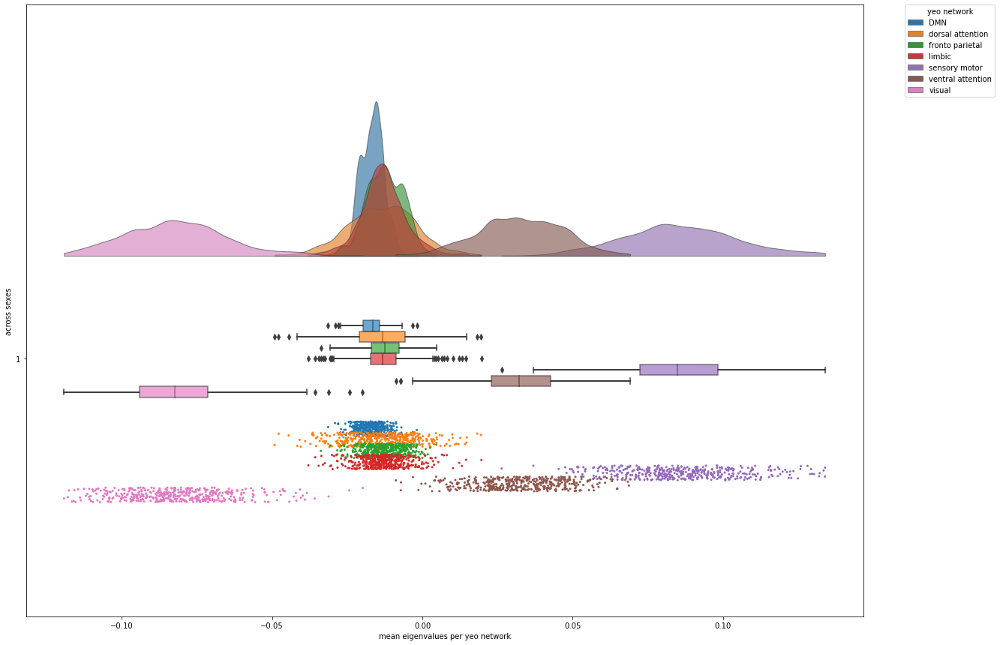

In [205]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="across sexes",
                y="mean eigenvalues per yeo network",
                hue="yeo network",
                data=df_G2_unrel_1,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=False, 
                dodge = True)

##### RainCloud plots of mean eigenvalues (G2) for 7 Yeo networks - by sex

Mean eigenvalues for aligned G2 calculated across parcels belonging to each network (all subjects, displayed by sex) 

7098 data points (1014 subjects * 7 networks) 


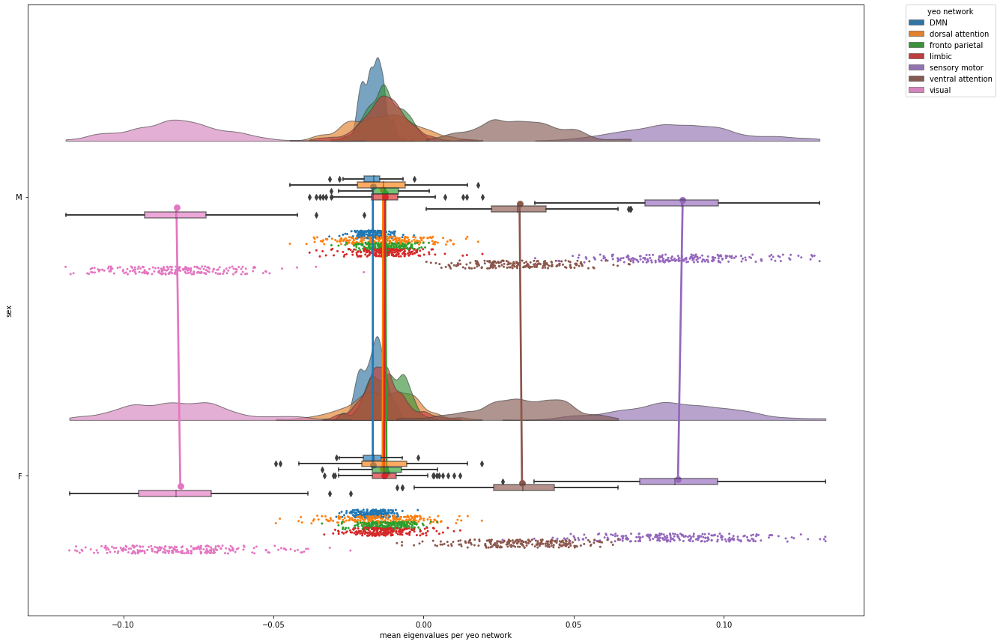

In [206]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="sex",
                y="mean eigenvalues per yeo network",
                hue="yeo network",
                data=df_G2_unrel_1,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=True, 
                dodge = True)

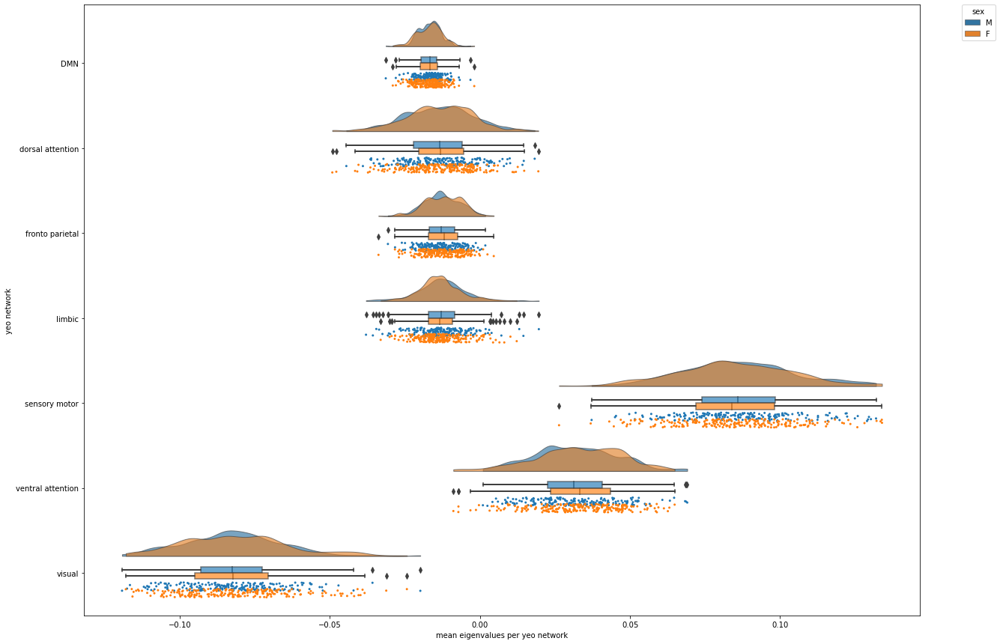

In [207]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="yeo network",
                y="mean eigenvalues per yeo network",
                hue="sex",
                data=df_G2_unrel_1,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65, 
                dodge=True)

#### Gradient 3

Create a DataFrame containing the Gradient 3 eigenvalues and labelled Yeo 7 networks

In [208]:
# dataframe of the G3 eigenvalues (transposing the original array because we need the 400 parcels to be vertical in the dataframe in order to be labeled with their corresponding Yeo network)
df_G3_unrel_1 = pd.DataFrame(array_aligned_G3_unrel_1.T)

# adding a column containing the Yeo network labels
df_G3_unrel_1['yeo network'] = yeo7_networks

# renaming the Yeo network labels
df_G3_unrel_1.loc[df_G3_unrel_1["yeo network"] == "1", "yeo network"] = "visual"
df_G3_unrel_1.loc[df_G3_unrel_1["yeo network"] == "2", "yeo network"] = "sensory motor"
df_G3_unrel_1.loc[df_G3_unrel_1["yeo network"] == "3", "yeo network"] = "dorsal attention"
df_G3_unrel_1.loc[df_G3_unrel_1["yeo network"] == "4", "yeo network"] = "ventral attention"
df_G3_unrel_1.loc[df_G3_unrel_1["yeo network"] == "5", "yeo network"] = "limbic"
df_G3_unrel_1.loc[df_G3_unrel_1["yeo network"] == "6", "yeo network"] = "fronto parietal"
df_G3_unrel_1.loc[df_G3_unrel_1["yeo network"] == "7", "yeo network"] = "DMN"

# obtaining the mean of the parcels with the same Yeo network label, then transposing because we need the 1014 subjects to be vertical in the dataframe in order to be labeled with their corresponding sex 
df_G3_unrel_1 = df_G3_unrel_1.groupby("yeo network", as_index=True).mean().T

# adding a column containing the sex labels
df_G3_unrel_1["sex"] = merged_demographics_cleaned_unrel_1["Gender"].tolist()

# naming the index and resetting it as an index in order to make it callable in the following melt function
df_G3_unrel_1.index.name = "sub"
df_G3_unrel_1 = df_G3_unrel_1.reset_index()

# for the RainCloud plots, we need dataframe to have all values to be plotted in 1 column, and labels to be plotted in other columns (max 2)
# using melt() to make dataframe long so that mean eigenvalues per network are in one column, whilst preserving the sub number and sex as ID variables
df_G3_unrel_1 = pd.melt(df_G3_unrel_1, id_vars=["sub", 'sex'], var_name='yeo network', value_name='mean eigenvalues per yeo network')

# in order to first display across sexes (clouds on the same line), creating another column with only 1s in order to use it as the "group" for dx
df_G3_unrel_1["across sexes"] = [1] * 3010

##### RainCloud plots of mean eigenvalues (G3) for 7 Yeo networks - across sexes

Mean eigenvalues for aligned G3 calculated across parcels belonging to each network (all subjects) 
3010 data points (430 subjects * 7 networks) 

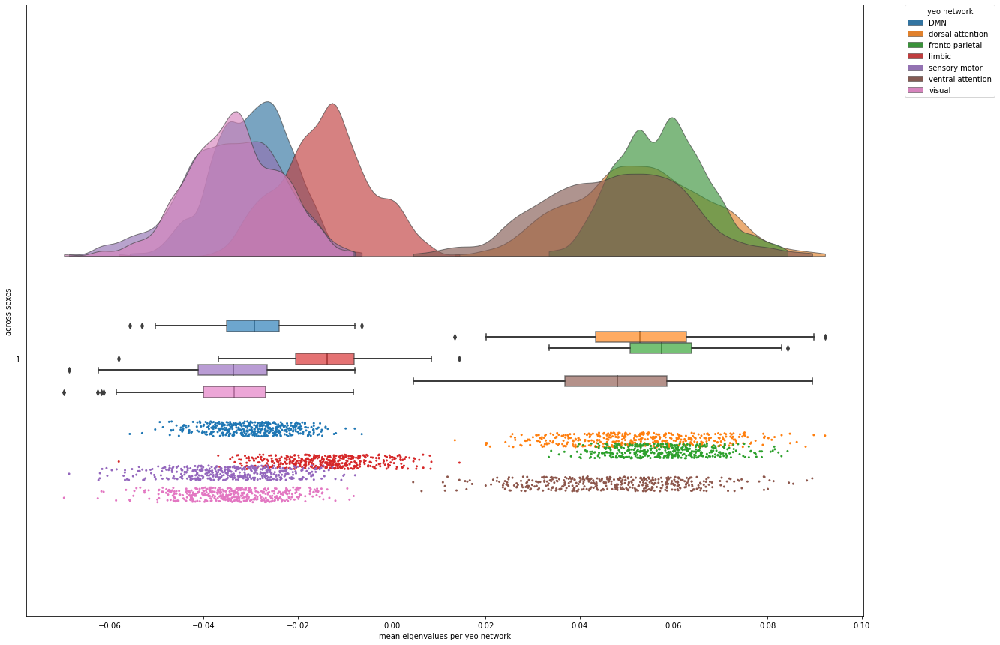

In [209]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="across sexes",
                y="mean eigenvalues per yeo network",
                hue="yeo network",
                data=df_G3_unrel_1,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=False, 
                dodge = True)

##### RainCloud plots of mean eigenvalues (G3) for 7 Yeo networks - by sex

Mean eigenvalues for aligned G3 calculated across parcels belonging to each network (all subjects, displayed by sex) 

3010 data points (430 subjects * 7 networks) 

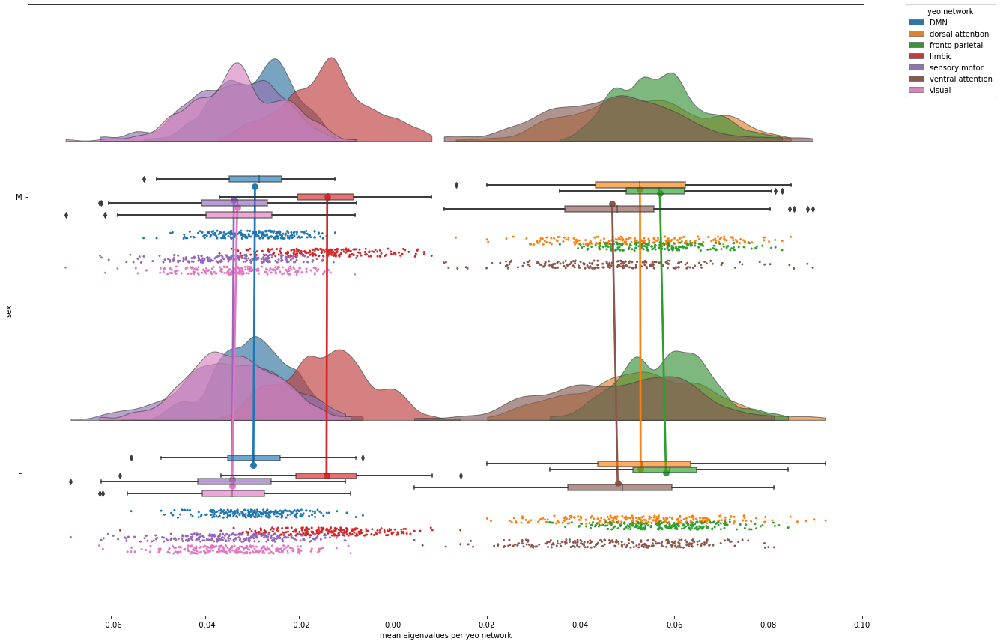

In [210]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="sex",
                y="mean eigenvalues per yeo network",
                hue="yeo network",
                data=df_G3_unrel_1,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=True, 
                dodge = True)

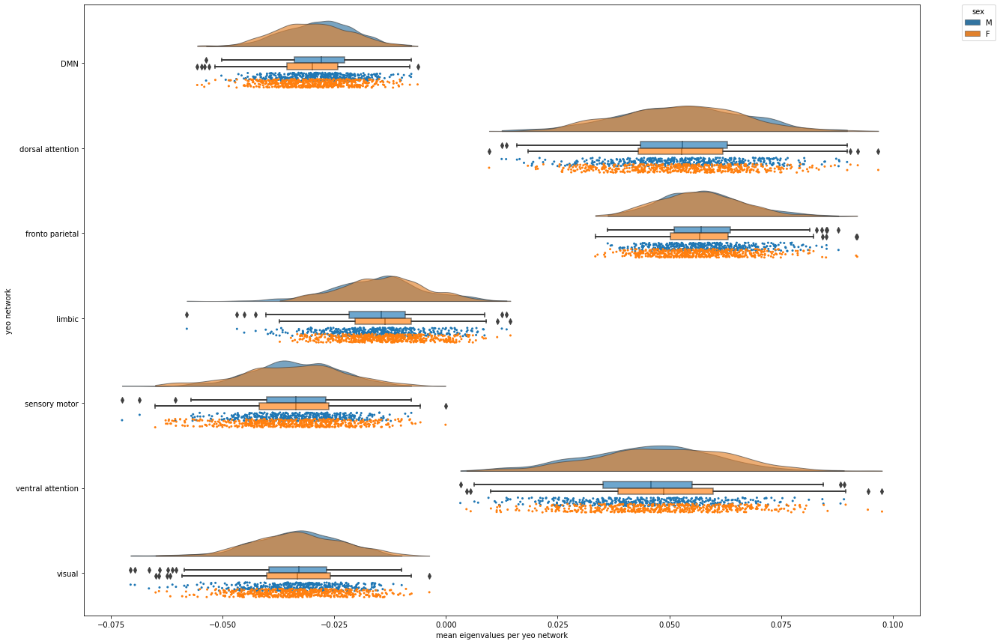

In [211]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="yeo network",
                y="mean eigenvalues per yeo network",
                hue="sex",
                data=df_G3,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65, 
                dodge=True)

### Sex effects (standard linear regression - FDR-corrected - main model: sex + age + ICV)

#### Gradient 1

In [212]:
### creating model terms

term_sex_unrel_1 = FixedEffect(merged_demographics_cleaned_unrel_1.Gender)
term_age_unrel_1 = FixedEffect(merged_demographics_cleaned_unrel_1.Age_in_Yrs)
term_icv_unrel_1 = FixedEffect(merged_demographics_cleaned_unrel_1.FS_IntraCranial_Vol)


### defining contrast to test: sex differences

contrast_sex_unrel_1 = (merged_demographics_cleaned_unrel_1.Gender == "M").astype(int) - (merged_demographics_cleaned_unrel_1.Gender == "F").astype(int)  # makes M = 1 and F = -1


### defining the main model 

model_sex_age_icv_unrel_1 = term_sex_unrel_1 + term_age_unrel_1 + term_icv_unrel_1  


### fitting the main model

# sex effects including sex, age, and icv in model
slm_SEX_age_icv_unrel_1 = SLM(
    model_sex_age_icv_unrel_1,
    contrast = contrast_sex_unrel_1,
    correction=["fdr"],
    two_tailed=True,
)
slm_SEX_age_icv_unrel_1.fit(array_aligned_G1_unrel_1)

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/utils.py:303: RuntimeWarning: All-NaN axis encountered
  a, b = np.nanmin(x), np.nanmax(x)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/utils.py:367: RuntimeWarning: All-NaN slice encountered
  specs['min'][:] = np.nanmin(specs['min'], axis=ax, keepdims=True)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/utils.py:368: RuntimeWarning: All-NaN slice encountered
  specs['max'][:] = np.nanmax(specs['max'], axis=ax, keepdims=True)


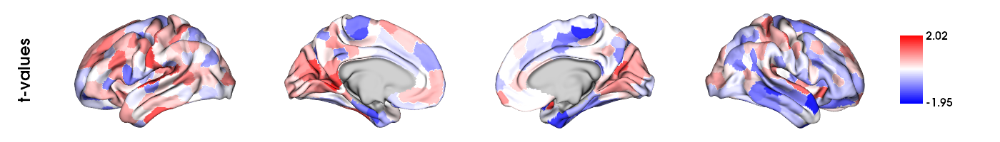

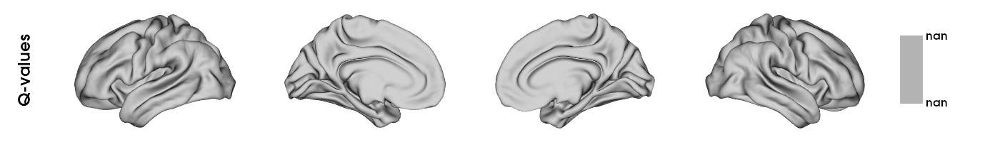

In [213]:
plots_to_display = plot_slm_results(slm_SEX_age_icv_unrel_1)
display(*plots_to_display)

--- NON ALIGNED (but sign-flipped) GRADIENTS ---

In [214]:
# creating a list/array that contains G1 eigenvalues that are not aligned but at least all "pointing in the same direction", i.e., the extremities of the gradient correspond across all subjects
# for this, calculate the correlation between each subject's gradient and the mean gradient, and if the correlation coefficient is negative -> sign-flip the given subject's gradient eigenvalues

flipped_array_NONaligned_G1_unrel_1 = []

for ppt_grad in array_NONaligned_G1_unrel_1:
    
    # correlation between mean gratient (G1) and gradient (G1) of subject currently iterated over 
    corr_coef = scipy.stats.pearsonr(ppt_grad, mean_grad_unrel_1.gradients_[:,0])[0]
    
    # if the correlation between the mean gradient and the subject's gradient is negative, need to flip the sign of all the eigenvalues in the subject's gradient (appending it to flipped list) - otherwise, append the gradient to the list as is
    if corr_coef < 0:
        flipped_array_NONaligned_G1_unrel_1.append(ppt_grad*-1)
    else:
        flipped_array_NONaligned_G1_unrel_1.append(ppt_grad)

# turn into array
flipped_array_NONaligned_G1_unrel_1 = np.array(flipped_array_NONaligned_G1_unrel_1)

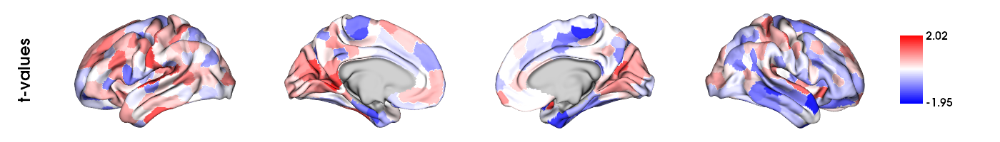

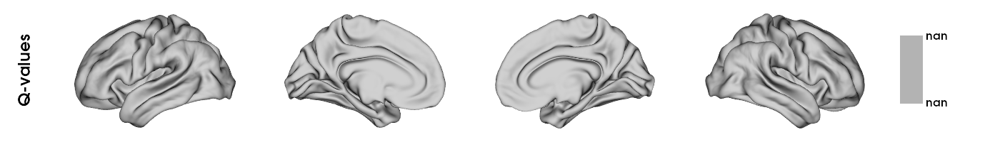

In [215]:
### fitting the main model for non aligned gradients

# sex effects including sex, age, and icv in model
slm_SEX_age_icv_unrel_1_NONaligned = SLM(
    model_sex_age_icv_unrel_1,
    contrast = contrast_sex_unrel_1,
    correction=["fdr"],
    two_tailed=True,
)
slm_SEX_age_icv_unrel_1_NONaligned.fit(flipped_array_NONaligned_G1_unrel_1)

# plot
plots_to_display = plot_slm_results(slm_SEX_age_icv_unrel_1)
display(*plots_to_display)

--- ORIGINAL RESULTS (full sample): ---

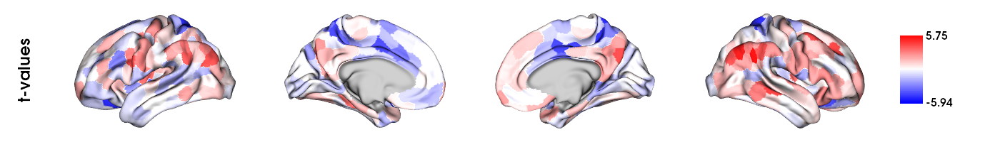

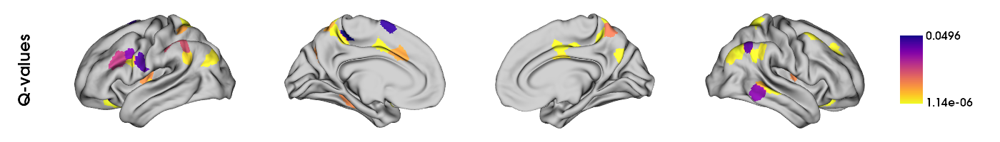

In [216]:
plots_to_display = plot_slm_results(slm_SEX_age_icv)
display(*plots_to_display)

Scatterplot of Gradient 1 eigenvalues (from mean matrix) and t-values for sex contrast in main model (controling for age and icv)

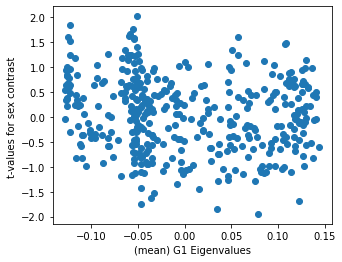

In [217]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(mean_grad_unrel_1.gradients_[:, 0], slm_SEX_age_icv_unrel_1.t[0])

ax.set_xlabel('(mean) G1 Eigenvalues')
ax.set_ylabel('t-values for sex contrast ')

plt.show()

--- ORIGINAL RESULTS: ---

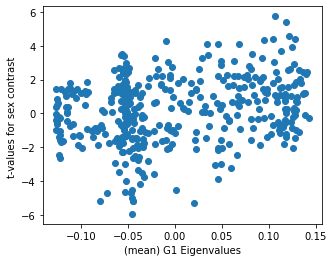

In [218]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(mean_grad.gradients_[:, 0], slm_SEX_age_icv.t[0])

ax.set_xlabel('(mean) G1 Eigenvalues')
ax.set_ylabel('t-values for sex contrast ')

plt.show()

#### Gradient 2

In [219]:
### model terms, contrast (sex differences), main model -> already defined for Gradient 1


### fitting the main model

# sex effects including sex, age, and icv in model
slm_SEX_age_icv_unrel_1 = SLM(
    model_sex_age_icv_unrel_1,
    contrast = contrast_sex_unrel_1,
    correction=["fdr"],
    two_tailed=True,
)
slm_SEX_age_icv_unrel_1.fit(array_aligned_G2_unrel_1)

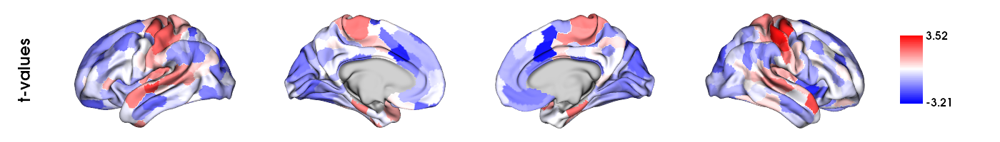

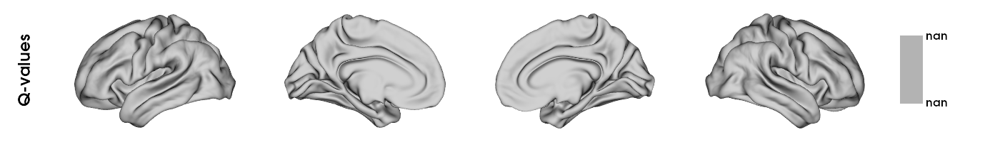

In [220]:
plots_to_display = plot_slm_results(slm_SEX_age_icv_unrel_1)
display(*plots_to_display)

--- ORIGINAL RESULTS: ---

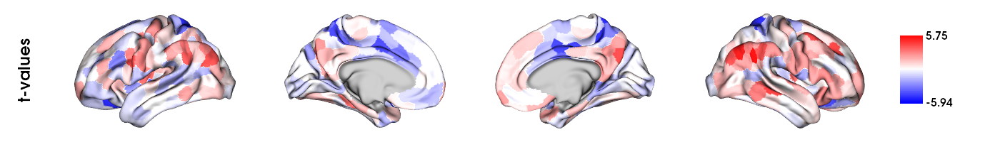

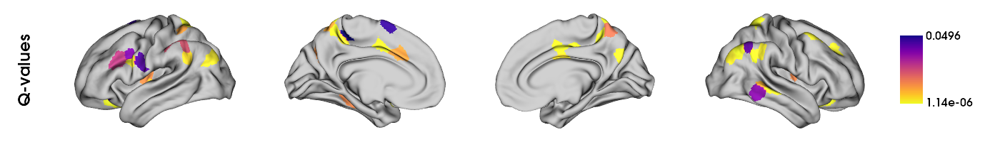

In [221]:
plots_to_display = plot_slm_results(slm_SEX_age_icv)
display(*plots_to_display)

Scatterplot of Gradient 2 eigenvalues (from mean matrix) and t-values for sex contrast in main model (controling for age and icv)

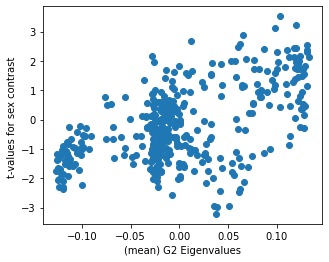

In [222]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(mean_grad_unrel_1.gradients_[:, 1], slm_SEX_age_icv_unrel_1.t[0])

ax.set_xlabel('(mean) G2 Eigenvalues')
ax.set_ylabel('t-values for sex contrast ')

plt.show()

--- ORIGINAL RESULTS: ---

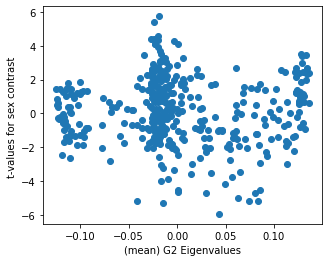

In [223]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(mean_grad.gradients_[:, 1], slm_SEX_age_icv.t[0])

ax.set_xlabel('(mean) G2 Eigenvalues')
ax.set_ylabel('t-values for sex contrast ')

plt.show()

#### Gradient 3

In [224]:
### model terms, contrast (sex differences), main model -> already defined for Gradient 1


### fitting the main model

# sex effects including sex, age, and icv in model
slm_SEX_age_icv_unrel_1 = SLM(
    model_sex_age_icv_unrel_1,
    contrast = contrast_sex_unrel_1,
    correction=["fdr"],
    two_tailed=True,
)
slm_SEX_age_icv_unrel_1.fit(array_aligned_G3_unrel_1)

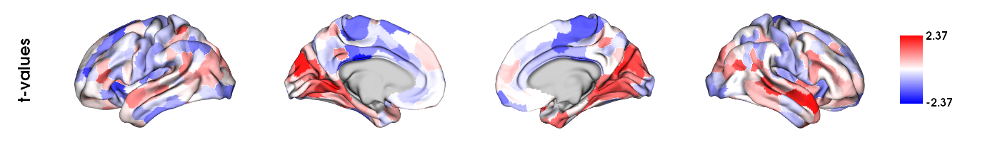

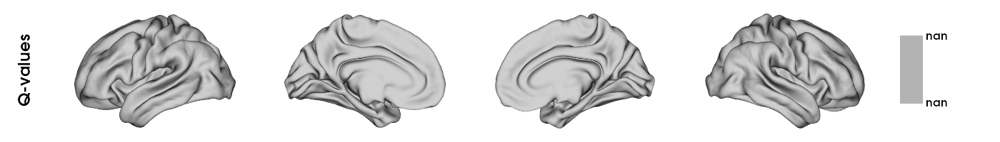

In [225]:
plots_to_display = plot_slm_results(slm_SEX_age_icv_unrel_1)
display(*plots_to_display)

--- ORIGINAL RESULTS: ---

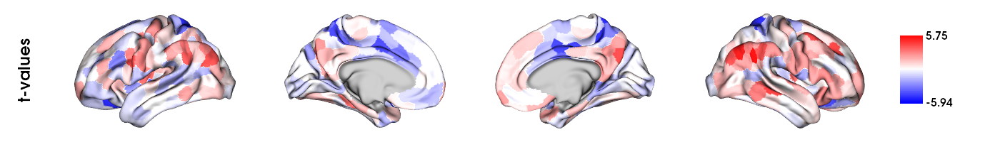

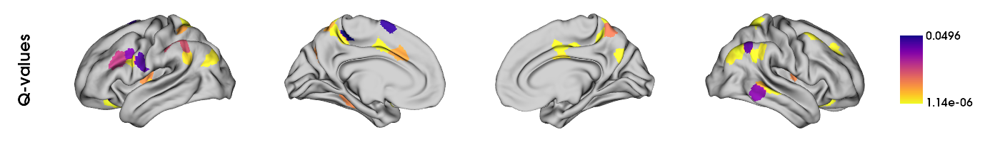

In [226]:
plots_to_display = plot_slm_results(slm_SEX_age_icv)
display(*plots_to_display)

Scatterplot of Gradient 3 eigenvalues (from mean matrix) and t-values for sex contrast in main model (controling for age and icv)

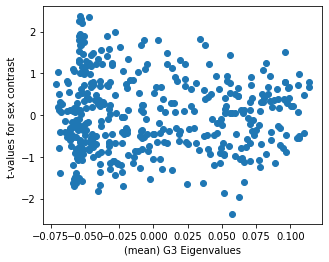

In [227]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(mean_grad_unrel_1.gradients_[:, 2], slm_SEX_age_icv_unrel_1.t[0])

ax.set_xlabel('(mean) G3 Eigenvalues')
ax.set_ylabel('t-values for sex contrast ')

plt.show()

--- ORIGINAL RESULTS: ---

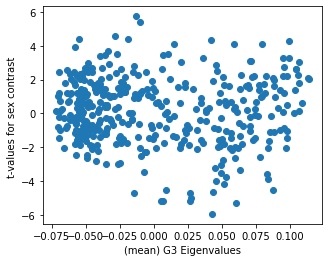

In [228]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(mean_grad.gradients_[:, 2], slm_SEX_age_icv.t[0])

ax.set_xlabel('(mean) G3 Eigenvalues')
ax.set_ylabel('t-values for sex contrast ')

plt.show()

## PCA (instead of diffusion embedding) to construct gradients

### Constructing gradients

#### Construct mean gradients 
(i.e., gradients for the mean matrix)

In [229]:
# GradientMaps function used to build the model parameters
mean_grad_pca = GradientMaps(n_components = 10, random_state = 0, approach = 'pca', kernel = 'normalized_angle')

# fit function used to compute the gradients
mean_grad_pca.fit(mean_fc_matrix)

GradientMaps(approach='pca', kernel='normalized_angle', random_state=0)

Plot 3 first gradients of the mean matrix

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


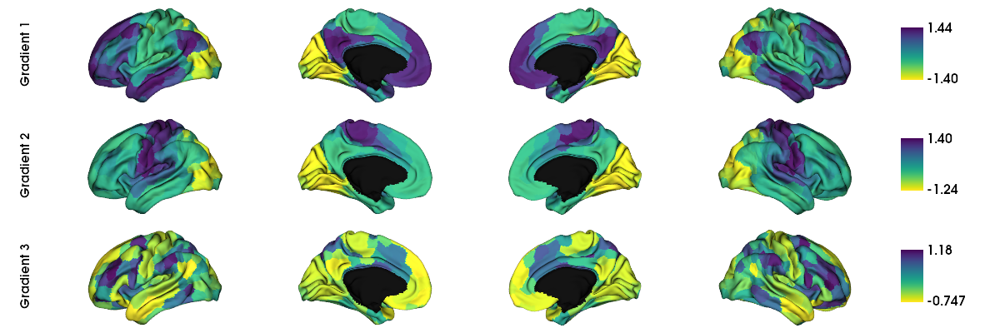

In [230]:
# defining labeling scheme and mask
labeling = load_parcellation('schaefer', scale=400, join=True)
surf_lh, surf_rh = load_conte69()

mask = labeling != 0


# list containing placeholders (None) for the number of gradients I want to plot
grad = [None] * 3

for i in range(3):
    # map the gradient to the parcels
    grad[i] = map_to_labels(mean_grad_pca.gradients_[:, i], labeling, mask=mask, fill=np.nan)  # mean_grad contains 10 .gradients_ (1 gradient per column) - here I take all rows and individual select column based on gradient I want (first 3)

plot_hemispheres(surf_lh, surf_rh, array_name=grad, embed_nb = True, size=(1200, 400), cmap='viridis_r', color_bar=True, label_text=['Gradient 1', 'Gradient 2', 'Gradient 3'], zoom=1.55)

Variance explained by the 10 gradients

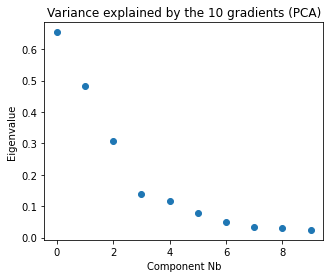

In [231]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(range(mean_grad_pca.lambdas_.size), mean_grad_pca.lambdas_)
ax.set_title("Variance explained by the 10 gradients (PCA)")
ax.set_xlabel('Component Nb')
ax.set_ylabel('Eigenvalue')

plt.show()

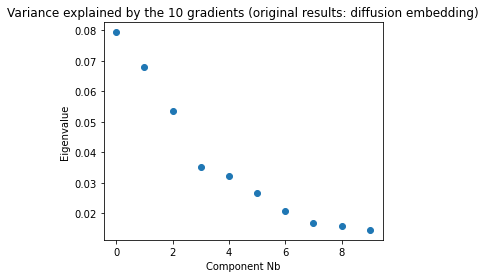

In [232]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(range(mean_grad.lambdas_.size), mean_grad.lambdas_)
ax.set_title("Variance explained by the 10 gradients (original results: diffusion embedding)")
ax.set_xlabel('Component Nb')
ax.set_ylabel('Eigenvalue')

plt.show()

In [233]:
# Scaled variance explained by individual gradients: lambda / total(i.e., sum lambdas) * 100 %
print(f"Total amount of variance explained by the {len(mean_grad_pca.lambdas_)} gradients (uncorrected sum lambdas) - PCA: {sum(mean_grad_pca.lambdas_):.2f}\n")
print(f"Scaled variance explained by individual gradients:\nG1: {mean_grad_pca.lambdas_[0]/sum(mean_grad_pca.lambdas_)*100:.2f}%\nG2: {mean_grad_pca.lambdas_[1]/sum(mean_grad_pca.lambdas_)*100:.2f}%\nG3: {mean_grad_pca.lambdas_[2]/sum(mean_grad_pca.lambdas_)*100:.2f}%\n")

Total amount of variance explained by the 10 gradients (uncorrected sum lambdas) - PCA: 1.91

Scaled variance explained by individual gradients:
G1: 34.17%
G2: 25.22%
G3: 16.06%



In [234]:
# Scaled variance explained by individual gradients: lambda / total(i.e., sum lambdas) * 100 %
print(f"Total amount of variance explained by the {len(mean_grad.lambdas_)} gradients (uncorrected sum lambdas) - original resutls diffusion embedding: {sum(mean_grad.lambdas_):.2f}\n")
print(f"Scaled variance explained by individual gradients:\nG1: {mean_grad.lambdas_[0]/sum(mean_grad.lambdas_)*100:.2f}%\nG2: {mean_grad.lambdas_[1]/sum(mean_grad.lambdas_)*100:.2f}%\nG3: {mean_grad.lambdas_[2]/sum(mean_grad.lambdas_)*100:.2f}%\n")

Total amount of variance explained by the 10 gradients (uncorrected sum lambdas) - original resutls diffusion embedding: 0.36

Scaled variance explained by individual gradients:
G1: 21.85%
G2: 18.71%
G3: 14.74%



Scatterplot of the first two gradients, colorcoding displays 3rd gradient (but categorical so not good)

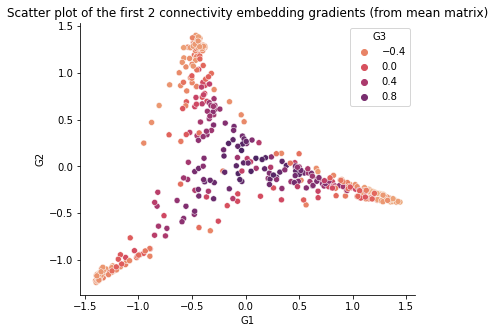

In [235]:
fig, ax = plt.subplots(figsize=(6,5));
ax = sns.scatterplot(x=mean_grad_pca.gradients_[:,0],  # all rows (400 parces), first column (G1)
                     y=mean_grad_pca.gradients_[:,1],  # all rows (400 parces), second column (G2)
                     hue=mean_grad_pca.gradients_[:,2],  # gives color coding based on all rows (400 parces), third column (G3)
                     palette=sns.color_palette("flare", as_cmap=True), 
                     legend=True, ax=ax);
ax.set_xlabel('G1');
ax.set_ylabel('G2');
ax.set_title("Scatter plot of the first 2 connectivity embedding gradients (from mean matrix)")
ax.spines['right'].set_visible(False);
ax.spines['top'].set_visible(False);
plt.legend(title='G3')
plt.show(ax)

#### Aligned gradients

Construct gradients for all subjects (procrustes alignment to the overall mean matrix)

In [236]:
list_aligned_gradients_pca = []  # will contain all participants (1014), all parcels (400), all gradients (10)
list_aligned_G1_pca = []  # will contain all participants (1014), all parcels (400) -> values = eigenvalues for GRADIENT 1
list_aligned_G2_pca = []  # will contain all participants (1014), all parcels (400) -> values = eigenvalues for GRADIENT 2
list_aligned_G3_pca = []  # will contain all participants (1014), all parcels (400) -> values = eigenvalues for GRADIENT 3
  
# loop over all the fc matrices
for i in range(len(fc_matrices_400)):
    # setting model parameters for gradients to be computed across subjects - with procrustes alignment
    grad_procr_pca = GradientMaps(n_components=10, random_state=0, approach='pca', kernel='normalized_angle', alignment='procrustes')  # specify alignment method here (procrustes)

    # computing
    # note that by using an alignment method, .fit yields a variable (grad_procr) containing both types of gradients, callable with: .gradients_ (original) and .aligned_ (aligned - use this for analyses)
    grad_procr_pca.fit(fc_matrices_400[i], reference=mean_grad_pca.gradients_)  # align to the gradients of the gradients produced by the mean matrix (reference) 

    # append array to lists results (.T is necessary in order to be able to first access the gradients layer (10) so that can index the desired gradient, which will then contain all the parcels (400)
    list_aligned_gradients_pca.append(grad_procr_pca.aligned_)
    list_aligned_G1_pca.append(grad_procr_pca.aligned_.T[0])
    list_aligned_G2_pca.append(grad_procr_pca.aligned_.T[1])
    list_aligned_G3_pca.append(grad_procr_pca.aligned_.T[2])
    
# make gradient lists into arrays (for analyses)    
array_aligned_gradients_pca = np.array(list_aligned_gradients_pca)
array_aligned_G1_pca = np.array(list_aligned_G1_pca)
array_aligned_G2_pca = np.array(list_aligned_G2_pca)
array_aligned_G3_pca = np.array(list_aligned_G3_pca)

### Visualizing gradients by network

Using RainCloud plots https://github.com/RainCloudPlots/RainCloudPlots#python-environment

#### Gradient 1

Create a DataFrame containing the Gradient 1 eigenvalues and labelled Yeo 7 networks

In [237]:
# dataframe of the G1 eigenvalues (transposing the original array because we need the 400 parcels to be vertical in the dataframe in order to be labeled with their corresponding Yeo network)
df_G1_pca = pd.DataFrame(array_aligned_G1_pca.T)

# adding a column containing the Yeo network labels
df_G1_pca['yeo network'] = yeo7_networks

# renaming the Yeo network labels
df_G1_pca.loc[df_G1_pca["yeo network"] == "1", "yeo network"] = "visual"
df_G1_pca.loc[df_G1_pca["yeo network"] == "2", "yeo network"] = "sensory motor"
df_G1_pca.loc[df_G1_pca["yeo network"] == "3", "yeo network"] = "dorsal attention"
df_G1_pca.loc[df_G1_pca["yeo network"] == "4", "yeo network"] = "ventral attention"
df_G1_pca.loc[df_G1_pca["yeo network"] == "5", "yeo network"] = "limbic"
df_G1_pca.loc[df_G1_pca["yeo network"] == "6", "yeo network"] = "fronto parietal"
df_G1_pca.loc[df_G1_pca["yeo network"] == "7", "yeo network"] = "DMN"

# obtaining the mean of the parcels with the same Yeo network label, then transposing because we need the 1014 subjects to be vertical in the dataframe in order to be labeled with their corresponding sex 
df_G1_pca = df_G1_pca.groupby("yeo network", as_index=True).mean().T

# adding a column containing the sex labels
df_G1_pca["sex"] = merged_demographics_cleaned["Gender"].tolist()

# naming the index and resetting it as an index in order to make it callable in the following melt function
df_G1_pca.index.name = "sub"
df_G1_pca = df_G1_pca.reset_index()

# for the RainCloud plots, we need dataframe to have all values to be plotted in 1 column, and labels to be plotted in other columns (max 2)
# using melt() to make dataframe long so that mean eigenvalues per network are in one column, whilst preserving the sub number and sex as ID variables
df_G1_pca=pd.melt(df_G1_pca, id_vars=["sub", 'sex'], var_name='yeo network', value_name='mean eigenvalues per yeo network')

# in order to first display across sexes (clouds on the same line), creating another column with only 1s in order to use it as the "group" for dx
df_G1_pca["across sexes"] = [1] * 7098

##### RainCloud plot of mean eigenvalues (G1) for 7 Yeo networks - across sexes

Mean eigenvalues for aligned G1 calculated across parcels belonging to each network (all subjects) 
7098 data points (1014 subjects * 7 networks) 

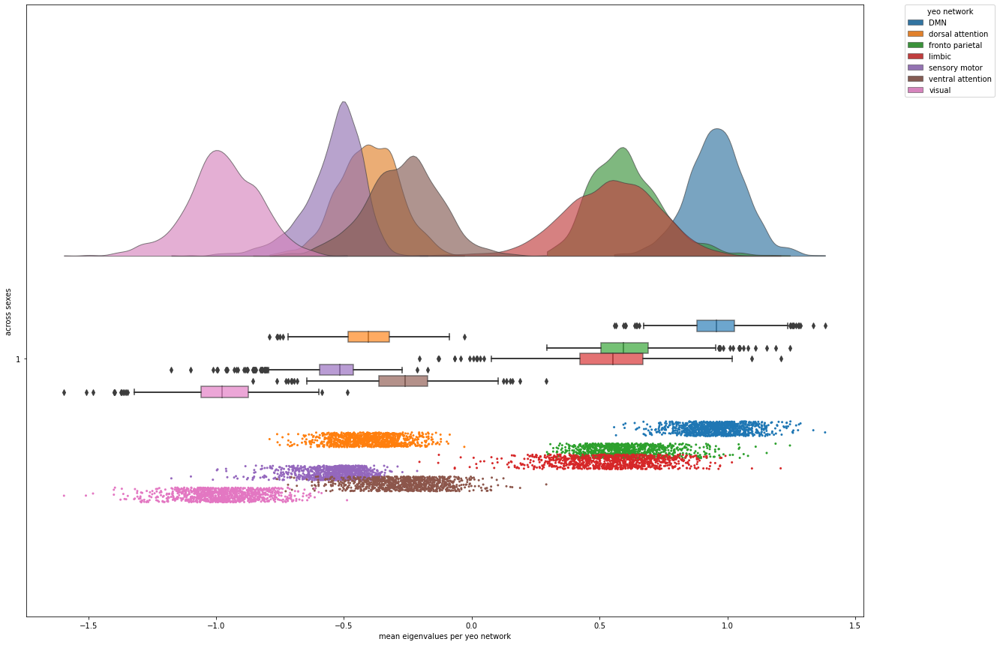

In [238]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="across sexes",
                y="mean eigenvalues per yeo network",
                hue="yeo network",
                data=df_G1_pca,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=False, 
                dodge = True)

##### RainCloud plot of mean eigenvalues (G1) for 7 Yeo networks - by sex

Mean eigenvalues for aligned G1 calculated across parcels belonging to each network (all subjects, displayed by sex) 

7098 data points (1014 subjects * 7 networks)

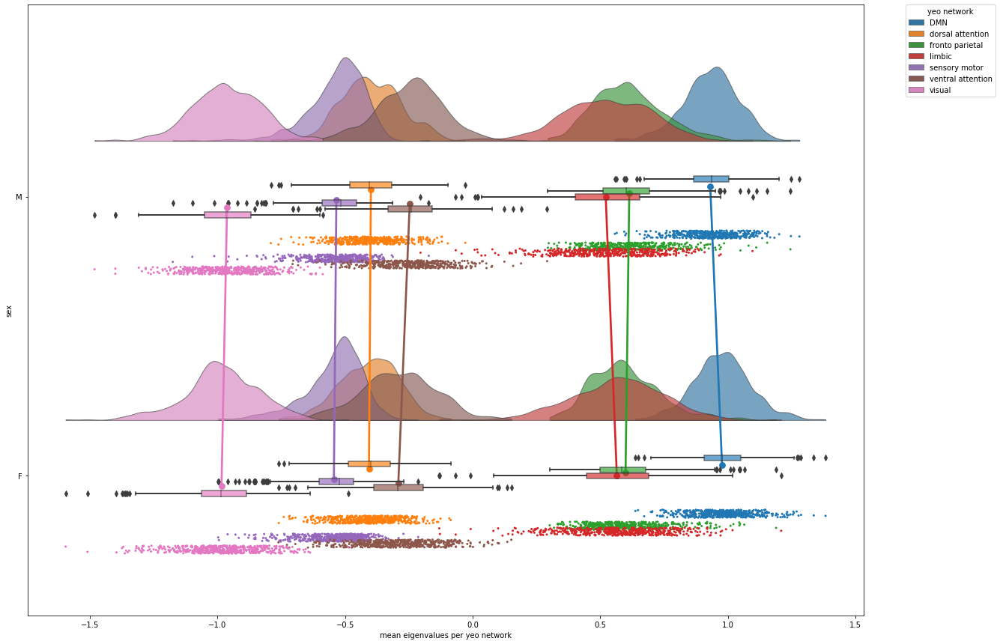

In [239]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="sex",
                y="mean eigenvalues per yeo network",
                hue="yeo network",
                data=df_G1_pca,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=True, 
                dodge = True)

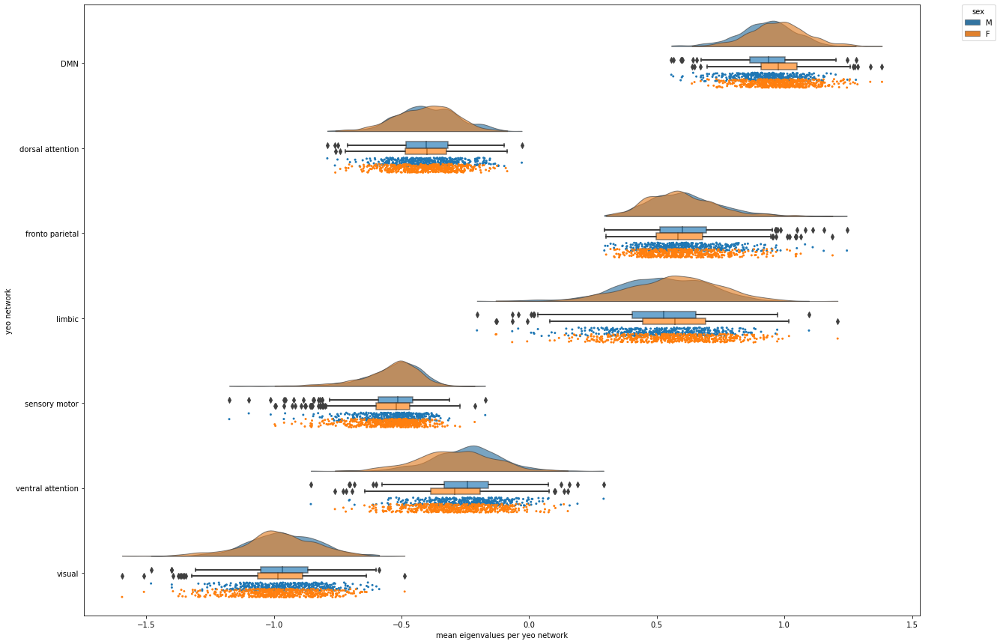

In [240]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="yeo network",
                y="mean eigenvalues per yeo network",
                hue="sex",
                data=df_G1_pca,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                #figsize=(7,5),  # DELETE THIS
                orient="h",
                move=.2,
                alpha=.65, 
                dodge=True)

##### **In order to study brain organization (and related intersubject variability) - plot the distribution of 400 parcel eigenvalues per network** (variability across 10 subjects - only indicative)
##### RainCloud plot of eigenvalues (G1) for each parcel (labeled by network) - for first 10 subjects

400 parcel eigenvalues (labeled with 7 Yeo networks) for G1, for first 10 subjects

4000 data points (400 parcels * 10 subjects)

Sex of subjects (from top to bottom): ['M', 'F', 'M', 'M', 'F', 'M', 'M', 'F', 'M', 'M']


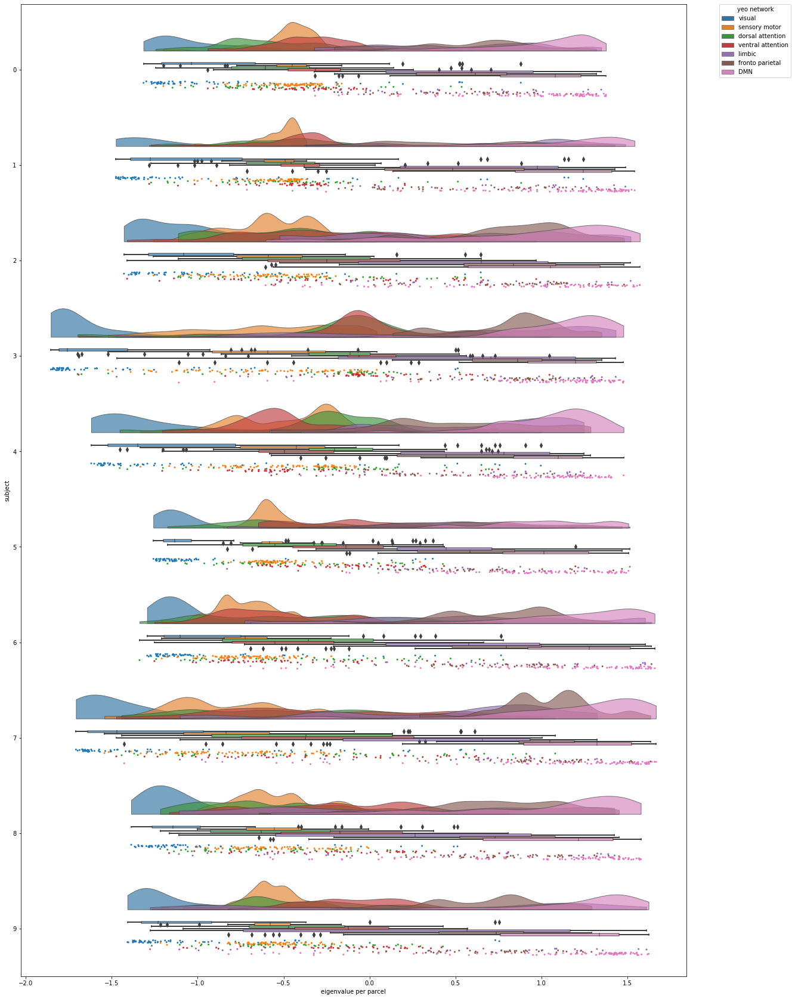

In [241]:
### Organizing the data

df_G1_10sub_pca = pd.DataFrame(array_aligned_G1_pca[0:10].T)

# adding a column containing the Yeo network labels
df_G1_10sub_pca['yeo network'] = yeo7_networks

# renaming the Yeo network labels
df_G1_10sub_pca.loc[df_G1_10sub_pca["yeo network"] == "1", "yeo network"] = "visual"
df_G1_10sub_pca.loc[df_G1_10sub_pca["yeo network"] == "2", "yeo network"] = "sensory motor"
df_G1_10sub_pca.loc[df_G1_10sub_pca["yeo network"] == "3", "yeo network"] = "dorsal attention"
df_G1_10sub_pca.loc[df_G1_10sub_pca["yeo network"] == "4", "yeo network"] = "ventral attention"
df_G1_10sub_pca.loc[df_G1_10sub_pca["yeo network"] == "5", "yeo network"] = "limbic"
df_G1_10sub_pca.loc[df_G1_10sub_pca["yeo network"] == "6", "yeo network"] = "fronto parietal"
df_G1_10sub_pca.loc[df_G1_10sub_pca["yeo network"] == "7", "yeo network"] = "DMN"

# naming the index and resetting it as an index in order to make it callable in the following melt function
df_G1_10sub_pca.index.name = "sub"

# for the RainCloud plots, we need dataframe to have all values to be plotted in 1 column, and labels to be plotted in other columns (max 2)
# using melt() to make dataframe long so that mean eigenvalues per network are in one column, whilst preserving the sub number and sex as ID variables
df_G1_10sub_pca=pd.melt(df_G1_10sub_pca, id_vars=['yeo network'], var_name='subject', value_name='eigenvalue per parcel')


### Plotting 400 parcel eigenvalues (labeled by network) for G1, for first 10 subjects

f,ax=plt.subplots(figsize=(20,30))

ax=pt.RainCloud(x="subject",
                y="eigenvalue per parcel",
                hue="yeo network",
                data=df_G1_10sub_pca,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=False, 
                dodge = True)

print(f'Sex of subjects (from top to bottom): {merged_demographics_cleaned["Gender"].tolist()[0:10]}')

#### Gradient 2

Create a DataFrame containing the Gradient 2 eigenvalues and labelled Yeo 7 networks

In [242]:
# dataframe of the G2 eigenvalues (transposing the original array because we need the 400 parcels to be vertical in the dataframe in order to be labeled with their corresponding Yeo network)
df_G2_pca = pd.DataFrame(array_aligned_G2_pca.T)

# adding a column containing the Yeo network labels
df_G2_pca['yeo network'] = yeo7_networks

# renaming the Yeo network labels
df_G2_pca.loc[df_G2_pca["yeo network"] == "1", "yeo network"] = "visual"
df_G2_pca.loc[df_G2_pca["yeo network"] == "2", "yeo network"] = "sensory motor"
df_G2_pca.loc[df_G2_pca["yeo network"] == "3", "yeo network"] = "dorsal attention"
df_G2_pca.loc[df_G2_pca["yeo network"] == "4", "yeo network"] = "ventral attention"
df_G2_pca.loc[df_G2_pca["yeo network"] == "5", "yeo network"] = "limbic"
df_G2_pca.loc[df_G2_pca["yeo network"] == "6", "yeo network"] = "fronto parietal"
df_G2_pca.loc[df_G2_pca["yeo network"] == "7", "yeo network"] = "DMN"

# obtaining the mean of the parcels with the same Yeo network label, then transposing because we need the 1014 subjects to be vertical in the dataframe in order to be labeled with their corresponding sex 
df_G2_pca = df_G2_pca.groupby("yeo network", as_index=True).mean().T

# adding a column containing the sex labels
df_G2_pca["sex"] = merged_demographics_cleaned["Gender"].tolist()

# naming the index and resetting it as an index in order to make it callable in the following melt function
df_G2_pca.index.name = "sub"
df_G2_pca = df_G2_pca.reset_index()

# for the RainCloud plots, we need dataframe to have all values to be plotted in 1 column, and labels to be plotted in other columns (max 2)
# using melt() to make dataframe long so that mean eigenvalues per network are in one column, whilst preserving the sub number and sex as ID variables
df_G2_pca=pd.melt(df_G2_pca, id_vars=["sub", 'sex'], var_name='yeo network', value_name='mean eigenvalues per yeo network')

# in order to first display across sexes (clouds on the same line), creating another column with only 1s in order to use it as the "group" for dx
df_G2_pca["across sexes"] = [1] * 7098

##### RainCloud plot of mean eigenvalues (G2) for 7 Yeo networks - across sexes

Mean eigenvalues for aligned G2 calculated across parcels belonging to each network (all subjects) 
7098 data points (1014 subjects * 7 networks) 

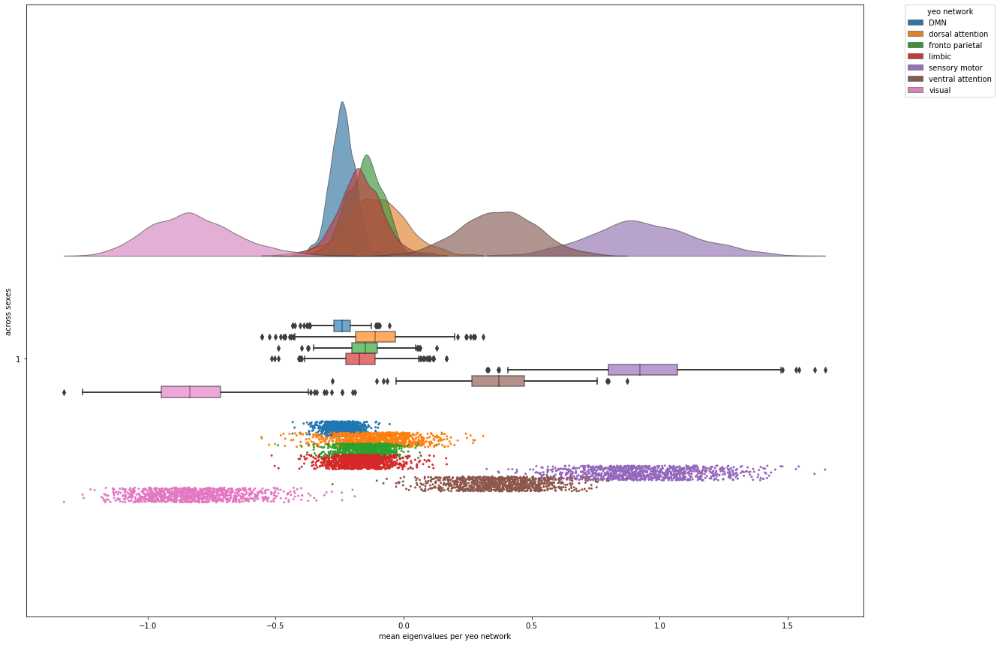

In [243]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="across sexes",
                y="mean eigenvalues per yeo network",
                hue="yeo network",
                data=df_G2_pca,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=False, 
                dodge = True)

##### RainCloud plots of mean eigenvalues (G2) for 7 Yeo networks - by sex

Mean eigenvalues for aligned G2 calculated across parcels belonging to each network (all subjects, displayed by sex) 

7098 data points (1014 subjects * 7 networks) 


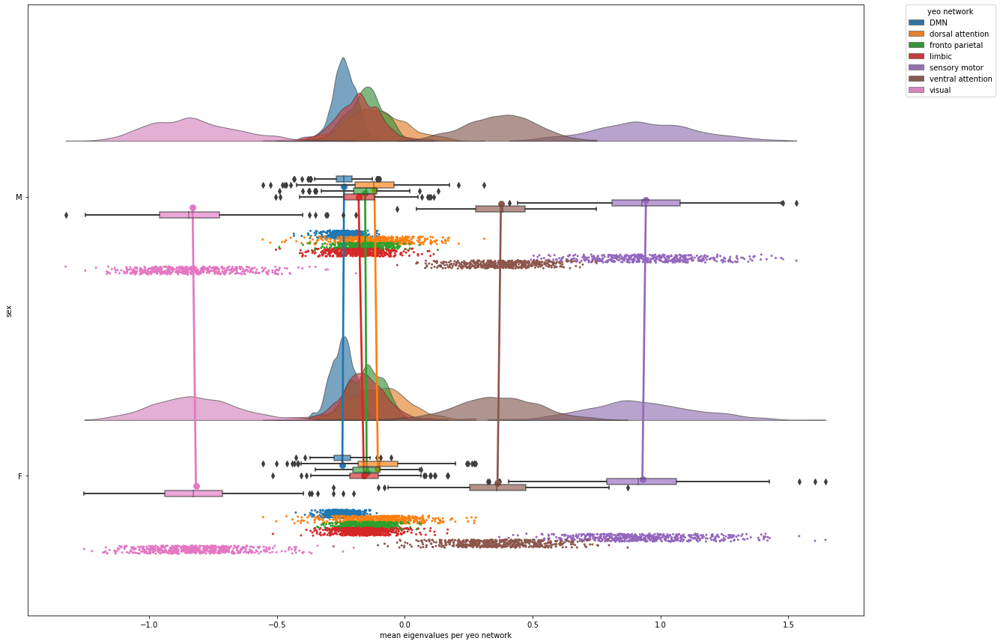

In [244]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="sex",
                y="mean eigenvalues per yeo network",
                hue="yeo network",
                data=df_G2_pca,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=True, 
                dodge = True)

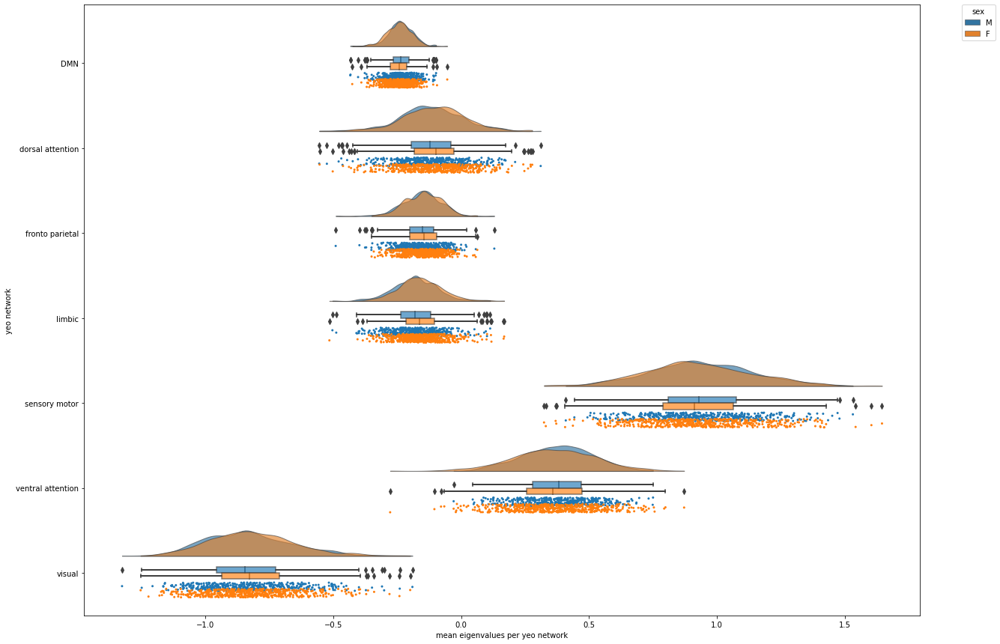

In [245]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="yeo network",
                y="mean eigenvalues per yeo network",
                hue="sex",
                data=df_G2_pca,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65, 
                dodge=True)

#### Gradient 3

Create a DataFrame containing the Gradient 3 eigenvalues and labelled Yeo 7 networks

In [246]:
# dataframe of the G3 eigenvalues (transposing the original array because we need the 400 parcels to be vertical in the dataframe in order to be labeled with their corresponding Yeo network)
df_G3_pca = pd.DataFrame(array_aligned_G3_pca.T)

# adding a column containing the Yeo network labels
df_G3_pca['yeo network'] = yeo7_networks

# renaming the Yeo network labels
df_G3_pca.loc[df_G3_pca["yeo network"] == "1", "yeo network"] = "visual"
df_G3_pca.loc[df_G3_pca["yeo network"] == "2", "yeo network"] = "sensory motor"
df_G3_pca.loc[df_G3_pca["yeo network"] == "3", "yeo network"] = "dorsal attention"
df_G3_pca.loc[df_G3_pca["yeo network"] == "4", "yeo network"] = "ventral attention"
df_G3_pca.loc[df_G3_pca["yeo network"] == "5", "yeo network"] = "limbic"
df_G3_pca.loc[df_G3_pca["yeo network"] == "6", "yeo network"] = "fronto parietal"
df_G3_pca.loc[df_G3_pca["yeo network"] == "7", "yeo network"] = "DMN"

# obtaining the mean of the parcels with the same Yeo network label, then transposing because we need the 1014 subjects to be vertical in the dataframe in order to be labeled with their corresponding sex 
df_G3_pca = df_G3_pca.groupby("yeo network", as_index=True).mean().T

# adding a column containing the sex labels
df_G3_pca["sex"] = merged_demographics_cleaned["Gender"].tolist()

# naming the index and resetting it as an index in order to make it callable in the following melt function
df_G3_pca.index.name = "sub"
df_G3_pca = df_G3_pca.reset_index()

# for the RainCloud plots, we need dataframe to have all values to be plotted in 1 column, and labels to be plotted in other columns (max 2)
# using melt() to make dataframe long so that mean eigenvalues per network are in one column, whilst preserving the sub number and sex as ID variables
df_G3_pca=pd.melt(df_G3_pca, id_vars=["sub", 'sex'], var_name='yeo network', value_name='mean eigenvalues per yeo network')

# in order to first display across sexes (clouds on the same line), creating another column with only 1s in order to use it as the "group" for dx
df_G3_pca["across sexes"] = [1] * 7098

##### RainCloud plots of mean eigenvalues (G3) for 7 Yeo networks - across sexes

Mean eigenvalues for aligned G3 calculated across parcels belonging to each network (all subjects) 
7098 data points (1014 subjects * 7 networks) 

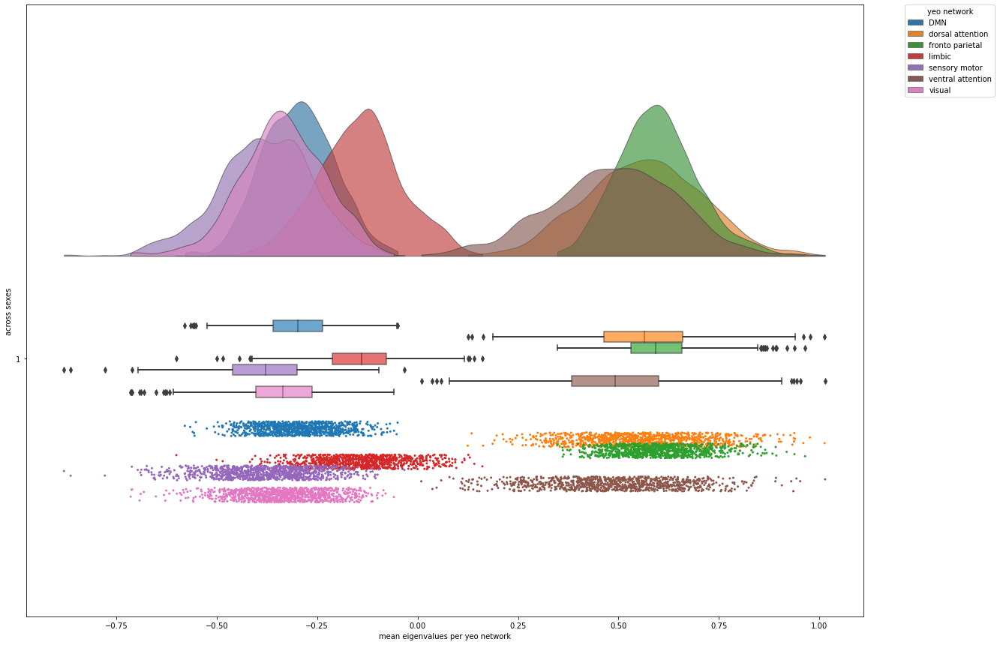

In [247]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="across sexes",
                y="mean eigenvalues per yeo network",
                hue="yeo network",
                data=df_G3_pca,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=False, 
                dodge = True)

##### RainCloud plots of mean eigenvalues (G3) for 7 Yeo networks - by sex

Mean eigenvalues for aligned G3 calculated across parcels belonging to each network (all subjects, displayed by sex) 

7098 data points (1014 subjects * 7 networks) 

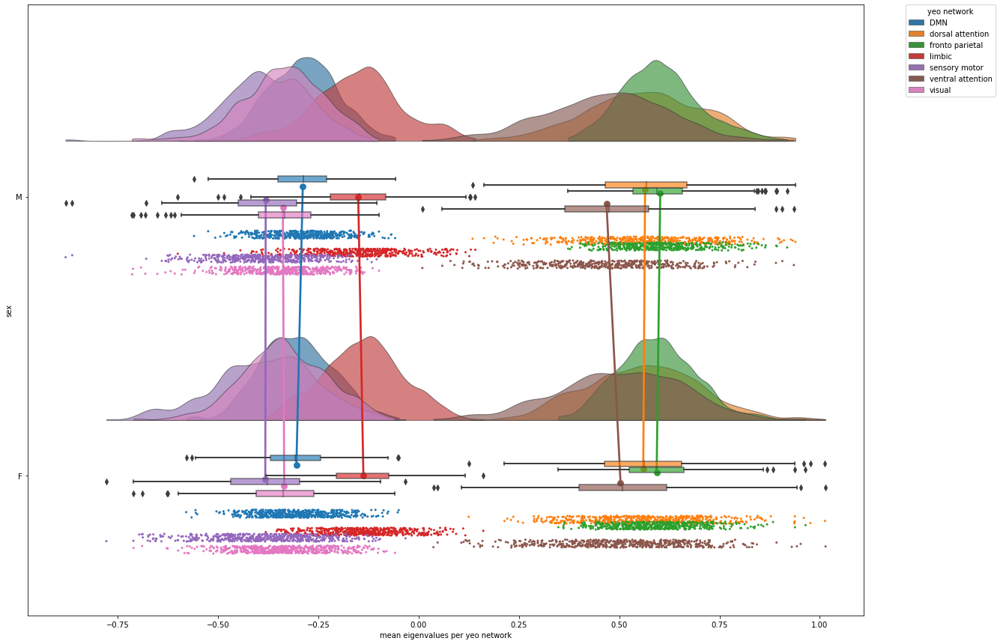

In [248]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="sex",
                y="mean eigenvalues per yeo network",
                hue="yeo network",
                data=df_G3_pca,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=True, 
                dodge = True)

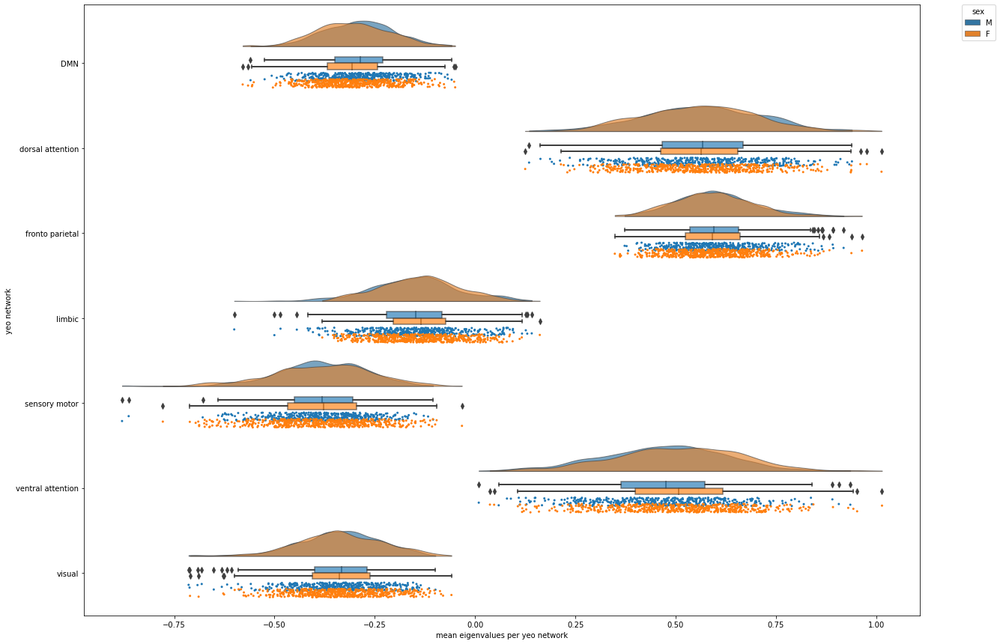

In [249]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="yeo network",
                y="mean eigenvalues per yeo network",
                hue="sex",
                data=df_G3_pca,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65, 
                dodge=True)

### Sex effects (standard linear regression - FDR-corrected - main model: sex + age + ICV)

#### Gradient 1

In [250]:
### fitting the main model

# sex effects including sex, age, and icv in model
slm_SEX_age_icv_pca = SLM(
    model_sex_age_icv,
    contrast = contrast_sex,
    correction=["fdr"],
    two_tailed=True,
)
slm_SEX_age_icv_pca.fit(array_aligned_G1_pca)

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


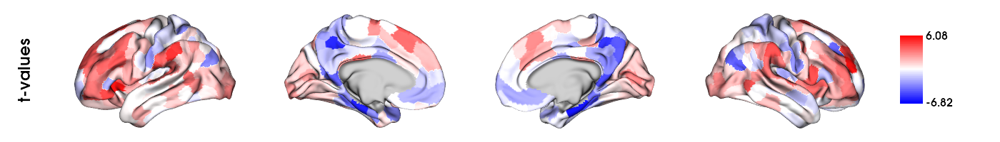

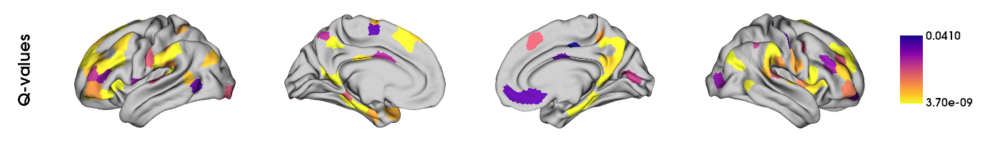

In [251]:
plots_to_display = plot_slm_results(slm_SEX_age_icv_pca)
display(*plots_to_display)

--- ORIGINAL RESULTS ---

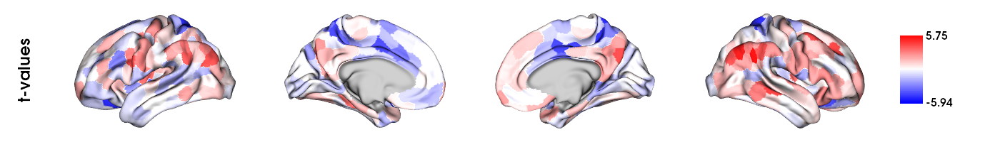

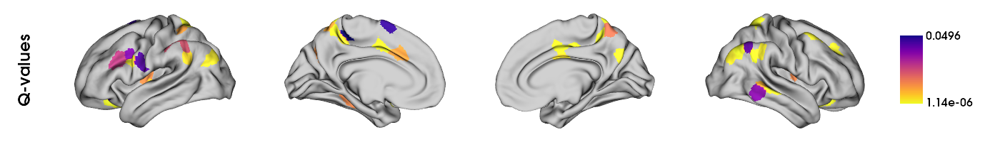

In [252]:
plots_to_display = plot_slm_results(slm_SEX_age_icv)
display(*plots_to_display)

Scatterplot of Gradient 1 eigenvalues (from mean matrix) and t-values for sex contrast in main model (controling for age and icv)

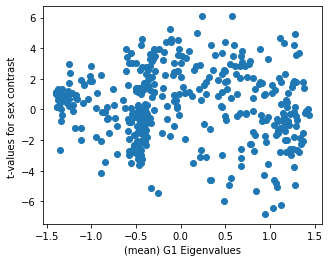

In [253]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(mean_grad_pca.gradients_[:, 0], slm_SEX_age_icv_pca.t[0])

ax.set_xlabel('(mean) G1 Eigenvalues')
ax.set_ylabel('t-values for sex contrast ')

plt.show()

--- ORIGINAL RESULTS ---

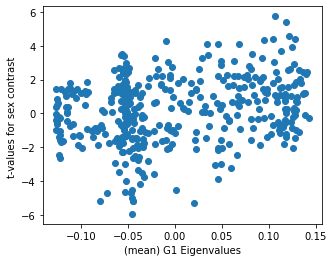

In [254]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(mean_grad.gradients_[:, 0], slm_SEX_age_icv.t[0])

ax.set_xlabel('(mean) G1 Eigenvalues')
ax.set_ylabel('t-values for sex contrast ')

plt.show()

#### Gradient 2

In [255]:
### model terms, contrast (sex differences), main model -> already defined for Gradient 1


### fitting the main model

# sex effects including sex, age, and icv in model
slm_SEX_age_icv_pca = SLM(
    model_sex_age_icv,
    contrast = contrast_sex,
    correction=["fdr"],
    two_tailed=True,
)
slm_SEX_age_icv_pca.fit(array_aligned_G2_pca)

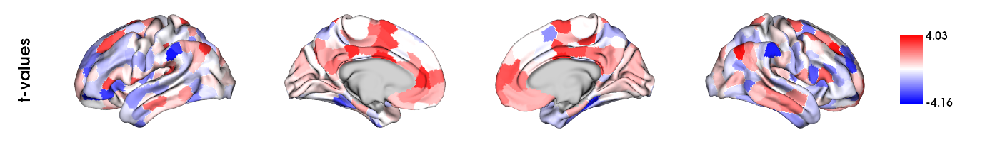

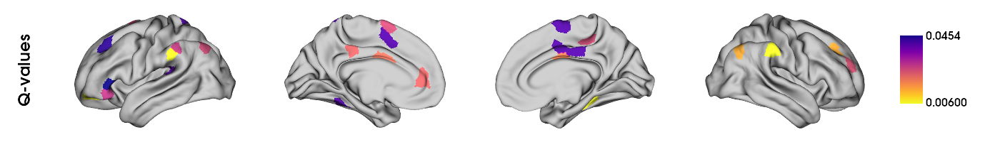

In [256]:
plots_to_display = plot_slm_results(slm_SEX_age_icv_pca)
display(*plots_to_display)

--- ORIGINAL RESULTS ---

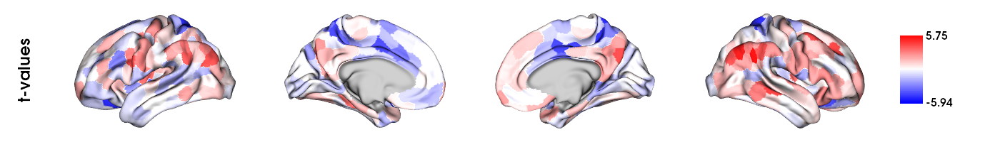

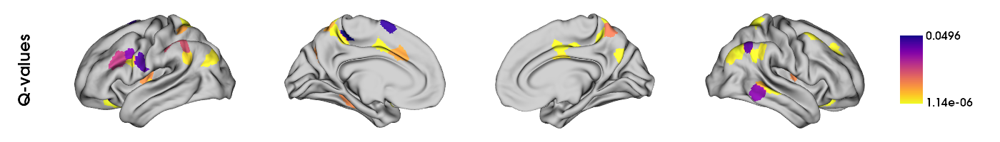

In [257]:
plots_to_display = plot_slm_results(slm_SEX_age_icv)
display(*plots_to_display)

Scatterplot of Gradient 2 eigenvalues (from mean matrix) and t-values for sex contrast in main model (controling for age and icv)

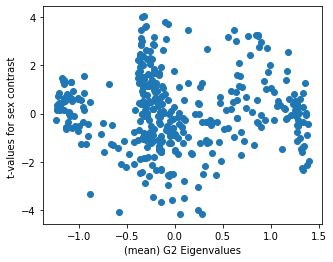

In [258]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(mean_grad_pca.gradients_[:, 1], slm_SEX_age_icv_pca.t[0])

ax.set_xlabel('(mean) G2 Eigenvalues')
ax.set_ylabel('t-values for sex contrast ')

plt.show()

--- ORIGINAL RESULTS ---

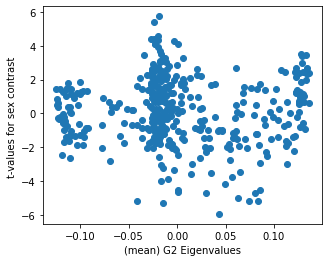

In [259]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(mean_grad.gradients_[:, 1], slm_SEX_age_icv.t[0])

ax.set_xlabel('(mean) G2 Eigenvalues')
ax.set_ylabel('t-values for sex contrast ')

plt.show()

#### Gradient 3

In [260]:
### model terms, contrast (sex differences), main model -> already defined for Gradient 1


### fitting the main model

# sex effects including sex, age, and icv in model
slm_SEX_age_icv_pca = SLM(
    model_sex_age_icv,
    contrast = contrast_sex,
    correction=["fdr"],
    two_tailed=True,
)
slm_SEX_age_icv_pca.fit(array_aligned_G3_pca)

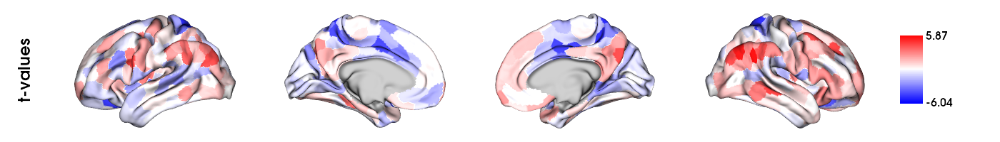

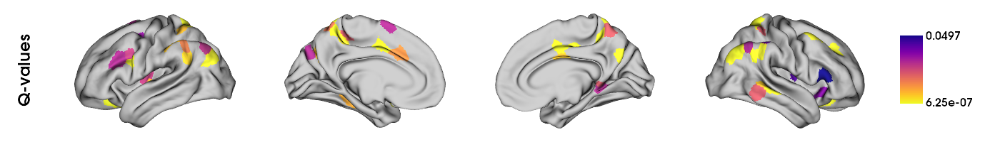

In [261]:
plots_to_display = plot_slm_results(slm_SEX_age_icv_pca)
display(*plots_to_display)

--- ORIGINAL RESUTLS ---

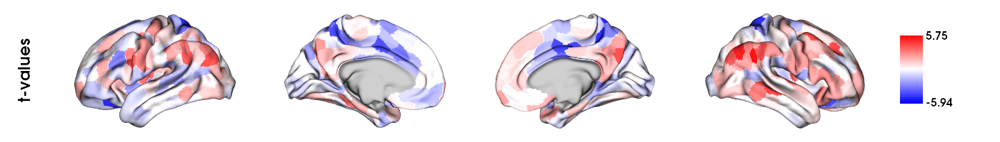

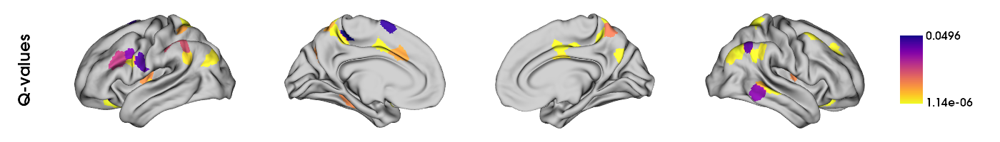

In [262]:
plots_to_display = plot_slm_results(slm_SEX_age_icv)
display(*plots_to_display)

Scatterplot of Gradient 3 eigenvalues (from mean matrix) and t-values for sex contrast in main model (controling for age and icv)

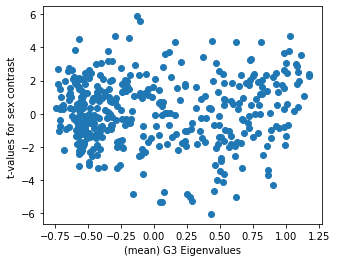

In [263]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(mean_grad_pca.gradients_[:, 2], slm_SEX_age_icv_pca.t[0])

ax.set_xlabel('(mean) G3 Eigenvalues')
ax.set_ylabel('t-values for sex contrast ')

plt.show()

--- ORIGINAL RESULTS ---

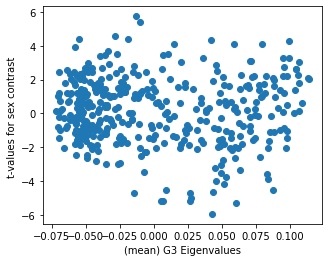

In [264]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(mean_grad.gradients_[:, 2], slm_SEX_age_icv.t[0])

ax.set_xlabel('(mean) G3 Eigenvalues')
ax.set_ylabel('t-values for sex contrast ')

plt.show()

### Unrelated subjects - PCA

#### Construct mean gradients 
(i.e., gradients for the mean matrix)

In [265]:
# GradientMaps function used to build the model parameters
mean_grad_unrel_1_pca = GradientMaps(n_components = 10, random_state = 0, approach = 'pca', kernel = 'normalized_angle')

# fit function used to compute the gradients
mean_grad_unrel_1_pca.fit(mean_fc_matrix_unrel_1)

GradientMaps(approach='pca', kernel='normalized_angle', random_state=0)

Plot 3 first gradients of the mean matrix

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


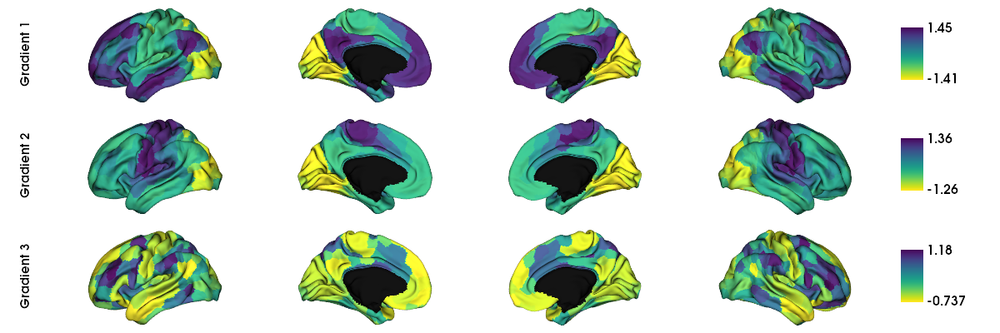

In [266]:
# defining labeling scheme and mask
labeling = load_parcellation('schaefer', scale=400, join=True)
surf_lh, surf_rh = load_conte69()

mask = labeling != 0


# list containing placeholders (None) for the number of gradients I want to plot
grad = [None] * 3

for i in range(3):
    # map the gradient to the parcels
    grad[i] = map_to_labels(mean_grad_unrel_1_pca.gradients_[:, i], labeling, mask=mask, fill=np.nan)  # mean_grad contains 10 .gradients_ (1 gradient per column) - here I take all rows and individual select column based on gradient I want (first 3)

plot_hemispheres(surf_lh, surf_rh, array_name=grad, embed_nb = True, size=(1200, 400), cmap='viridis_r', color_bar=True, label_text=['Gradient 1', 'Gradient 2', 'Gradient 3'], zoom=1.55)

Variance explained by the 10 gradients

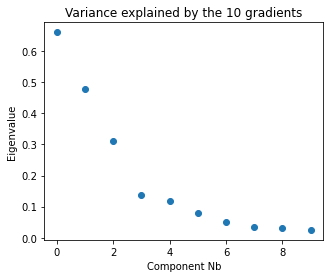

In [267]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(range(mean_grad_unrel_1_pca.lambdas_.size), mean_grad_unrel_1_pca.lambdas_)
ax.set_title("Variance explained by the 10 gradients")
ax.set_xlabel('Component Nb')
ax.set_ylabel('Eigenvalue')

plt.show()

In [268]:
# Scaled variance explained by individual gradients: lambda / total(i.e., sum lambdas) * 100 %
print(f"Total amount of variance explained by the {len(mean_grad_unrel_1_pca.lambdas_)} gradients (uncorrected sum lambdas): {sum(mean_grad_unrel_1_pca.lambdas_):.2f}\n")
print(f"Scaled variance explained by individual gradients:\nG1: {mean_grad_unrel_1_pca.lambdas_[0]/sum(mean_grad_unrel_1_pca.lambdas_)*100:.2f}%\nG2: {mean_grad_unrel_1_pca.lambdas_[1]/sum(mean_grad_unrel_1_pca.lambdas_)*100:.2f}%\nG3: {mean_grad_unrel_1_pca.lambdas_[2]/sum(mean_grad_unrel_1_pca.lambdas_)*100:.2f}%\n")

Total amount of variance explained by the 10 gradients (uncorrected sum lambdas): 1.92

Scaled variance explained by individual gradients:
G1: 34.40%
G2: 24.89%
G3: 16.17%



Scatterplot of the first two gradients, colorcoding displays 3rd gradient (but categorical so not good)

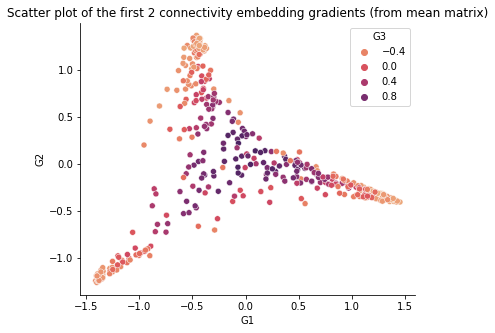

In [269]:
fig, ax = plt.subplots(figsize=(6,5));
ax = sns.scatterplot(x=mean_grad_unrel_1_pca.gradients_[:,0],  # all rows (400 parces), first column (G1)
                     y=mean_grad_unrel_1_pca.gradients_[:,1],  # all rows (400 parces), second column (G2)
                     hue=mean_grad_unrel_1_pca.gradients_[:,2],  # gives color coding based on all rows (400 parces), third column (G3)
                     palette=sns.color_palette("flare", as_cmap=True), 
                     legend=True, ax=ax);
ax.set_xlabel('G1');
ax.set_ylabel('G2');
ax.set_title("Scatter plot of the first 2 connectivity embedding gradients (from mean matrix)")
ax.spines['right'].set_visible(False);
ax.spines['top'].set_visible(False);
plt.legend(title='G3')
plt.show(ax)

##### Aligned gradients

Construct gradients for all subjects (procrustes alignment to the overall mean matrix)

In [270]:
list_aligned_gradients_unrel_1_pca = []  # will contain all participants (1014), all parcels (400), all gradients (10)
list_aligned_G1_unrel_1_pca = []  # will contain all participants (1014), all parcels (400) -> values = eigenvalues for GRADIENT 1
list_aligned_G2_unrel_1_pca = []  # will contain all participants (1014), all parcels (400) -> values = eigenvalues for GRADIENT 2
list_aligned_G3_unrel_1_pca = []  # will contain all participants (1014), all parcels (400) -> values = eigenvalues for GRADIENT 3
  
# loop over all the fc matrices
for i in range(len(fc_matrices_400_unrel_1)):
    # setting model parameters for gradients to be computed across subjects - with procrustes alignment
    grad_procr_pca = GradientMaps(n_components=10, random_state=0, approach='pca', kernel='normalized_angle', alignment='procrustes')  # specify alignment method here (procrustes)

    # computing
    # note that by using an alignment method, .fit yields a variable (grad_procr) containing both types of gradients, callable with: .gradients_ (original) and .aligned_ (aligned - use this for analyses)
    grad_procr_pca.fit(fc_matrices_400[i], reference=mean_grad_pca.gradients_)  # align to the gradients of the gradients produced by the mean matrix (reference) 

    # append array to lists results (.T is necessary in order to be able to first access the gradients layer (10) so that can index the desired gradient, which will then contain all the parcels (400)
    list_aligned_gradients_unrel_1_pca.append(grad_procr_pca.aligned_)
    list_aligned_G1_unrel_1_pca.append(grad_procr_pca.aligned_.T[0])
    list_aligned_G2_unrel_1_pca.append(grad_procr_pca.aligned_.T[1])
    list_aligned_G3_unrel_1_pca.append(grad_procr_pca.aligned_.T[2])
    
# make gradient lists into arrays (for analyses)    
array_aligned_gradients_unrel_1_pca = np.array(list_aligned_gradients_unrel_1_pca)
array_aligned_G1_unrel_1_pca = np.array(list_aligned_G1_unrel_1_pca)
array_aligned_G2_unrel_1_pca = np.array(list_aligned_G2_unrel_1_pca)
array_aligned_G3_unrel_1_pca = np.array(list_aligned_G3_unrel_1_pca)

#### Sex effects (standard linear regression - FDR-corrected - main model: sex + age + ICV)

##### Gradient 1

In [271]:
### fitting the main model

# sex effects including sex, age, and icv in model
slm_SEX_age_icv_unrel_1_pca = SLM(
    model_sex_age_icv_unrel_1,
    contrast = contrast_sex_unrel_1,
    correction=["fdr"],
    two_tailed=True,
)
slm_SEX_age_icv_unrel_1_pca.fit(array_aligned_G1_unrel_1_pca)

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/utils.py:303: RuntimeWarning: All-NaN axis encountered
  a, b = np.nanmin(x), np.nanmax(x)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/utils.py:367: RuntimeWarning: All-NaN slice encountered
  specs['min'][:] = np.nanmin(specs['min'], axis=ax, keepdims=True)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/utils.py:368: RuntimeWarning: All-NaN slice encountered
  specs['max'][:] = np.nanmax(specs['max'], axis=ax, keepdims=True)


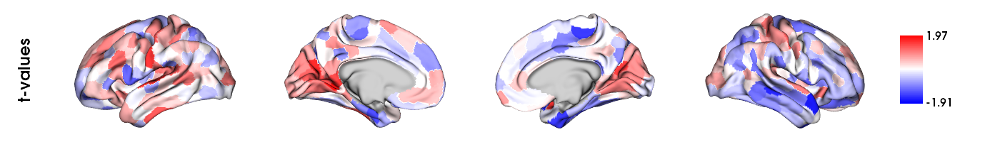

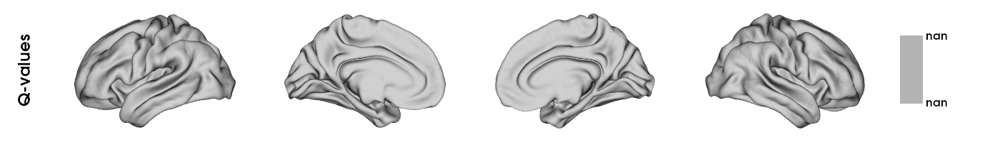

In [272]:
plots_to_display = plot_slm_results(slm_SEX_age_icv_unrel_1_pca)
display(*plots_to_display)

Scatterplot of Gradient 1 eigenvalues (from mean matrix) and t-values for sex contrast in main model (controling for age and icv)

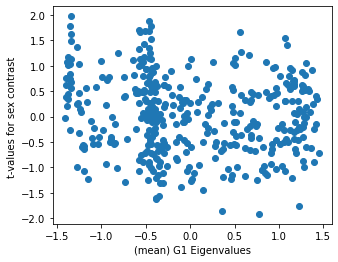

In [273]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(mean_grad_unrel_1_pca.gradients_[:, 0], slm_SEX_age_icv_unrel_1_pca.t[0])

ax.set_xlabel('(mean) G1 Eigenvalues')
ax.set_ylabel('t-values for sex contrast ')

plt.show()

--- ORIGINAL RESULTS (unrelated / diffusion embedding: ---

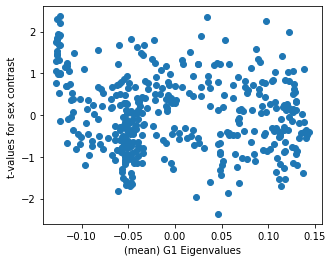

In [274]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(mean_grad_unrel_1.gradients_[:, 0], slm_SEX_age_icv_unrel_1.t[0])

ax.set_xlabel('(mean) G1 Eigenvalues')
ax.set_ylabel('t-values for sex contrast ')

plt.show()

##### Gradient 2

In [275]:
### model terms, contrast (sex differences), main model -> already defined for Gradient 1


### fitting the main model

# sex effects including sex, age, and icv in model
slm_SEX_age_icv_unrel_1_pca = SLM(
    model_sex_age_icv_unrel_1,
    contrast = contrast_sex_unrel_1,
    correction=["fdr"],
    two_tailed=True,
)
slm_SEX_age_icv_unrel_1_pca.fit(array_aligned_G2_unrel_1_pca)

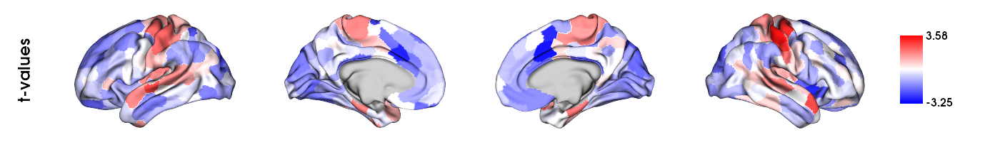

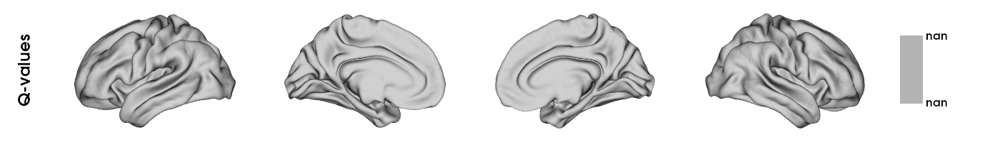

In [276]:
plots_to_display = plot_slm_results(slm_SEX_age_icv_unrel_1_pca)
display(*plots_to_display)

Scatterplot of Gradient 2 eigenvalues (from mean matrix) and t-values for sex contrast in main model (controling for age and icv)

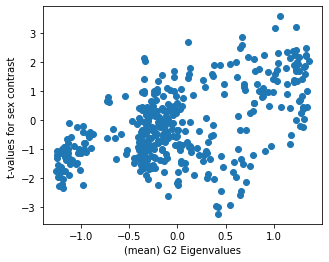

In [277]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(mean_grad_unrel_1_pca.gradients_[:, 1], slm_SEX_age_icv_unrel_1_pca.t[0])

ax.set_xlabel('(mean) G2 Eigenvalues')
ax.set_ylabel('t-values for sex contrast ')

plt.show()

--- ORIGINAL RESULTS (unrelated / diffusion embedding: ---

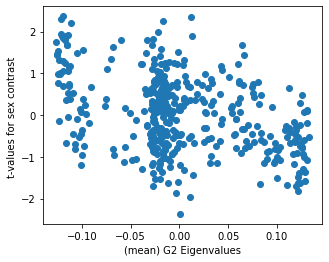

In [278]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(mean_grad_unrel_1.gradients_[:, 1], slm_SEX_age_icv_unrel_1.t[0])

ax.set_xlabel('(mean) G2 Eigenvalues')
ax.set_ylabel('t-values for sex contrast ')

plt.show()

##### Gradient 3

In [279]:
### model terms, contrast (sex differences), main model -> already defined for Gradient 1


### fitting the main model

# sex effects including sex, age, and icv in model
slm_SEX_age_icv_unrel_1_pca = SLM(
    model_sex_age_icv_unrel_1,
    contrast = contrast_sex_unrel_1,
    correction=["fdr"],
    two_tailed=True,
)
slm_SEX_age_icv_unrel_1_pca.fit(array_aligned_G3_unrel_1_pca)

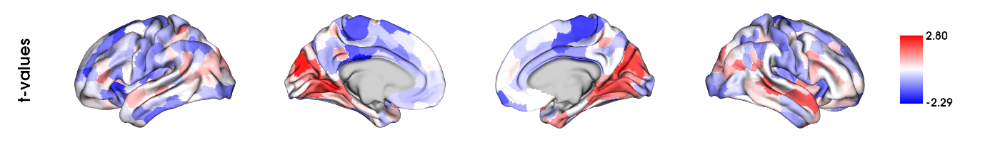

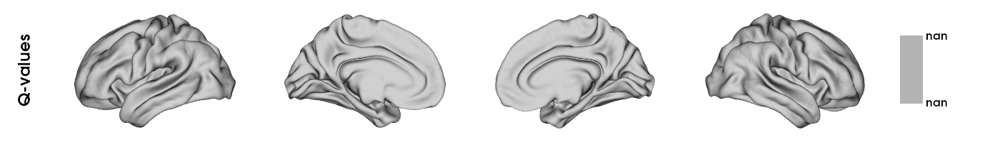

In [280]:
plots_to_display = plot_slm_results(slm_SEX_age_icv_unrel_1_pca)
display(*plots_to_display)

Scatterplot of Gradient 3 eigenvalues (from mean matrix) and t-values for sex contrast in main model (controling for age and icv)

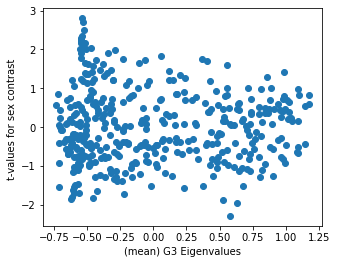

In [281]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(mean_grad_unrel_1_pca.gradients_[:, 2], slm_SEX_age_icv_unrel_1_pca.t[0])

ax.set_xlabel('(mean) G3 Eigenvalues')
ax.set_ylabel('t-values for sex contrast ')

plt.show()

--- ORIGINAL RESULTS (unrelated / diffusion embedding: ---

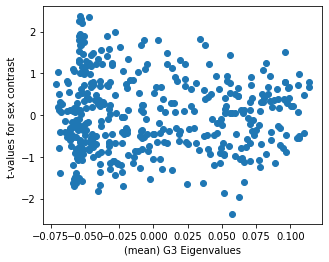

In [282]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(mean_grad_unrel_1.gradients_[:, 2], slm_SEX_age_icv_unrel_1.t[0])

ax.set_xlabel('(mean) G3 Eigenvalues')
ax.set_ylabel('t-values for sex contrast ')

plt.show()

## Non-Aligned gradients

### Construct gradients for all subjects (not aligning to see impact on sex effects)

In [283]:
list_NONaligned_gradients = []  # will contain all participants (1014), all parcels (400), all gradients (10)
list_NONaligned_G1 = []  # will contain all participants (1014), all parcels (400) -> values = eigenvalues for GRADIENT 1
list_NONaligned_G2 = []  # will contain all participants (1014), all parcels (400) -> values = eigenvalues for GRADIENT 2
list_NONaligned_G3 = []  # will contain all participants (1014), all parcels (400) -> values = eigenvalues for GRADIENT 3
  
# loop over all the fc matrices
for i in range(len(fc_matrices_400)):
    # setting model parameters for gradients to be computed across subjects - with procrustes alignment
    grad = GradientMaps(n_components=10, random_state=0, approach='dm', kernel='normalized_angle') 

    # computing
    # note that by using an alignment method, .fit yields a variable (grad_procr) containing both types of gradients, callable with: .gradients_ (original) and .aligned_ (aligned - use this for analyses)
    grad.fit(fc_matrices_400[i], reference=mean_grad.gradients_)  # align to the gradients of the gradients produced by the mean matrix (reference) 

    # append array to lists results (.T is necessary in order to be able to first access the gradients layer (10) so that can index the desired gradient, which will then contain all the parcels (400)
    list_NONaligned_gradients.append(grad.gradients_)
    list_NONaligned_G1.append(grad.gradients_.T[0])
    list_NONaligned_G2.append(grad.gradients_.T[1])
    list_NONaligned_G3.append(grad.gradients_.T[2])
    
# make gradient lists into arrays (for analyses)    
array_NONaligned_gradients = np.array(list_NONaligned_gradients)
array_NONaligned_G1 = np.array(list_NONaligned_G1)
array_NONaligned_G2 = np.array(list_NONaligned_G2)
array_NONaligned_G3 = np.array(list_NONaligned_G3)

### Sex effects

#### Gradient 1

In [284]:
### creating model terms

term_sex = FixedEffect(merged_demographics_cleaned.Gender)
term_age = FixedEffect(merged_demographics_cleaned.Age_in_Yrs)
term_icv = FixedEffect(merged_demographics_cleaned.FS_IntraCranial_Vol)


### defining contrast to test: sex differences

contrast_sex = (merged_demographics_cleaned.Gender == "M").astype(int) - (merged_demographics_cleaned.Gender == "F").astype(int)  # makes M = 1 and F = -1


### defining the main model 

model_sex_age_icv = term_sex + term_age + term_icv  


### fitting the main model

# sex effects including sex, age, and icv in model
slm_SEX_age_icv = SLM(
    model_sex_age_icv,
    contrast = contrast_sex,
    correction=["fdr"],
    two_tailed=True,
)
slm_SEX_age_icv.fit(array_NONaligned_G1)

In [285]:
slm_SEX_age_icv.Q

array([1.        , 0.6015344 , 1.        , 1.        , 1.        ,
       1.        , 0.6015344 , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 0.73560289,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       0.18192379, 1.        , 1.        , 0.62154314, 1.     

In [286]:
sig = []
for i in range(len(slm_SEX_age_icv.Q)):
    if slm_SEX_age_icv.Q[i] < 0.05:
        sig.append(slm_SEX_age_icv.Q)
        
print(f"Number of significant parcels: {len(sig)}")

Number of significant parcels: 13


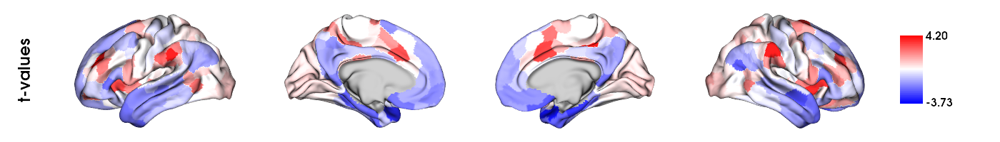

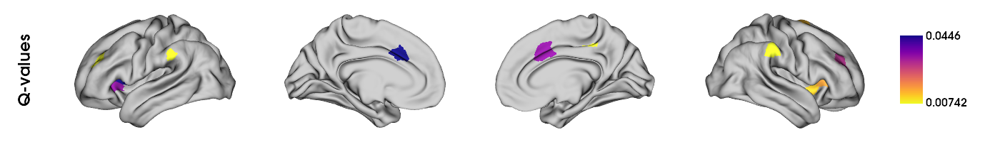

In [287]:
plots_to_display = plot_slm_results(slm_SEX_age_icv)
display(*plots_to_display)

Scatterplot of Gradient 1 eigenvalues (from mean matrix) and t-values for sex contrast in main model (controling for age and icv)

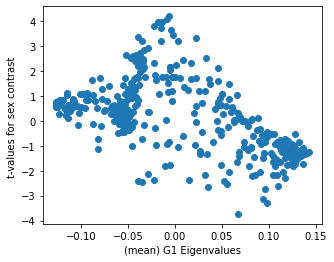

In [288]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(mean_grad.gradients_[:, 0], slm_SEX_age_icv.t[0])

ax.set_xlabel('(mean) G1 Eigenvalues')
ax.set_ylabel('t-values for sex contrast ')

plt.show()

#### Gradient 2

In [289]:
slm_SEX_age_icv.fit(array_NONaligned_G2)

In [290]:
slm_SEX_age_icv.Q

array([1.        , 0.96958303, 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       0.93360832, 0.93360832, 0.94879069, 1.        , 1.        ,
       1.        , 0.93360832, 1.        , 1.        , 1.        ,
       1.        , 1.        , 0.93360832, 0.93360832, 1.        ,
       1.        , 1.        , 0.93360832, 1.        , 1.        ,
       0.93908282, 0.87549816, 1.        , 1.        , 1.     

In [291]:
sig = []
for i in range(len(slm_SEX_age_icv.Q)):
    if slm_SEX_age_icv.Q[i] < 0.05:
        sig.append(slm_SEX_age_icv.Q)
        
print(f"Number of significant parcels: {len(sig)}")

Number of significant parcels: 0


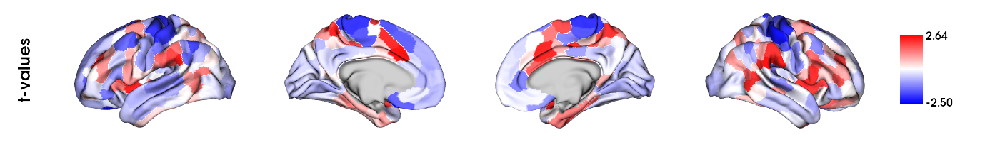

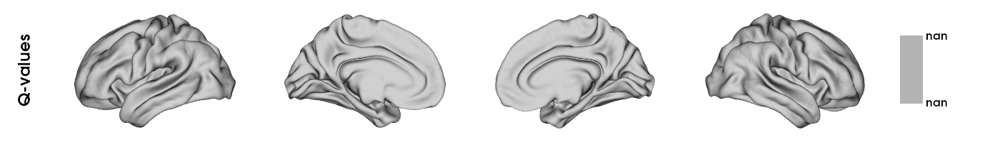

In [292]:
plots_to_display = plot_slm_results(slm_SEX_age_icv)
display(*plots_to_display)

Scatterplot of Gradient 1 eigenvalues (from mean matrix) and t-values for sex contrast in main model (controling for age and icv)

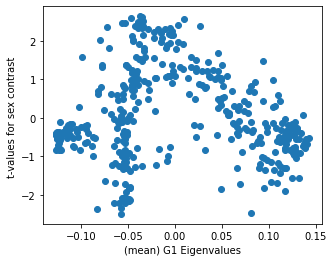

In [293]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(mean_grad.gradients_[:, 0], slm_SEX_age_icv.t[0])

ax.set_xlabel('(mean) G1 Eigenvalues')
ax.set_ylabel('t-values for sex contrast ')

plt.show()

#### Gradient 3

In [294]:
slm_SEX_age_icv.fit(array_NONaligned_G3)

In [295]:
slm_SEX_age_icv.Q

array([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1.

In [296]:
sig = []
for i in range(len(slm_SEX_age_icv.Q)):
    if slm_SEX_age_icv.Q[i] < 0.05:
        sig.append(slm_SEX_age_icv.Q)
        
print(f"Number of significant parcels: {len(sig)}")

Number of significant parcels: 0


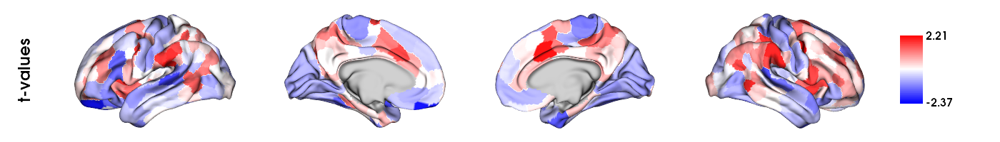

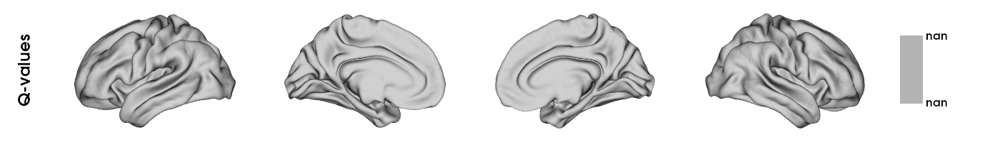

In [297]:
plots_to_display = plot_slm_results(slm_SEX_age_icv)
display(*plots_to_display)

Scatterplot of Gradient 1 eigenvalues (from mean matrix) and t-values for sex contrast in main model (controling for age and icv)

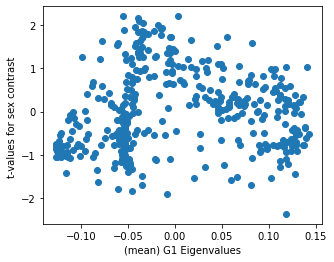

In [298]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(mean_grad.gradients_[:, 0], slm_SEX_age_icv.t[0])

ax.set_xlabel('(mean) G1 Eigenvalues')
ax.set_ylabel('t-values for sex contrast ')

plt.show()

### **SUMMARY results with unaligned gradients:**
When not aligning, losing a lot of significant parcels for gradient 1 (94 -> 13) and all significance for gradient 2 (previously 17) and 3 (previously 48)

# Heritability Analyses

## Preparing the data

Creating a new column (Zygosity) which merges ZygositySR (self-reported) and Zygosity GT (determined via genotyping)

In [299]:
# ZygosityGT (determined via genotyping) should be given precedence over ZygositySR (self-reported) 
  # Genotyping was only done when both subjects in a twin pair to have HasGT=TRUE to have a value (if genotyping is not available for either of a twin pair, no values are given for ZygosityGT)
  # Non-twin subjects also do not have a value for ZygosityGT
  # Note that some subjects self-reported as dizygotic twins (ZygositySR='NotMZ') but genotyping established that they were monozygotic twins (thence ZygosityGT='MZ' for those subjects)
    
conditions = [merged_demographics_cleaned.ZygosityGT == 'MZ',
              merged_demographics_cleaned.ZygosityGT == 'DZ',
              (merged_demographics_cleaned.ZygosityGT == ' ') & (merged_demographics_cleaned.ZygositySR == 'MZ'),
              (merged_demographics_cleaned.ZygosityGT == ' ') & (merged_demographics_cleaned.ZygositySR == 'NotMZ'),
              (merged_demographics_cleaned.ZygosityGT == ' ') & (merged_demographics_cleaned.ZygositySR == 'NotTwin'),
              (merged_demographics_cleaned.ZygosityGT == ' ') & (merged_demographics_cleaned.ZygositySR == ' ')]

values = ['MZ', 'DZ', 'MZ', 'DZ', 'NotTwin', 'N/A']

merged_demographics_cleaned['Zygosity'] = np.select(conditions, values)

Make a list containing the family IDs that have multiple siblings

In [349]:
family_IDs = []  # contains all family IDs (without duplicates)
family_IDs_related = []  # contains family IDs of subjects that have relatives in sample ("duplicated" family IDs) - each ID appearing only 1x

# loop over all subjects
for i in range(len(merged_demographics_cleaned)):
   
    # conditions to append family ID in family_IDs_related df:
    # if the current sub's family ID is already in the family_IDs, it means that we have looped over this family ID before therefore there are siblings sharing this family_ID in the dataset; AND
    # because we don't want duplicate family IDs in family_IDs_related: if the current sub's family ID is not yet in family_IDs_related -> we need to append it
    if (merged_demographics_cleaned.Family_ID.iloc[i] in family_IDs) & (merged_demographics_cleaned.Family_ID.iloc[i] not in family_IDs_related):
        family_IDs_related.append(merged_demographics_cleaned.Family_ID.iloc[i])
    
    if merged_demographics_cleaned.Family_ID.iloc[i] not in family_IDs: 
        family_IDs.append(merged_demographics_cleaned.Family_ID.iloc[i])

In [300]:
family_IDs = []  # contains all family IDs
family_IDs_related = []  # contains family IDs of subjects that have relatives in sample ("duplicated" family IDs) - each ID appearing only 1x

for i in range(len(merged_demographics_cleaned)):
   
    if merged_demographics_cleaned.iloc[i,4] not in family_IDs:
        family_IDs_related.append(merged_demographics_cleaned.iloc[i,4])
        
    family_IDs.append(merged_demographics_cleaned.iloc[i,4])
               

In [346]:
len(merged_demographics_cleaned.Family_ID)

1014

In [347]:
len(family_IDs)

430

In [348]:
len(family_IDs_related)

347

In [312]:
merged_demographics_cleaned

,Release,Acquisition,Gender,Age,3T_Full_MR_Compl,T1_Count,T2_Count,3T_RS-fMRI_Count,3T_RS-fMRI_PctCompl,3T_Full_Task_fMRI,...,SSAGA_Times_Used_Stimulants,SSAGA_Mj_Use,SSAGA_Mj_Ab_Dep,SSAGA_Mj_Age_1st_Use,SSAGA_Mj_Times_Used,Unnamed: 201,Unnamed: 202,Unnamed: 203,age_2y_bins,Zygosity
Subject,,,,,,,,,,,,,,,,,,,,,
100206,S900,Q11,M,26-30,True,1,1,4,100.0,True,...,0.0,0.0,0.0,NaN,0.0,NaN,NaN,NaN,2,NotTwin
100307,Q1,Q01,F,26-30,True,1,1,4,100.0,True,...,0.0,1.0,0.0,2.0,1.0,NaN,NaN,NaN,2,MZ
100408,Q3,Q03,M,31-35,True,1,1,4,100.0,True,...,0.0,1.0,1.0,2.0,4.0,NaN,NaN,NaN,4,MZ
100610,S900,Q08,M,26-30,True,2,1,4,100.0,True,...,0.0,0.0,0.0,NaN,0.0,NaN,NaN,NaN,2,DZ
101006,S500,Q06,F,31-35,True,2,2,4,100.0,True,...,0.0,1.0,0.0,2.0,5.0,NaN,NaN,NaN,5,MZ
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
992673,S900,Q12,F,31-35,True,1,2,4,100.0,True,...,0.0,0.0,0.0,NaN,0.0,NaN,NaN,NaN,4,NotTwin
992774,Q2,Q02,M,31-35,True,2,2,4,100.0,True,...,0.0,1.0,0.0,3.0,2.0,NaN,NaN,NaN,5,NotTwin
993675,S900,Q09,F,26-30,True,2,2,4,100.0,True,...,0.0,0.0,0.0,NaN,0.0,NaN,NaN,NaN,3,NotTwin


In [308]:
family_IDs_related

[True, False]

Make dataframes of MZ, DZ, DZ_ss, DZ_os

In [350]:
# lists of lists containing (in order): (family_ID), subject ID, sex, array of G1 eigenvalues for each twin
MZ = []
DZ = []


# looping over every family_ID that contains multiple siblings in sample
for ID in family_IDs_related:

    # creating/emptying the temp lists for the current family ID 
    temp_list_MZ = []
    temp_list_DZ = []
    
    # creating a condition as a marker to know when to append the family ID to the temp_list (only do it for the first sibling)
    first_sibling = True

    # loop over the number of subjects who share the same family ID
    for i in range(len(merged_demographics_cleaned.loc[merged_demographics_cleaned['Family_ID'] == ID])):

        ######################################################################
        ##### CAN DELETE AT SOME POINT #####

        # Zygosity
        #print(merged_demographics_cleaned.loc[merged_demographics_cleaned['Family_ID'] == ID].loc[:,'Zygosity'].iloc[i])

        # Family ID
        #print(merged_demographics_cleaned.loc[merged_demographics_cleaned['Family_ID'] == ID].loc[:,'Family_ID'].iloc[i])

        # Gender
        #print(merged_demographics_cleaned.loc[merged_demographics_cleaned['Family_ID'] == ID].loc[:,'Gender'].iloc[i])    

        # Subject ID
        #print(merged_demographics_cleaned.loc[merged_demographics_cleaned['Family_ID'] == ID].index[i])

        ######################################################################


        # if zygosity == MZ
        if merged_demographics_cleaned.loc[merged_demographics_cleaned['Family_ID'] == ID].loc[:,'Zygosity'].iloc[i] == 'MZ':

            ## append to MZ list

            # family ID of the current twin
            if first_sibling:
                temp_list_MZ.append(merged_demographics_cleaned.loc[merged_demographics_cleaned['Family_ID'] == ID].loc[:,'Family_ID'].iloc[i])
                first_sibling = False
                
            # subject ID of current twin 
            temp_list_MZ.append(merged_demographics_cleaned.loc[merged_demographics_cleaned['Family_ID'] == ID].index[i])

            # sex of currenz twin
            temp_list_MZ.append(merged_demographics_cleaned.loc[merged_demographics_cleaned['Family_ID'] == ID].loc[:,'Gender'].iloc[i])
            
            # G1 eigenvalues of current twin
            temp_index_sub = merged_demographics_cleaned.index.get_loc(merged_demographics_cleaned.loc[merged_demographics_cleaned['Family_ID'] == ID].index[i])  # retrieving the position of the subject (ID) in the restricted df           
            temp_list_MZ.append(array_aligned_G1[temp_index_sub])  # append aligned array of G1 eigenvalues of current twin (based on retrieved index)

            
        # if zygosity == DZ        
        elif merged_demographics_cleaned.loc[merged_demographics_cleaned['Family_ID'] == ID].loc[:,'Zygosity'].iloc[i] == 'DZ':

            ## append to DZ list

            # family ID of the current twin
            if first_sibling:
                temp_list_DZ.append(merged_demographics_cleaned.loc[merged_demographics_cleaned['Family_ID'] == ID].loc[:,'Family_ID'].iloc[i])
                first_sibling = False
                
            # append subject ID of current twin 
            temp_list_DZ.append(merged_demographics_cleaned.loc[merged_demographics_cleaned['Family_ID'] == ID].index[i])

            # append sex of current twin
            temp_list_DZ.append(merged_demographics_cleaned.loc[merged_demographics_cleaned['Family_ID'] == ID].loc[:,'Gender'].iloc[i])

            # G1 eigenvalues of current twin
            temp_index_sub = merged_demographics_cleaned.index.get_loc(merged_demographics_cleaned.loc[merged_demographics_cleaned['Family_ID'] == ID].index[i])  # retrieving the position of the subject (ID) in the restricted df           
            temp_list_DZ.append(array_aligned_G1[temp_index_sub])  # append aligned array of G1 eigenvalues of current twin (based on retrieved index)

            
    # after done looping over subjects from the same family, append temp_list(s) that is/are not empty to main list(s)
    if len(temp_list_MZ) != 0:
        MZ.append(temp_list_MZ)
        
    if len(temp_list_DZ) != 0:
        DZ.append(temp_list_DZ)

        
        
# lists of lists containing (in order): (family_ID), subject ID, sex, array of G1 eigenvalues for each twin
DZ_ss = []  # same sex 
DZ_os = []  # opposite sex

# finding the position of the sex information in DZ sublists (taking first DZ (DZ[0] sublist as example - assuming that DZ[0] has 2 siblings ( / ! \ this is hardcoded  / ! \ ))
# this code triggers the following warning (may not work in future): /tmp/ipykernel_4937/2498638235.py:93: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison, sex_index_twin_1 = [index for index, value in enumerate(DZ[0]) if value == 'M' or value == 'F'][0]
sex_index_twin_1 = [index for index, value in enumerate(DZ[0]) if value == 'M' or value == 'F'][0]
sex_index_twin_2 = [index for index, value in enumerate(DZ[0]) if value == 'M' or value == 'F'][1]

# establishing when there is more than 1 subject (taking first DZ (DZ[0] sublist as example - assuming that DZ[0] has 2 siblings ( / ! \ this is hardcoded  / ! \ ))
two_siblings = len(DZ[0])

for i in range(len(DZ)):

    # if there is more than 1 subject in sublist
    if len(DZ[i]) >= two_siblings:
        
        # if sex twin 1 == sex twin 2, append to DZss list
        if DZ[i][sex_index_twin_1] == DZ[i][sex_index_twin_2]:
            DZ_ss.append(DZ[i])
        
        else:
            DZ_os.append(DZ[i])

/tmp/ipykernel_9152/2650734397.py:94: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  sex_index_twin_1 = [index for index, value in enumerate(DZ[0]) if value == 'M' or value == 'F'][0]
/tmp/ipykernel_9152/2650734397.py:95: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  sex_index_twin_2 = [index for index, value in enumerate(DZ[0]) if value == 'M' or value == 'F'][1]


In [354]:
DZ

[['51750_81614',
  109123,
  'M',
  array([-5.84162403e-02, -3.80388502e-02, -8.38972437e-02, -1.02539974e-01,
         -9.96912651e-02, -7.89114716e-02, -4.52137024e-02, -8.00760760e-02,
         -9.24718505e-02, -1.03093886e-01, -1.05345070e-01, -2.04562408e-02,
         -9.14123808e-02, -8.57717253e-02, -7.62697761e-02, -1.03688857e-01,
         -6.07293876e-02, -9.97897035e-02, -8.58202961e-02,  2.15236012e-02,
         -9.67857088e-02, -9.88393471e-02, -8.23994783e-02, -1.03164518e-01,
         -1.01934853e-01, -1.01053711e-01, -1.00636135e-01, -4.46032146e-02,
         -1.00180680e-01, -9.93901378e-02, -9.12877389e-02, -5.71797084e-02,
         -7.30258393e-02, -6.31572609e-02, -7.26559745e-02, -6.69284093e-02,
         -6.40789703e-02, -8.42187866e-02, -6.77051822e-02, -4.91890797e-02,
         -5.73581059e-02, -4.70605396e-02, -6.46709949e-02, -6.45742618e-02,
         -5.87018749e-02, -5.44310518e-02, -6.75921531e-02, -6.90524545e-02,
         -5.28194853e-02, -6.72608965e-02,

In [352]:
## make dataframes (cleaned, i.e., containing 2 siblings minimum (i.e., without NAs - DZ_ss and DZ_os already only contain twin pairs)

# overall 

MZ_cleaned = pd.DataFrame(MZ, columns = ['family_id', 'twin_1_id', 'twin_1_sex', 'twin_1_G1_eigenvalues', 'twin_2_id', 'twin_2_sex', 'twin_2_G1_eigenvalues'])
MZ_cleaned = MZ_cleaned.dropna(axis=0)
MZ_cleaned = MZ_cleaned.reset_index(drop=True)  # need to reset index otherwise index of dropped rows is missing

DZ_cleaned = pd.DataFrame(DZ, columns = ['family_id', 'twin_1_id', 'twin_1_sex', 'twin_1_G1_eigenvalues', 'twin_2_id', 'twin_2_sex', 'twin_2_G1_eigenvalues'])
DZ_cleaned = DZ_cleaned.dropna(axis=0)
DZ_cleaned = DZ_cleaned.reset_index(drop=True)  # need to reset index otherwise index of dropped rows is missing

DZ_ss_cleaned = pd.DataFrame(DZ_ss, columns = ['family_id', 'twin_1_id', 'twin_1_sex', 'twin_1_G1_eigenvalues', 'twin_2_id', 'twin_2_sex', 'twin_2_G1_eigenvalues'])

DZ_os_cleaned = pd.DataFrame(DZ_os, columns = ['family_id', 'twin_1_id', 'twin_1_sex', 'twin_1_G1_eigenvalues', 'twin_2_id', 'twin_2_sex', 'twin_2_G1_eigenvalues'])


# by sex
MZ_cleaned_M = MZ_cleaned[MZ_cleaned['twin_1_sex'] == 'M']
MZ_cleaned_M = MZ_cleaned_M.reset_index(drop=True)  # need to reset index otherwise non-continuous index

MZ_cleaned_F = MZ_cleaned[MZ_cleaned['twin_1_sex'] == 'F']
MZ_cleaned_F = MZ_cleaned_F.reset_index(drop=True)  # need to reset index otherwise non-continuous index


DZ_ss_cleaned_M = DZ_ss_cleaned[DZ_ss_cleaned['twin_1_sex'] == 'M']
DZ_ss_cleaned_M = DZ_ss_cleaned_M.reset_index(drop=True)  # need to reset index otherwise non-continuous index

DZ_ss_cleaned_F = DZ_ss_cleaned[DZ_ss_cleaned['twin_1_sex'] == 'F']
DZ_ss_cleaned_F = DZ_ss_cleaned_F.reset_index(drop=True)  # need to reset index otherwise non-continuous index

## Descriptives

In [353]:
print(f"{len(MZ)-len(MZ_cleaned)} subjects labeled MZ were removed because these weren't actually pairs but only 1 sibling was in sample")
print(f"{len(DZ)-len(DZ_cleaned)} subjects labeled DZ were removed because these weren't actually pairs but only 1 sibling was in sample")
print(f"\nFinal samples:\n\n- MZ: {len(MZ_cleaned)} twin pairs (n = {len(MZ_cleaned)*2})")
print(f"   - {np.sum(MZ_cleaned.twin_1_sex == 'F')} F pairs (n = {np.sum(MZ_cleaned.twin_1_sex == 'F') + np.sum(MZ_cleaned.twin_2_sex == 'F')})")
print(f"   - {np.sum(MZ_cleaned.twin_1_sex == 'M')} M pairs (n = {np.sum(MZ_cleaned.twin_1_sex == 'M') + np.sum(MZ_cleaned.twin_2_sex == 'M')})") 

print(f"\n- DZ: {len(DZ_cleaned)} twin pairs (n = {len(DZ_cleaned)*2})")
print(f"   - {len(DZ_ss_cleaned)} same sex (ss) pairs (n = {len(DZ_ss_cleaned)*2}):\n      - {np.sum(DZ_ss_cleaned.twin_1_sex == 'F')} F pairs (n = {np.sum(DZ_ss_cleaned.twin_1_sex == 'F') + np.sum(DZ_ss_cleaned.twin_2_sex == 'F')})\n      - {np.sum(DZ_ss_cleaned.twin_1_sex == 'M')} M pairs (n = {np.sum(DZ_ss_cleaned.twin_1_sex == 'M') + np.sum(DZ_ss_cleaned.twin_2_sex == 'M')})")
print(f"   - {len(DZ_os_cleaned)} opposite sex (os) pair (n = {len(DZ_os_cleaned)*2}, {np.sum(DZ_os_cleaned.twin_1_sex == 'F') + np.sum(DZ_os_cleaned.twin_2_sex == 'F')} F : {np.sum(DZ_os_cleaned.twin_1_sex == 'M') + np.sum(DZ_os_cleaned.twin_2_sex == 'M')} M) -> cannot use, must exclude from heritability analyses\n")


29 subjects labeled MZ were removed because these weren't actually pairs but only 1 sibling was in sample
36 subjects labeled DZ were removed because these weren't actually pairs but only 1 sibling was in sample

Final samples:

- MZ: 132 twin pairs (n = 264)
   - 80 F pairs (n = 160)
   - 52 M pairs (n = 104)

- DZ: 75 twin pairs (n = 150)
   - 74 same sex (ss) pairs (n = 148):
      - 43 F pairs (n = 86)
      - 31 M pairs (n = 62)
   - 1 opposite sex (os) pair (n = 2, 1 F : 1 M) -> cannot use, must exclude from heritability analyses



## Exploratory analyses

### Correlations

Qualitatively comparing correlations of MZ twins, DZ twins, DZss twins (and DZos twins -> NO: sample of 1 twin pair)

In [ ]:
corr_MZ = []

for i in range(len(MZ_cleaned)):
    corr_coeff = scipy.stats.spearmanr(MZ_cleaned.twin_1_G1_eigenvalues[i], MZ_cleaned.twin_2_G1_eigenvalues[i])[0]  
    corr_MZ.append(corr_coeff)
    
    
corr_MZ_M = []

for i in range(len(MZ_cleaned_M)):
    corr_coeff = scipy.stats.spearmanr(MZ_cleaned_M.twin_1_G1_eigenvalues[i], MZ_cleaned_M.twin_2_G1_eigenvalues[i])[0]  
    corr_MZ_M.append(corr_coeff)
    
corr_MZ_F = []

for i in range(len(MZ_cleaned_F)):
    corr_coeff = scipy.stats.spearmanr(MZ_cleaned_F.twin_1_G1_eigenvalues[i], MZ_cleaned_F.twin_2_G1_eigenvalues[i])[0]  
    corr_MZ_F.append(corr_coeff)


    
corr_DZ = []

for i in range(len(DZ_cleaned)):
    corr_coeff = scipy.stats.spearmanr(DZ_cleaned.twin_1_G1_eigenvalues[i], DZ_cleaned.twin_2_G1_eigenvalues[i])[0]  
    corr_DZ.append(corr_coeff)
    
    
corr_DZ_ss = []

for i in range(len(DZ_ss_cleaned)):
    corr_coeff = scipy.stats.spearmanr(DZ_ss_cleaned.twin_1_G1_eigenvalues[i], DZ_ss_cleaned.twin_2_G1_eigenvalues[i])[0]  
    corr_DZ_ss.append(corr_coeff)
    
    
corr_DZ_ss_M = []

for i in range(len(DZ_ss_cleaned_M)):
    corr_coeff = scipy.stats.spearmanr(DZ_ss_cleaned_M.twin_1_G1_eigenvalues[i], DZ_ss_cleaned_M.twin_2_G1_eigenvalues[i])[0]  
    corr_DZ_ss_M.append(corr_coeff)

corr_DZ_ss_F = []

for i in range(len(DZ_ss_cleaned_F)):
    corr_coeff = scipy.stats.spearmanr(DZ_ss_cleaned_F.twin_1_G1_eigenvalues[i], DZ_ss_cleaned_F.twin_2_G1_eigenvalues[i])[0]  
    corr_DZ_ss_F.append(corr_coeff)    
    
    
    
corr_DZ_os = []

for i in range(len(DZ_os_cleaned)):
    corr_coeff = scipy.stats.spearmanr(DZ_os_cleaned.twin_1_G1_eigenvalues[i], DZ_os_cleaned.twin_2_G1_eigenvalues[i])[0]  
    corr_DZ_os.append(corr_coeff)  

    

print("Correlations:\n")
print(f"Mean r(MZ) = {sum(corr_MZ)/len(corr_MZ):.2f} (Mean M r(MZ) = {sum(corr_MZ_M)/len(corr_MZ_M):.3f}, Mean F r(MZ) = {sum(corr_MZ_F)/len(corr_MZ_F):.3f})")
print(f"Mean r(DZ) = {sum(corr_DZ)/len(corr_DZ):.2f}")
print(f"Mean r(DZss) = {sum(corr_DZ_ss)/len(corr_DZ_ss):.2f} (Mean M r(DZss) = {sum(corr_DZ_ss_M)/len(corr_DZ_ss_M):.3f}, Mean F r(DZss) = {sum(corr_DZ_ss_F)/len(corr_DZ_ss_F):.3f})")
print(f"r(DZos) = {corr_DZ_os[0]:.2f}\n")

# TO DO:  AT INDVIDUAL PARCEL LEVEL LIKE SUGGESTED BY GIACO

# GIACO - ERROR IN HOW BRAINSTAT CALCULATES Q VALUES -> cross-checking if q values are calculated correctly with brainstats (qval Brainstat == qval R)



May delete this at some point: **also delete from this folder the comparison_tval_....csv, full_sample.csv, related_subjects.csv, lm_full.csv !!**

In [ ]:
### FYI this is for from model = age + sex effects - Exploratory (redefining the terms here)

term_sex = FixedEffect(merged_demographics_cleaned.Gender)
term_age = FixedEffect(merged_demographics_cleaned.Age_in_Yrs)

contrast_sex = (merged_demographics_cleaned.Gender == "M").astype(int) - (merged_demographics_cleaned.Gender == "F").astype(int)  # makes M = 1 and F = -1

model_sex_age = term_sex + term_age

slm_SEX_age = SLM(
    model_sex_age,
    contrast = contrast_sex,
    correction=["fdr"],
    two_tailed=True,
)
slm_SEX_age.fit(array_aligned_G1)

In [ ]:
slm_SEX_age.t[0]

In [ ]:
#Giaco's using Bin's matrices

df_giaco_lmfull = pd.read_csv (r'giaco/lm_full.csv')
np.asarray(df_giaco_lmfull['t value'])

In [ ]:
compare_tval = pd.DataFrame({'Bianca_tval': slm_SEX_age.t[0], 'Giaco_tval': np.asarray(df_giaco_lmfull['t value'])})
compare_tval
compare_tval.to_csv('giaco/comparison_tval_Giaco_Bianca_lmfull_sex_age.csv', header = True, index = False)

In [ ]:
scipy.stats.spearmanr(compare_tval['Bianca_tval'], compare_tval['Giaco_tval'])

Comparing Brainstat q values with Giaco's q values calculated by hand in R using a wrong method


In [ ]:
df_comparison_qvals = pd.read_csv (r'giaco/comparison_qval_Giaco_Bianca_lmfull_sex_age_v3.csv')  # df_comparison_qvals.Brainstat_qval is the way Giaco calculated qval wrongly assuming that that is what Brainstat does

In [ ]:
slm_SEX_age.Q

In [ ]:
giaco_q = np.asarray(df_comparison_qvals.Brainstat_qval)

In [ ]:
sig_brainstat = []
position_brainstat = []
for i in range(len(slm_SEX_age.Q)):
    if slm_SEX_age.Q[i] < 0.05:
        sig_brainstat.append(slm_SEX_age.Q)
        position_brainstat.append(i)
        
print(f"Number of significant parcels: {len(sig_brainstat)}")

In [ ]:
sig_giaco = []
position_giaco = []
for i in range(len(df_comparison_qvals.Brainstat_qval)):
    if df_comparison_qvals.Brainstat_qval[i] < 0.05:
        sig_giaco.append(df_comparison_qvals.Brainstat_qval)
        position_giaco.append(i)
        
print(f"Number of significant parcels: {len(sig_giaco)}")

In [ ]:
scipy.stats.spearmanr(slm_SEX_age.Q, df_comparison_qvals.Brainstat_qval)

In [ ]:
print(position_brainstat == position_giaco)
scipy.stats.spearmanr(position_brainstat, position_giaco)

In [ ]:
print(position_giaco == position_giaco_new)
scipy.stats.spearmanr(position_brainstat, position_giaco)

Reinder asked to compare Brainstat's q/2 and see if the results are similar to results yielded in R (answer is no)

In [ ]:
brainstat_sig_fdr = []
div_2 = []

for i in slm_SEX_age.Q:
    if i < 0.05:
        brainstat_sig_fdr.append(True)
    else:
        brainstat_sig_fdr.append(False)
    
    if i/2 < 0.05:
        div_2.append(True)
    else:
        div_2.append(False)


giaco_sig_fdr = []

for i in df_comparison_qvals.Giaco_qval:
    if i < 0.05:
        giaco_sig_fdr.append(True)
    else:
        giaco_sig_fdr.append(False)
        

In [ ]:
sum(giaco_sig_fdr)

In [ ]:
sum(brainstat_sig_fdr)

In [ ]:
sum(div_2)